<a href="https://colab.research.google.com/github/kevinroccapriore/AE-DKL-4DSTEM/blob/main/AE_4DSTEM_DKL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 4D STEM DKL
The following notebook details the workflow for automated experiment in 4D scanning transmission electron microscopy (STEM) by using Deep Kernel Learning (DKL) to navigate the sample autonomously.

* Implementation of AE on live microscope, STEM data collection and analysis (imaging, 4D STEM) performed by <font color = 'crimson'>`Kevin M. Roccapriore`</font> (ORNL)
* Graphene samples prepared by <font color = 'crimson'>`Ondrej Dyck`</font> (ORNL)
* DKL network and architecture created by <font color = 'crimson'>`Maxim Ziatdinov`</font> (ORNL)
* 4D STEM expertise and analysis by <font color = 'crimson'>`Mark P. Oxley`</font> (ORNL)
* Project overseen by <font color='crimson'>`Sergei V. Kalinin`</font> (ORNL)


Last update: `02.08.2022`

In [1]:
#@title Installations/imports/downloads

# !pip install -q --upgrade torch==1.8.1 torchvision==0.9.1 torchtext==0.9.1
!pip install -q --upgrade git+https://github.com/pycroscopy/atomai

import numpy as np
import matplotlib.pyplot as plt
import glob
import json
from scipy import ndimage, signal, interpolate
import operator
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import torch
import atomai as aoi
from sklearn.model_selection import train_test_split
from copy import deepcopy
from numpy.random import RandomState
from skimage import draw
from skimage.transform import resize
from skimage import color
from skimage.draw import circle
from scipy import ndimage
import math 
import os

In [2]:
#@title Acquisition functions
from typing import Union

def EI(model: aoi.models.dklGPR, X: Union[np.ndarray, torch.Tensor],
       best_f: Union[float, torch.Tensor], xi: Union[float, torch.Tensor] = 0.01
       ) -> np.ndarray:
    """
    Expected Improvement
    """
    tt = torch.tensor
    tor = lambda a: tt(a) if isinstance(a, (np.ndarray, float)) else a  
    device=model.device
    dtype = model.dtype
    X, best_f, xi = tor(X), tor(best_f), tor(xi)
    posterior = model._compute_posterior(X.to(dtype).to(device))
    mean, sigma = posterior.mean, posterior.variance.sqrt()
    u = (mean - best_f.expand_as(mean) - xi.expand_as(mean)) / sigma
    normal = torch.distributions.Normal(torch.zeros_like(u), torch.ones_like(u))
    ucdf = normal.cdf(u)
    updf = torch.exp(normal.log_prob(u))
    obj = sigma * (updf + u * ucdf)
    return obj.detach().cpu().numpy()


def UCB(model: aoi.models.dklGPR, X: Union[np.ndarray, torch.Tensor],
        beta: Union[float, torch.Tensor] = 0.2) -> np.ndarray:
    """
    Upper confidence bound
    """
    tt = torch.tensor
    tor = lambda a: tt(a) if isinstance(a, (np.ndarray, float)) else a  
    device = model.device
    dtype = model.dtype
    X, beta = tor(X), tor(beta)
    posterior = model._compute_posterior(X.to(dtype).to(device))
    mean, var = posterior.mean, posterior.variance
    delta = (beta.expand_as(mean).to(dtype).to(device) * var).sqrt()
    return (mean + delta).detach().cpu().numpy()


def CE(model: aoi.models.dklGPR, X: Union[np.ndarray, torch.Tensor]) -> np.ndarray:
    """Uncertainty-based exploration"""
    device = model.device
    dtype = model.dtype
    X = torch.tensor(X) if isinstance(X, (np.ndarray, float)) else X
    posterior = model._compute_posterior(X.to(dtype).to(device))
    obj = posterior.variance
    return obj.detach().cpu().numpy()


In [54]:
#@title More functions
def get_all_DKL_predictions_preacquired_4D(model_files, structural_image, num_cycles = 40, embed = 2, precision = "double"):
  s1, s2 = int(structural_img.shape[0] - window_size+1), int(structural_img.shape[1] - window_size+1)
  pred_stack = np.zeros((len(model_files), s1,s2))
  unc_stack = np.zeros((len(model_files), s1,s2))

  for ii,weights in enumerate(model_files):
    dklgp_trained = None
    dklgp_trained = aoi.models.dklGPR(data_dim, embedim=embed, precision=precision)
    dklgp_trained.compile_trainer(X, y, training_cycles = num_cycles)
    state_dict = torch.load(weights)
    dklgp_trained.gp_model.load_state_dict(state_dict)
    mean,var = dklgp_trained.predict(X, batch_size = len(X))
    mean,var  = mean.reshape(s1,s2), var.reshape(s1,s2)
    pred_stack[ii] = mean
    unc_stack[ii] = var

  return pred_stack, unc_stack

def Make_pred_movies_preacquired(pred_stack, unc_stack, structural_img, 
                                 Pred_color  = [60/100,30/100,100/100], 
                                 Unc_color = [40/100,80/100,30/100], 
                                 Brightness = 2, measured_points_in_HAADF = [1,0,0], 
                                 size_increase = 6, point_rad = 1):

  # Crop structural image to match hyperspectral spatial dimensions 0 & 1
  sr1, sr2 = Data4D_norm.shape[0], Data4D_norm.shape[1]
  ir1, ir2 = structural_img.shape[0], structural_img.shape[1]
  cr1, cr2 = [int((ir1 - sr1)/2), int((ir2 - sr2)/2)]
  img_crop = structural_img[cr1:int(sr1+cr1), cr2:int(sr2+cr2)]

  pred_frames_c = np.zeros((len(pred_stack), pred_stack[0].shape[0], pred_stack[0].shape[1], 3))
  unc_frames_c  = np.zeros((len(unc_stack), unc_stack[0].shape[0], unc_stack[0].shape[1], 3))
  for frame in range(len(pred_frames_c)):
    for channel in range(3):
      pred_frames_c[frame,:,:,channel] = normalize_nan(pred_stack[frame])
      unc_frames_c[frame,:,:,channel] = normalize_nan(unc_stack[frame])
    pred_frames_c[frame] = pred_frames_c[frame]*Pred_color*Brightness
    unc_frames_c[frame] = unc_frames_c[frame]*Unc_color*Brightness
    pred_frames_c[frame] = np.clip(pred_frames_c[frame], 0, 1)
    unc_frames_c[frame] = np.clip(unc_frames_c[frame], 0, 1)

  ADF_mov_segment = create_point_search_mov_preacquired(img_crop, AF_combined, size = (sr1,sr2), point_radius = point_rad, point_color = measured_points_in_HAADF, offset = 0)
  pred_resized = resize(pred_frames_c, ADF_mov_segment.shape)
  unc_resized = resize(unc_frames_c, ADF_mov_segment.shape)
  Movie_combined_pred = np.concatenate((pred_resized, ADF_mov_segment), axis = 2)
  Movie_combined_unc  = np.concatenate((unc_resized, ADF_mov_segment), axis = 2)
  s1,s2,s3,s4 =  Movie_combined_pred.shape
  Movie_combined_pred_upscaled = resize(Movie_combined_pred, (s1,s2*size_increase,s3*size_increase,s4))
  Movie_combined_unc_upscaled = resize(Movie_combined_unc, (s1,s2*size_increase,s3*size_increase,s4))

  return pred_frames_c, unc_frames_c, ADF_mov_segment,  Movie_combined_pred_upscaled, Movie_combined_unc_upscaled


def get_all_DKL_predictions_preacquired_4D(model_files, structural_image, num_cycles = 40, embed = 2, precision = "double"):
  s1, s2 = int(structural_img.shape[0] - window_size+1), int(structural_img.shape[1] - window_size+1)
  pred_stack = np.zeros((len(model_files), s1,s2))
  unc_stack = np.zeros((len(model_files), s1,s2))

  for ii,weights in enumerate(model_files):
    dklgp_trained = None
    dklgp_trained = aoi.models.dklGPR(data_dim, embedim=embed, precision=precision)
    dklgp_trained.compile_trainer(X, y, training_cycles = num_cycles)
    state_dict = torch.load(weights)
    dklgp_trained.gp_model.load_state_dict(state_dict)
    mean,var = dklgp_trained.predict(X, batch_size = len(X))
    mean,var  = mean.reshape(s1,s2), var.reshape(s1,s2)
    pred_stack[ii] = mean
    unc_stack[ii] = var

  return pred_stack, unc_stack

# def Make_pred_movies_preacquired(pred_stack, unc_stack, structural_img, Pred_color  = [60/100,30/100,100/100], Unc_color = [40/100,80/100,30/100], Brightness = 2, measured_points_in_HAADF = [1,0,0], size_increase = 6):

#   # Crop structural image to match hyperspectral spatial dimensions 0 & 1
#   sr1, sr2 = Data4D_norm.shape[0], Data4D_norm.shape[1]
#   ir1, ir2 = structural_img.shape[0], structural_img.shape[1]
#   cr1, cr2 = [int((ir1 - sr1)/2), int((ir2 - sr2)/2)]
#   img_crop = structural_img[cr1:int(sr1+cr1), cr2:int(sr2+cr2)]

#   pred_frames_c = np.zeros((len(pred_stack), pred_stack[0].shape[0], pred_stack[0].shape[1], 3))
#   unc_frames_c  = np.zeros((len(unc_stack), unc_stack[0].shape[0], unc_stack[0].shape[1], 3))
#   for frame in range(len(pred_frames_c)):
#     for channel in range(3):
#       pred_frames_c[frame,:,:,channel] = normalize_nan(pred_stack[frame])
#       unc_frames_c[frame,:,:,channel] = normalize_nan(unc_stack[frame])
#     pred_frames_c[frame] = pred_frames_c[frame]*Pred_color*Brightness
#     unc_frames_c[frame] = unc_frames_c[frame]*Unc_color*Brightness
#     pred_frames_c[frame] = np.clip(pred_frames_c[frame], 0, 1)
#     unc_frames_c[frame] = np.clip(unc_frames_c[frame], 0, 1)

#   ADF_mov_segment = create_point_search_mov_preacquired(img_crop, AF_combined, size = (sr1,sr2), point_radius = 1, point_color = measured_points_in_HAADF, offset = 0)
#   pred_resized = resize(pred_frames_c, ADF_mov_segment.shape)
#   unc_resized = resize(unc_frames_c, ADF_mov_segment.shape)
#   Movie_combined_pred = np.concatenate((pred_resized, ADF_mov_segment), axis = 2)
#   Movie_combined_unc  = np.concatenate((unc_resized, ADF_mov_segment), axis = 2)
#   s1,s2,s3,s4 =  Movie_combined_pred.shape
#   Movie_combined_pred_upscaled = resize(Movie_combined_pred, (s1,s2*size_increase,s3*size_increase,s4))
#   Movie_combined_unc_upscaled = resize(Movie_combined_unc, (s1,s2*size_increase,s3*size_increase,s4))

#   return pred_frames_c, unc_frames_c, ADF_mov_segment,  Movie_combined_pred_upscaled, Movie_combined_unc_upscaled

def scalarize4D(physics = 'CoM magnitude', r_in = 3, r_out = 6):
  '''Scalarizes a 2D image from a 4D dataset by applying one of several transformations:
  Center of mass calculation (this will produce x,y,angle components as well as magnitude)
  Virtual ABF and virtual ADF detectors can be implemented where we search for strongest or weakest ABF/ADF intensity
  For ABF, default integration is from 3 to 6
  for ADF, default integration is from 15 to 16   
  (these are pixel radii for using 32x32 diffraction patterns)
  '''
  physics_all, features_all, indices_all = [], [], []
  # charge_rel = np.gradient(-com_x)[1] + np.gradient(-com_y)[0]
  c1,c2 = targets[0].shape[0]/2 - 0.5, targets[0].shape[1]/2 - 0.5
  for i,t in enumerate(targets):
    if physics == 'CoM y':
      physics_all.append(COM_avgref(nypix, nxpix, 1, 1, t, avgCOM)[0])
    elif physics == 'CoM x':
      physics_all.append(COM_avgref(nypix, nxpix, 1, 1, t, avgCOM)[1])
    elif physics == 'CoM angle':
      physics_all.append(COM_avgref(nypix, nxpix, 1, 1, t, avgCOM)[2]) 
    elif physics == 'CoM magnitude':
      physics_all.append(COM_avgref(nypix, nxpix, 1, 1, t, avgCOM)[3])
    elif physics == 'min annular':
      mask = np.zeros_like(t)
      rr1, cc1 = circle(c1,c2, r_out, shape=t.shape)
      rr2, cc2 = circle(c1,c2, r_in, shape=t.shape)
      mask[rr1,cc1] = 1
      mask[rr2,cc2] = 0
      physics_all.append(1/np.sum(mask*t))
    elif physics == 'max annular':
      mask = np.zeros_like(t)
      rr1, cc1 = circle(c1,c2, r_out, shape=t.shape)
      rr2, cc2 = circle(c1,c2, r_in, shape=t.shape)
      mask[rr1,cc1] = 1
      mask[rr2,cc2] = 0
      physics_all.append(np.sum(mask*t))
    elif physics == 'charge density':
      i1,i2 = indices[i]
      physics_all.append(charge_rel[int(i1),int(i2)])
      # features_all.append(features[i])
      # indices_all.append(indices[i])
    else:
      raise NotImplementedError("Please choose a supported physics criteria. See documentation.")

    features_all.append(features[i])
    indices_all.append(indices[i])

  physics_all = np.asarray(physics_all)
  features_all = np.array(features_all)
  indices_all = np.array(indices_all)
  plt.figure(figsize=(6,5))
  ax=plt.gca()
  im1 = ax.scatter(indices_all[:, 1], indices_all[:, 0], c=physics_all,s=30)
  plt.colorbar(im1, ax=ax)
  ax.invert_yaxis()

  return physics_all, features_all, indices_all

def DKL_CoM(dkl_pred, avgcom):
  d1,d2,d3,d4 = dkl_pred.shape
  commag_all = np.zeros((d1,d2))
  for xx in range(dkl_pred.shape[0]):
    for yy in range(dkl_pred.shape[1]):
      commag_all[xx,yy] = COM_avgref(d3,d4,1,1,dkl_pred[xx,yy],avgcom)[3]
  return commag_all

def virtual_annular(data4D, r1,r2):

  DP1 = data4D[0,0]
  c1,c2 = DP1.shape[0]/2 - 0.5, DP1.shape[1]/2 - 0.5
  mask = np.zeros_like(DP1)
  rr1, cc1 = circle(c1,c2, r2, shape=DP1.shape)
  rr2, cc2 = circle(c1,c2, r1, shape=DP1.shape)
  mask[rr1,cc1] = 1
  mask[rr2,cc2] = 0
  integrated_4D = mask*data4D
  virtual = np.mean(integrated_4D, axis = (2,3))
  
  return virtual

def plot_DKL_prediction_preacq_4D(mean_total, var_total, data4d, structural_img, figsize = (15,8), ABF_integration_range = [0,1], ADF_integration_range = [2,4]):

  r1,r2 = ABF_integration_range[0], ABF_integration_range[1]
  r3,r4 = ADF_integration_range[0], ADF_integration_range[1]
  f1,f2 = structural_img.shape[0], structural_img.shape[1]
  w1,w2 = window_size, window_size
  DP1,DP2 = data4d.shape[2], data4d.shape[3]
  var_total = var_total.reshape(-1,DP1,DP2)

  dkl_prediction = mean_total.reshape(f1-w1+1, f2-w2+1, DP1,DP2)
  dkl_uncertainty = var_total.reshape(f1-w1+1, f2-w2+1, DP1,DP2)

  v_ABF_pred, v_ADF_pred = virtual_annular(dkl_prediction, r1,r2), virtual_annular(dkl_prediction, r3,r4)
  v_ABF_GT, v_ADF_GT = virtual_annular(data4d, r1,r2), virtual_annular(data4d, r3,r4)

  plt.figure(figsize=figsize)
  gs = gridspec.GridSpec(2,3)
  ax00,ax01,ax02 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1]),  plt.subplot(gs[0,2])
  ax10,ax11,ax12 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2])

  im00 = ax00.imshow(np.mean(dkl_prediction,axis = (2,3)), origin = 'lower')
  im10 = ax10.imshow(np.mean(dkl_uncertainty, axis = (2,3)), origin = 'lower')
  ax00.set_title('DKL prediction (avg)', fontsize = 15)
  ax10.set_title('DKL uncertainty (avg)', fontsize = 15)

  cbar00 = plt.colorbar(im00, ax=ax1)
  cbar10 = plt.colorbar(im10, ax=ax2)
  cbar00.ax.tick_params(labelsize = 15)
  cbar10.ax.tick_params(labelsize = 15)

  ax01.imshow(v_ABF_pred)
  ax02.imshow(v_ADF_pred)
  ax11.imshow(v_ABF_GT)
  ax12.imshow(v_ADF_GT)

  ax01.set_title("DKL predicted vABF", fontsize = 15)
  ax02.set_title("DKL predicted vADF", fontsize = 15)

  ax11.set_title("Ground truth vABF", fontsize = 15)
  ax12.set_title("Ground truth vADF", fontsize = 15)

  all_axes = [ax00,ax01,ax02,ax10,ax11,ax12]
  for ax in all_axes:
    for axis in ['top','bottom','left','right']:
      ax.spines[axis].set_linewidth(3)
  plt.setp(all_axes,xticks=[],yticks=[])

  return dkl_prediction, dkl_uncertainty, v_ABF_pred, v_ADF_pred

def _plot_DKL_prediction_preacquired_notactive(model_name, structural_img, spectral_img, figsize = (15,8), energy_range = [0,-1]):

  mean,var = model_name.predict(X, batch_size = len(X))
  mean, var = mean.T, var.T
  s1, s2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1
  s3 = y.shape[0]

  dkl_prediction = np.full((s1*s2,s3), np.nan)
  dkl_uncertainty = np.full((s1*s2,s3), np.nan)
  measurement_og = np.full((s1*s2,s3), np.nan)

  for ii in range(indices[:,0].shape[0]):
    dkl_prediction[ii] = mean[ii, :]
    dkl_uncertainty[ii] = var[ii, :]
    measurement_og[ii] = y.T[ii, :]

  dkl_prediction = dkl_prediction.reshape((s1,s2,s3))
  dkl_uncertainty = dkl_uncertainty.reshape((s1,s2,s3))
  measurement_og = measurement_og.reshape((s1,s2,s3))

  plt.figure(figsize=figsize)
  gs = gridspec.GridSpec(2,2)
  ax1,ax2 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1])
  ax3,ax4 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1])

  k1,k2 = energy_range[0], energy_range[1]

  im1 = ax1.imshow(np.mean(dkl_prediction[:,:,k1:k2],axis = 2), origin = 'lower')
  im2 = ax2.imshow(np.mean(dkl_uncertainty[:,:,k1:k2], axis = 2), origin = 'lower')
  ax1.set_title('DKL prediction', fontsize = 15)
  ax2.set_title('DKL uncertainty', fontsize = 15)

  cbar1 = plt.colorbar(im1, ax=ax1)
  cbar1.ax.tick_params(labelsize = 15)
  cbar2 = plt.colorbar(im2, ax=ax2)
  cbar2.ax.tick_params(labelsize = 15)

  predicted_spectrum = np.mean(mean[:,k1:k2], axis = 0)
  measured_spectrum = np.mean(y.T[:,k1:k2], axis = 0)

  ax3.plot(e_reduced[k1:k2],measured_spectrum, linewidth=6, c = 'blue', label="ground truth", zorder=0)
  ax3.plot(e_reduced[k1:k2],predicted_spectrum, linewidth=4, c='crimson', label="prediction", zorder=1)

  ax4.imshow(np.mean(measurement_og[:,:,k1:k2], axis = 2), origin = 'lower')

  leg=ax3.legend(fontsize = 20)
  for line in leg.get_lines():
    line.set_linewidth(10)

  ax3.set_xlabel('Energy loss (eV)', fontsize = 15, labelpad = 15, weight = 'bold')
  ax3.set_ylabel('Intensity (a.u.)', fontsize = 15, weight = 'bold')
  ax3.tick_params(labelsize = 15, length = 8, width = 3)
  ax3.axhline(0, c='k')

  all_axes = [ax1,ax2,ax3,ax4]
  for ax in all_axes:
    for axis in ['top','bottom','left','right']:
      ax.spines[axis].set_linewidth(3)
  
  ax1.axis('off'), ax2.axis('off'), ax4.axis('off')

  return dkl_prediction, dkl_uncertainty, predicted_spectrum, measured_spectrum, mean, var

def Make_AF_movies_preacquired(acquisition_functions,
                               RGB = [2,1,8],
                               brightness = 0.75,
                               measured_points_in_AF = [0,0,0],
                               measured_points_in_HAADF = [1,0,0]):

  R,G,B = RGB
  # k1,k2 = 0, -1  ## Energy bands to average across

  sr1, sr2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1

  AF_all_color = np.zeros((len(acquisition_functions), sr1,sr2, 3))
  AF_all = np.zeros((len(acquisition_functions), sr1,sr2))
  AF_combined_all = []
  for frame in range(len(acquisition_functions)):
    # Generate IMAGE from points

    AF_frame = np.full((sr1,sr2), np.nan)
    AF_combined = np.concatenate((acquisition_functions[frame]['frames'], acquisition_functions[frame]['colors'].reshape(-1,1)), axis = 1)
    AF_combined_all.append(AF_combined)
    for p in AF_combined:
      c1,c2,c3 = int(p[0]-window_size/2), int(p[1]-window_size/2), p[2]
      AF_frame[c1,c2] = c3
    AF_frame = normalize_nan(AF_frame)
    AF_all[frame] = AF_frame

    # Make COLOR image from grayscale image <-- for movie later
    AF_frame_c = np.array([[[s*R*brightness,s*G*brightness,s*B*brightness] for s in r] for r in AF_frame])
    nan_coords = np.argwhere(np.isnan(AF_frame_c))[::3][:,:2]

    for coord in nan_coords:
      AF_frame_c[coord[0], coord[1]] = measured_points_in_AF
    AF_all_color[frame] = np.clip(AF_frame_c, 0, 1)
    AF_all = np.asarray(AF_all)
    # AF_combined_all = np.asarray(AF_combined_all)

  return AF_all, AF_all_color, AF_combined_all

def create_point_search_mov_preacquired(structural_img, AF_combined, size = (50,50), point_radius = 1, point_color = [1,0,0], offset = 0):

  sr1, sr2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1
  ir1, ir2 = structural_img.shape[0], structural_img.shape[1]
  cr1, cr2 = [int((ir1 - sr1)/2), int((ir2 - sr2)/2)]
  img_crop = structural_img[cr1:int(sr1+cr1), cr2:int(sr2+cr2)]

  size = [sr1,sr2]
  # Initialize stack
  Mov = np.zeros((len(AF_combined), sr1, sr2, 3))
  
  # Get coordinates for measured points (which are NaN)
  for frame in range(len(Mov)):
    temp = np.full((size), np.nan)
    for p in AF_combined[frame]:
      c1,c2,c3 = int(p[0]-window_size/2), int(p[1]-window_size/2), p[2]
      temp[c1,c2] = c3
    nan_coords = np.argwhere(np.isnan(temp))[:,:2]

    # Convert to color, and draw the measured points on each frame
    img_c = color.gray2rgb(normalize(img_crop))
    for m in nan_coords:
      a,b = m[0] + offset, m[1] + offset
      rr,cc = circle(a,b,point_radius)
      draw.set_color(img_c, (rr,cc), point_color)
    Mov[frame] = img_c

  return Mov

def normalize_nan(image):
  normed = (image - np.nanmin(image))/(np.nanmax(image) - np.nanmin(image))
  return normed

def _Make_AF_movies_preacquired(RGB = [2,1,8],
                               brightness = 0.75,
                               measured_points_in_AF = [0,0,0],
                               measured_points_in_HAADF = [1,0,0]):

  R,G,B = RGB
  # k1,k2 = 0, -1  ## Energy bands to average across

  sr1, sr2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1

  AF_all_color = np.zeros((len(AF_results), sr1,sr2, 3))
  AF_all = np.zeros((len(AF_results), sr1,sr2))
  AF_combined_all = []
  for frame in range(len(AF_results)):
    # Generate IMAGE from points

    AF_frame = np.full((sr1,sr2), np.nan)
    AF_combined = np.concatenate((AF_results[frame]['frames'], AF_results[frame]['colors'].reshape(-1,1)), axis = 1)
    AF_combined_all.append(AF_combined)
    for p in AF_combined:
      c1,c2,c3 = int(p[0]-window_size/2), int(p[1]-window_size/2), p[2]
      AF_frame[c1,c2] = c3
    AF_frame = normalize_nan(AF_frame)
    AF_all[frame] = AF_frame

    # Make COLOR image from grayscale image <-- for movie later
    AF_frame_c = np.array([[[s*R*brightness,s*G*brightness,s*B*brightness] for s in r] for r in AF_frame])
    nan_coords = np.argwhere(np.isnan(AF_frame_c))[::3][:,:2]

    for coord in nan_coords:
      AF_frame_c[coord[0], coord[1]] = measured_points_in_AF
    AF_all_color[frame] = np.clip(AF_frame_c, 0, 1)
    AF_all = np.asarray(AF_all)
    # AF_combined_all = np.asarray(AF_combined_all)

  return AF_all, AF_all_color, AF_combined_all

def _create_point_search_mov_preacquired(structural_img, AF_combined, size = (50,50), point_radius = 1, point_color = [1,0,0], offset = 0):

  sr1, sr2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1
  ir1, ir2 = structural_img.shape[0], structural_img.shape[1]
  cr1, cr2 = [int((ir1 - sr1)/2), int((ir2 - sr2)/2)]
  img_crop = structural_img[cr1:int(sr1+cr1), cr2:int(sr2+cr2)]

  size = [sr1,sr2]
  # Initialize stack
  Mov = np.zeros((len(AF_combined), sr1, sr2, 3))
  
  # Get coordinates for measured points (which are NaN)
  for frame in range(len(Mov)):
    temp = np.full((size), np.nan)
    for p in AF_combined[frame]:
      c1,c2,c3 = int(p[0]-window_size/2), int(p[1]-window_size/2), p[2]
      temp[c1,c2] = c3
    nan_coords = np.argwhere(np.isnan(temp))[:,:2]

    # Convert to color, and draw the measured points on each frame
    img_c = color.gray2rgb(normalize(img_crop))
    for m in nan_coords:
      a,b = m[0] + offset, m[1] + offset
      rr,cc = circle(a,b,point_radius)
      draw.set_color(img_c, (rr,cc), point_color)
    Mov[frame] = img_c

  return Mov

def normalize_nan(image):
  normed = (image - np.nanmin(image))/(np.nanmax(image) - np.nanmin(image))
  return normed



def plot_DKL_prediction_preacquired(model_files, step, embed = 2, precision = "double", figsize = (8,5), energy_range = [0,-1]):

  weights = model_files[step]
  num_cycles = 40
  dklgp_trained = aoi.models.dklGPR(data_dim, embedim=embed, precision=precision)
  dklgp_trained.compile_trainer(X, y, training_cycles = num_cycles)
  state_dict = torch.load(weights)
  dklgp_trained.gp_model.load_state_dict(state_dict)

  mean,var = dklgp_trained.predict(X, batch_size = len(X))

  s1, s2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1
  s3 = y.shape[0]

  dkl_prediction = np.full((s1*s2,s3), np.nan)
  dkl_uncertainty = np.full((s1*s2,s3), np.nan)

  for ii in range(indices[:,0].shape[0]):
    dkl_prediction[ii] = mean.T[ii, :]
    dkl_uncertainty[ii] = var.T[ii, :]

  dkl_prediction = dkl_prediction.reshape((s1,s2,s3))
  dkl_uncertainty = dkl_uncertainty.reshape((s1,s2,s3))

  plt.figure(figsize=figsize)
  gs = gridspec.GridSpec(2,1)
  ax1,ax2 = plt.subplot(gs[0]), plt.subplot(gs[1])

  k1,k2 = energy_range[0], energy_range[1]
  ax1.imshow(np.mean(dkl_prediction[:,:,k1:k2],axis = 2), origin = 'lower')
  ax2.imshow(np.mean(dkl_uncertainty[:,:,k1:k2], axis = 2), origin = 'lower')

  ax1.set_title('DKL prediction: spectral average')
  ax2.set_title('DKL uncertainty: spectral average')

  ax1.axis('off'), ax2.axis('off');

  return dkl_prediction, dkl_uncertainty, mean, var

def OrganizeInput2(numpy):
    SIraw = np.load(numpy)
    XY = SIraw.shape[:2]
    SIj = json.load(open(numpy[:-3]+'json','r'))
    disp = SIj['spatial_calibrations'][2]['scale']
    SIraw_flat=SIraw.reshape((np.prod(XY),SIraw.shape[2]))
    E_offset = SIj['spatial_calibrations'][2]['offset']
    E = np.linspace(E_offset,SIraw.shape[2]*disp+E_offset,SIraw.shape[2])
    return SIraw, XY, disp, SIraw_flat, E

def CalibrateSI2(EAx,SI,num_spectral_px):
    m,M = np.amax(np.amin(EAx)), np.amin(np.amax(EAx))
    try:
      Eout=np.linspace(m,M,num_spectral_px)[1:]
      Eout=np.linspace(m,M,num_spectral_px,endpoint=True)
    except ValueError:
      Eout=np.linspace(m,M,5000)[1:]
      Eout=np.linspace(m,M,5000,endpoint=True)
    SIout=np.array([[interpolate.interp1d(e,s)(Eout) for e,s in zip(erow,srow)] for erow,srow in zip(EAx,SI)])
    return Eout,SIout

def CalibrateEnergyAxis2(SInc, EAx):
  '''
  For coreloss signals we don't have a "known" peak to reference (like the ZLP)
  Therefore, each (x,y) pixel will have the same energy axis as one another.
  Here we just create an array with the same shape as input SI, where every row/column
  has the same energy axis.
  '''

  EnergyAxes = np.zeros((SInc.shape[0], SInc.shape[1], EAx.shape[0]))
  for row in range(EnergyAxes.shape[0]):
    for col in range(EnergyAxes.shape[1]):
        EnergyAxes[row,col] = EAx
  return EnergyAxes

def organize_data2(filename, num_spectral_px, plot = False):
  SIraw, XY, disp, SIraw_flat, EAx = OrganizeInput2(filename) 
  SInc = CorrectNeg(SIraw, Blur = 20, Neg = -20, Pixrange = 200, plot=plot)
  EnergyAxes=CalibrateEnergyAxis2(SInc,EAx)
  E,SI=CalibrateSI2(EnergyAxes,SInc, num_spectral_px)                # calibrate energies by making all pixels start and end at same energy values
  SIflat=SI.reshape((np.prod(XY),SI.shape[2]))  

  return E, SI, XY, SIflat

def FitPowerlaw_v2(E,S,fst,fen):
    ist=np.argmin(np.abs(E-fst));ien=np.argmin(np.abs(E-fen))
    #e,s=np.append(E[is1:ie1],E[is2:ie2]),np.append(S[is1:ie1],S[is2:ie2])
    fig=plt.figure(figsize=(20,3))
    
    ax=fig.add_subplot(131)
    
    plt.plot(E,S,color='k',label='Data')
    plt.plot(E[ist:ien],S[ist:ien],marker='o',ms=7,markerfacecolor='none',markeredgecolor='r',lw=0,label='Fit Region')
    plt.legend(frameon=False,fontsize=13)
    fite=np.linspace(E[ist+1],E[ien-1],1000)
    f=interpolate.interp1d(E[ist:ien],S[ist:ien],kind='linear')
    elog=np.log(E[ist:ien][np.where(S[ist:ien]>0)])
    slog=np.log(S[ist:ien][np.where(S[ist:ien]>0)])
    # plt.ylim(0,0.002)
    r,A0=np.polyfit(elog,slog,1)
    
    ax=fig.add_subplot(132)
    
    plt.plot(E[ist:],S[ist:],color='k',label='Data')
    plt.plot(E[ist:],np.exp(A0)*E[ist:]**(r),'b',lw=3,label='Power Law Fit')
    plt.tick_params(labelsize=16)
    plt.legend(frameon=False,fontsize=13)
    
    ax=fig.add_subplot(133)
    
    plt.axhline(0,color='k')
    plt.plot(E[ist:],S[ist:]-np.exp(A0)*E[ist:]**(r),color='b',label='Powerlaw Subtraction')
    plt.tick_params(labelsize=16)
    ax.set_xlabel(r'Energy Loss ($eV$)',fontsize=16)
    plt.subplots_adjust(top=1,bottom=0.06,right=1,left=0.15)
    plt.legend(frameon=False,fontsize=10,labelspacing=0.3,handlelength=1,handletextpad=0.2)
    # plt.ylim(-0.0001,0.001)
    fit_spec = np.exp(A0)*E[ist:]**(r)
    # return fite,0.#,f(fite)-np.exp(a*fite**3+b*fite**2+c*fite+d)
    return fit_spec

########################################
def DisplayAverageData(figsize = (15,5), scalebar = 15):

  fig,ax = plt.subplots(1,2,figsize=figsize)

  ax[0].imshow(img, cmap = 'gray')

  scalebar = 15

  yy,xx = img.shape[0], img.shape[1]
  xfrac, yfrac = 0.02, 0.85
  p1,p2 = xfrac*xx, yfrac*yy
  length = scalebar/imscale


  ax[0].add_patch(patches.Rectangle((p1,p2), length, length/7, color = 'w', ec = 'k', lw = 1))
  length

  ax[0].set_title("HAADF", fontsize = 22, weight = 'bold');

  avg_spec = np.mean(specim,axis=(0,1))
  ax[1].plot(e_ax, avg_spec)
  # ax[1].axvline(0.2, c='r')

  ax[1].set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
  ax[1].set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
  ax[1].tick_params(labelsize = 20, length = 8, width = 3)


  for axis in ['top','bottom','left','right']:
    ax[1].spines[axis].set_linewidth(3)

  ax[1].axhline(0, c='k')

  plt.setp(ax[0],xticks=[], yticks=[])

def LoadADF(filename):
    ADF1    = np.load(filename)
    ADF1j = json.load(open(filename[:-3]+'json','r'))
    ADF1_scale = ADF1j['spatial_calibrations'][0]['scale']
    return ADF1, ADF1_scale

def LoadMovie(filename):
    mov    = np.load(filename)
    movj = json.load(open(filename[:-3]+'json','r'))
    mov_scale = movj['spatial_calibrations'][1]['scale']
    return mov, mov_scale


def normalize(image):
  return (image - np.min(image))/(np.ptp(image))


def COM_full(nysamp, nxsamp, nypix, nxpix, duin, dvin,CBED_in):
    from scipy import ndimage
    import math
    
    com_mag = np.zeros((nysamp, nxsamp))
    com_y = np.zeros((nysamp, nxsamp))
    com_x = np.zeros((nysamp, nxsamp))
    angle = np.zeros((nysamp, nxsamp))
    xyzero = np.zeros(2)
    xyzero = ndimage.measurements.center_of_mass(np.mean(CBED_in, axis=(0,1)) )   
#    xyzero[0] = nypix/2
#    xyzero[1] = nxpix/2
    
    for y in range(nysamp):
        for x in range(nxsamp):
            xycbed = ndimage.measurements.center_of_mass(CBED_in[y,x,:,:])
            com_x[y,x] = (xycbed[1]-xyzero[1])*duin
            com_y[y,x] = (xycbed[0]-xyzero[0])*dvin
            com_mag[y,x] = math.sqrt(com_y[y,x]*com_y[y,x]+com_x[y,x]*com_x[y,x])  
            
    angle = np.arctan2(com_y,com_x)  
    
    return com_y, com_x, angle, com_mag

def COM_single_noRef(nypix, nxpix, duin, dvin, CBED_in):
    from scipy import ndimage
    import math
    
    # xyzero = np.zeros(2)
    # xyzero = ndimage.measurements.center_of_mass(np.mean(CBED_in, axis=(0,1)) )   
    # xyzero = ndimage.measurements.center_of_mass(CBED_in)   

    xycbed = ndimage.measurements.center_of_mass(CBED_in[:,:])
    # com_x = (xycbed[1]-xyzero[1])*duin
    # com_y = (xycbed[0]-xyzero[0])*dvin
    com_x = (xycbed[1])*duin
    com_y = (xycbed[0])*dvin
    com_mag = math.sqrt(com_y*com_y+com_x*com_x)  
            
    angle = np.arctan2(com_y,com_x)  
    
    return com_y, com_x, angle, com_mag

def Load4D(filename):

  file4D = np.load(filename)
  json4D = json.load(open(filename[:-3]+'json','r'))
  mradpx = json4D['spatial_calibrations'][2]['scale']*1000

  return file4D, mradpx


def COM_avgref(nypix, nxpix, duin, dvin, cbed, avgCOM):
  
    xycbed = ndimage.measurements.center_of_mass(cbed[:,:])
    com_x = (xycbed[1]-avgCOM[1])*duin
    com_y = (xycbed[0]-avgCOM[0])*dvin
    com_mag = math.sqrt(com_y*com_y+com_x*com_x)  
            
    angle = np.arctan2(com_y,com_x)  
    
    return com_y, com_x, angle, com_mag

def plot_result(indices, obj, n=0):
    fig, ax = plt.subplots(figsize=(4, 4))
    ax.scatter(indices[:, 1], indices[:, 0], s=50, c=obj, cmap='jet')
    ax.set_title("Exploration step {}".format(n))
    #fig.savefig("./acq/{}.png".format(n))
    next_point = indices_test[obj.argmax()]
    plt.scatter(next_point[1], next_point[0], marker='x', c='k')
    plt.title("Acquisition function values")
    plt.show()

def save_result(indices, obj):
    next_point = indices_test[obj.mean(0).argmax()]
    frames = indices
    colors = obj.mean(0)
    points = next_point

    saved_results = {}

    saved_results['frames'] = frames
    saved_results['colors'] = colors
    saved_results['points'] = points

    return saved_results

# colors
Purple=130./255,53/255., 1.
Orange=1,120./255, 0
Blue=10./255,100/255., 1.
Red=200./255,20/255., 20/225.
Green=10./255,150./255, 80./255
Pink=255/255.,105/255., 180/255.
Gold=155/255.,205/255.,32/255.
Gray=159/255., 176/255., 184/255

# Movies

# from IPython.display import Video
from IPython.core.display import Video
!pip install imageio-ffmpeg
import imageio

# To stop warning logs during movie creation

import imageio.core.util

def silence_imageio_warning(*args, **kwargs):
    pass

imageio.core.util._precision_warn = silence_imageio_warning


# def Make_pred_movies_preacq(pred_stack, unc_stack, Pred_color  = [60/100,30/100,100/100], Unc_color = [40/100,80/100,30/100], brightness = 2, measured_points_in_HAADF = [1,0,0], size_increase = 6):

#   # Crop structural image to match hyperspectral spatial dimensions 0 & 1
#   sr1, sr2 = DKLdata['SI'].shape[0], DKLdata['SI'].shape[1]
#   ir1, ir2 = DKLdata['image'].shape[0], DKLdata['image'].shape[1]
#   cr1, cr2 = [int((ir1 - sr1)/2), int((ir2 - sr2)/2)]
#   img_crop = DKLdata['image'][cr1:int(sr1+cr1), cr2:int(sr2+cr2)]

#   pred_frames_c = np.zeros((len(Pred_stack), Pred_stack[0].shape[0], Pred_stack[0].shape[1], 3))
#   unc_frames_c  = np.zeros((len(Unc_stack), Unc_stack[0].shape[0], Unc_stack[0].shape[1], 3))
#   for frame in range(len(pred_frames_c)):
#     for channel in range(3):
#       pred_frames_c[frame,:,:,channel] = normalize_nan(Pred_stack[frame])
#       unc_frames_c[frame,:,:,channel] = normalize_nan(Unc_stack[frame])
#     pred_frames_c[frame] = pred_frames_c[frame]*Pred_color*Brightness
#     unc_frames_c[frame] = unc_frames_c[frame]*Unc_color*Brightness
#     pred_frames_c[frame] = np.clip(pred_frames_c[frame], 0, 1)
#     unc_frames_c[frame] = np.clip(unc_frames_c[frame], 0, 1)

#   ADF_mov_segment = create_point_search_mov(img_crop, DKLdata['AF'], size = (sr1,sr2), point_radius = 1, point_color = measured_points_in_HAADF, offset = 0)
#   pred_resized = resize(pred_frames_c, ADF_mov_segment.shape)
#   unc_resized = resize(unc_frames_c, ADF_mov_segment.shape)
#   Movie_combined_pred = np.concatenate((pred_resized, ADF_mov_segment), axis = 2)
#   Movie_combined_unc  = np.concatenate((unc_resized, ADF_mov_segment), axis = 2)
#   s1,s2,s3,s4 =  Movie_combined_pred.shape
#   Movie_combined_pred_upscaled = resize(Movie_combined_pred, (s1,s2*size_increase,s3*size_increase,s4))
#   Movie_combined_unc_upscaled = resize(Movie_combined_unc, (s1,s2*size_increase,s3*size_increase,s4))

#   return pred_frames_c, unc_frames_c, ADF_mov_segment,  Movie_combined_pred_upscaled, Movie_combined_unc_upscaled

# def get_all_DKL_predictions_preacquired_4D(model_files, structural_img, num_cycles = 40, embed = 2, precision = "double"):
#   s1, s2 = int(structural_img.shape[0] - window_size+1), int(structural_img.shape[1] - window_size+1)
#   pred_stack = np.zeros((len(model_files), s1,s2))
#   unc_stack = np.zeros((len(model_files), s1,s2))

#   for ii,weights in enumerate(model_files):
#     dklgp_trained = None
#     dklgp_trained = aoi.models.dklGPR(data_dim, embedim=embed, precision=precision)
#     dklgp_trained.compile_trainer(X, y, training_cycles = num_cycles)
#     state_dict = torch.load(weights)
#     dklgp_trained.gp_model.load_state_dict(state_dict)
#     mean,var = dklgp_trained.predict(X, batch_size = len(X))
#     mean,var  = mean.reshape(s1,s2), var.reshape(s1,s2)
#     pred_stack[ii] = mean
#     unc_stack[ii] = var

#   return pred_stack, unc_stack

# def Make_pred_movies_preacquired(pred_stack, unc_stack, structural_img, Pred_color  = [60/100,30/100,100/100], Unc_color = [40/100,80/100,30/100], Brightness = 2, measured_points_in_HAADF = [1,0,0], size_increase = 6):

#   # Crop structural image to match hyperspectral spatial dimensions 0 & 1
#   sr1, sr2 = Data4D_norm.shape[0], Data4D_norm.shape[1]
#   ir1, ir2 = structural_img.shape[0], structural_img.shape[1]
#   cr1, cr2 = [int((ir1 - sr1)/2), int((ir2 - sr2)/2)]
#   img_crop = structural_img[cr1:int(sr1+cr1), cr2:int(sr2+cr2)]

#   pred_frames_c = np.zeros((len(pred_stack), pred_stack[0].shape[0], pred_stack[0].shape[1], 3))
#   unc_frames_c  = np.zeros((len(unc_stack), unc_stack[0].shape[0], unc_stack[0].shape[1], 3))
#   for frame in range(len(pred_frames_c)):
#     for channel in range(3):
#       pred_frames_c[frame,:,:,channel] = normalize_nan(pred_stack[frame])
#       unc_frames_c[frame,:,:,channel] = normalize_nan(unc_stack[frame])
#     pred_frames_c[frame] = pred_frames_c[frame]*Pred_color*Brightness
#     unc_frames_c[frame] = unc_frames_c[frame]*Unc_color*Brightness
#     pred_frames_c[frame] = np.clip(pred_frames_c[frame], 0, 1)
#     unc_frames_c[frame] = np.clip(unc_frames_c[frame], 0, 1)

#   ADF_mov_segment = create_point_search_mov_preacquired(img_crop, AF_combined, size = (sr1,sr2), point_radius = 1, point_color = measured_points_in_HAADF, offset = 0)
#   pred_resized = resize(pred_frames_c, ADF_mov_segment.shape)
#   unc_resized = resize(unc_frames_c, ADF_mov_segment.shape)
#   Movie_combined_pred = np.concatenate((pred_resized, ADF_mov_segment), axis = 2)
#   Movie_combined_unc  = np.concatenate((unc_resized, ADF_mov_segment), axis = 2)
#   s1,s2,s3,s4 =  Movie_combined_pred.shape
#   Movie_combined_pred_upscaled = resize(Movie_combined_pred, (s1,s2*size_increase,s3*size_increase,s4))
#   Movie_combined_unc_upscaled = resize(Movie_combined_unc, (s1,s2*size_increase,s3*size_increase,s4))

#   return pred_frames_c, unc_frames_c, ADF_mov_segment,  Movie_combined_pred_upscaled, Movie_combined_unc_upscaled

#@title Patch functions
def create_patches(image, winsize):
    grid = aoi.utils.get_coord_grid(image, step = 1)
    patches, coords, _ = aoi.utils.extract_subimages(image, grid, window_size=winsize)
    patches = patches[:,:,:,0]

    return patches

def prepare_data_testing(patches, winsize, Spectrum_image):
    # Array to store images

    p1,p2,p3 = patches.shape
    half_win = int(winsize/2)
    d1,d2,d3 = Spectrum_image.shape

    feature_arr = patches.reshape(int(np.sqrt(p1)), int(np.sqrt(p1)), int(p2*p3))
    # target_arr = np.zeros((feature_arr.shape[0], feature_arr.shape[1], d3))


    return X_train, X_test, y_train_, indices_train, indices_test

def prepare_data_microscope(patches, SI_size, Train_points, winsize, Spectrum_image):
    # Array to store images

    p1,p2,p3 = patches.shape
    half_win = int(winsize/2)
    d1,d2,d3 = Spectrum_image.shape

    feature_arr = patches.reshape(int(np.sqrt(p1)), int(np.sqrt(p1)), int(p2*p3))
    # target_arr = np.zeros((feature_arr.shape[0], feature_arr.shape[1], d3))

#########
    # target_arr = np.column_stack((target_arr, Spectrum_image[i-half_win-1,j-half_win-1,:]))

    # s1,s2 =SI_size[0], SI_size[1]
    # target_arr = target_arr.reshape(s1,s2,d3)
###########

    X_train = np.zeros((len(Train_points), window_size*window_size))
    y_train_ = np.zeros((len(Train_points), d3))
    X_test  = np.copy(feature_arr) 

    for k in range(len(Train_points)):
        X_train[k] = feature_arr[int(Train_points[k][0]-half_win-1), int(Train_points[k][1]-half_win-1)]
        # y_train_[k] = target_arr[int(Train_points[k][0]-half_win-1), int(Train_points[k][1]-half_win-1)]
        y_train_[k] = Spectrum_image[int(Train_points[k][0]-half_win-1), int(Train_points[k][1]-half_win-1)] 
    indices_train = Train_points
    indices_test = []
    for ii in range(d1):
        for jj in range(d2):
            if ([ii,jj] == indices_train).all(axis=1).any():
                 X_test[ii,jj,:] = np.nan
            else:
                indices_test.append([ii,jj])
    indices_test = np.array(indices_test)

    # Problem with delete is that since there are 2-3 points to delete, after we delete the first one, the indices will no longer match
    X_test = X_test.reshape(int(X_test.shape[0]*X_test.shape[1]),
        window_size, window_size)
    # Can I just set to NaN, then reshape, and then remove all NaN

    X_test = X_test[~np.isnan(X_test).any(axis=(1,2))]
    # I just need  X_test....
    #  I of course do NOT need y_test -- these are the measurements!
    X_test = X_test.reshape(X_test.shape[0], int(X_test.shape[1]*X_test.shape[2]))
 
    print("Prepared, begin automation...")

    return X_train, X_test, y_train_, indices_train, indices_test

In [4]:
%%capture
!wget https://www.dropbox.com/s/ylao7ypsy53lo88/Data4D_Trimer.npy

!wget https://www.dropbox.com/s/0qi0820atbvcxor/TBG-defects_4D.npy
# !wget https://www.dropbox.com/s/lvoxm186pko3jgy/TBG-defects_4D.json
!wget https://www.dropbox.com/s/3q6iw6an89nbktf/TBG-defects_image.npy
!wget https://www.dropbox.com/s/cm1mw34781xgj7e/TBG-defects_image.json

In [5]:
Trimer_file = np.load("Data4D_Trimer.npy", allow_pickle=True).tolist()
TBG_4D = np.load("TBG-defects_4D.npy")
TBG_image = np.load("TBG-defects_image.npy")
TBG_scale = json.load(open("TBG-defects_image.json",'r'))['spatial_calibrations'][0]['scale']

Data4D_collection = {'TBG': 
                          {'4D' : TBG_4D,
                          'image' : TBG_image,
                          'scale' : TBG_scale},
                     'Trimer' : 
                          {'4D' : Trimer_file['Trimer']['4D'],
                           'image':Trimer_file['Trimer']['image'],
                           'scale':Trimer_file['Trimer']['scale']}
}

In [6]:
for k1,v1 in Data4D_collection.items():
  for k2,v2 in v1.items():
    print("{} ....... {}".format(k1,k2,'left aligned'))

TBG ....... 4D
TBG ....... image
TBG ....... scale
Trimer ....... 4D
Trimer ....... image
Trimer ....... scale


# Trimer

In [61]:
flavor = 'Trimer'

Data4D = Data4D_collection[flavor]['4D']
img = Data4D_collection[flavor]['image']
imscale = Data4D_collection[flavor]['scale']

In [62]:
Data4D_norm = normalize(Data4D)

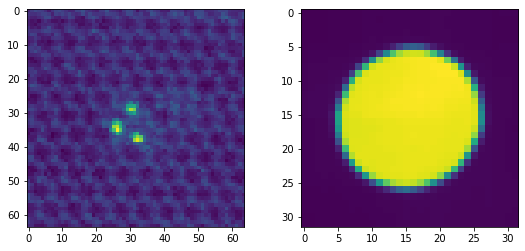

In [63]:
avg_cbed = np.mean(Data4D_norm,axis=(0,1))
fig,ax = plt.subplots(1,2,figsize=(9,4))
ax[0].imshow(normalize(img), vmax = 1)
ax[1].imshow(avg_cbed)

* Using <font color = 'crimson'>**center of mass shifts**</font> here as the search criteria!

The following are "<font color = 'crimson'>**ground truths**</font>" since we have already the entire 4D data set

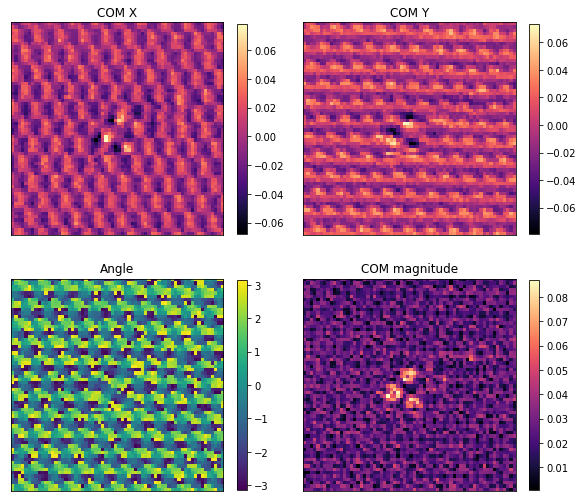

In [64]:
nyscan, nxscan, nopiy, nopix = Data4D_norm.shape

#deflection in pixels
du = 1.0
dv = 1.0
com_y, com_x, angle, com_mag_Orig = COM_full(nyscan, nxscan, nopiy,nopix,du,dv,Data4D)

gs = gridspec.GridSpec(2,2, wspace = 0.1, hspace = 0.1)
fig = plt.figure(figsize = (10,9))
ax00,ax01 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1])
ax10,ax11 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1])

ax00.set_title("COM X"),ax01.set_title("COM Y")
ax10.set_title("Angle"),ax11.set_title("COM magnitude")

im00 = ax00.imshow(com_x, cmap='magma')
im01 = ax01.imshow(com_y, cmap='magma')
im10 = ax10.imshow(angle, cmap = 'viridis')
im11 = ax11.imshow(com_mag_Orig, cmap = 'magma')

plt.colorbar(im00, ax=ax00, shrink = 0.9)
plt.colorbar(im01, ax=ax01, shrink = 0.9)
plt.colorbar(im10, ax=ax10, shrink = 0.9)
plt.colorbar(im11, ax=ax11, shrink = 0.9)
plt.setp([ax00,ax01,ax10,ax11],xticks=[],yticks=[]);

* Generate image patches for model training

((2809, 12, 12), (2809, 32, 32))

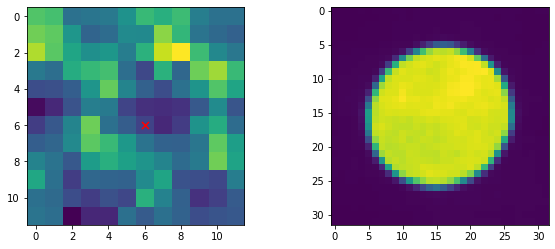

In [115]:
window_size       = 12 # 16      # select window size for geometric feature length scales
spectralavg       = 1            # average spectral channels

coordinates = aoi.utils.get_coord_grid(img, step = 1, return_dict=False)

img_patches, DPs, coords = aoi.utils.extract_patches_and_spectra(Data4D_norm, img, coordinates=coordinates, window_size=window_size, avg_pool = spectralavg)

testpx = 50

fig,ax=plt.subplots(1,2,figsize=(10,4))
ax[0].imshow(img_patches[testpx])
ax[1].imshow(DPs[testpx])
ax[0].scatter(window_size/2, window_size/2, marker = 'x', c='r', s=50)

img_patches.shape, DPs.shape

(0.0, 1.0, 0.0, 1.0)

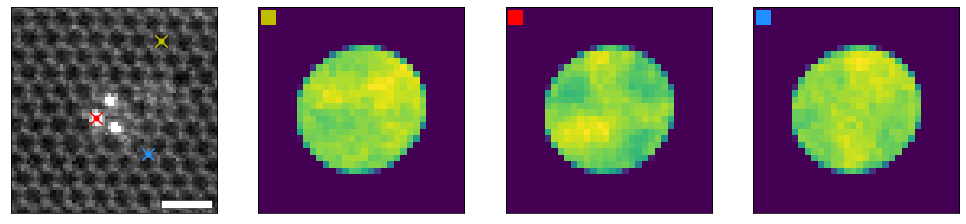

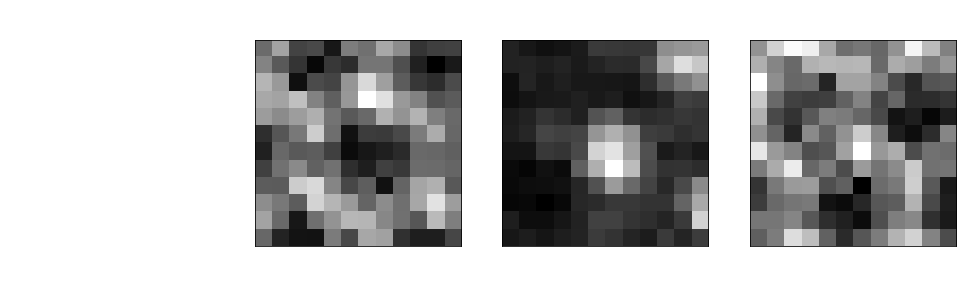

In [116]:
y1,x1 = 10, 46
y2,x2 = 34, 26
y3,x3 = 45, 42 

scalebar = 0.5

fig, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize=(17,5))

im1=ax1.imshow(normalize(img), cmap = 'gray', vmax=0.5)
im2=ax2.imshow(normalize(Data4D_norm[y1,x1]), vmin = 0.65, vmax = 1, cmap = 'viridis')
im2=ax3.imshow(normalize(Data4D_norm[y2,x2]), vmin = 0.65, vmax = 1, cmap = 'viridis')
im2=ax4.imshow(normalize(Data4D_norm[y3,x3]), vmin = 0.65, vmax = 1, cmap = 'viridis')

ax1.scatter(x1,y1,c='y',marker = 'x', s=150)
ax1.scatter(x2,y2,c='r',marker = 'x', s=150)
ax1.scatter(x3,y3,c='dodgerblue',marker = 'x', s=150)
ax1.scatter(x1,y1,c='y',marker = '.', s=100)
ax1.scatter(x2,y2,c='r',marker = '.', s=100)
ax1.scatter(x3,y3,c='dodgerblue',marker = '.', s=100)

plt.setp([ax1,ax2,ax3,ax4],xticks=[],yticks=[])

ax2.scatter(1,1,c='y',marker='s',s=200)
ax3.scatter(1,1,c='r',marker='s',s=200)
ax4.scatter(1,1,c='dodgerblue',marker='s',s=200)


length = scalebar/imscale
height = length / 7
xx,yy = img.shape
xfrac,yfrac = 0.72, 0.93

ax1.add_patch(patches.Rectangle((xfrac*xx, yfrac*yy), length, height, color = 'w', ec='k', lw=0.5))

sub1 = img[int(y1-(window_size/2)):int(y1+(window_size/2)), int(x1-(window_size/2)):int(x1+(window_size/2))]
sub2 = img[int(y2-(window_size/2)):int(y2+(window_size/2)), int(x2-(window_size/2)):int(x2+(window_size/2))]
sub3 = img[int(y3-(window_size/2)):int(y3+(window_size/2)), int(x3-(window_size/2)):int(x3+(window_size/2))]

fig, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize=(17,5))
ax2.imshow(normalize(sub1), vmax = 1, cmap = 'gray')
ax3.imshow(normalize(sub2), vmax = 1, cmap = 'gray')
ax4.imshow(normalize(sub3), vmax = 1, cmap = 'gray')

plt.setp([ax1,ax2,ax3,ax4],xticks=[],yticks=[])

ax1.axis('off')

In [117]:
com_xy_min = np.min([com_x, com_y])
com_xy_max = np.max([com_x, com_y])

com_xy_min, com_xy_max

(-0.07881365557576281, 0.0782797362096499)

[]

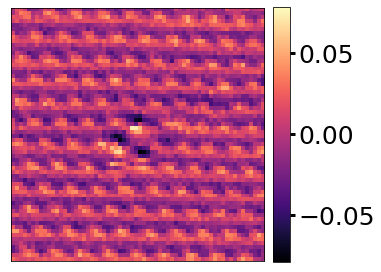

In [93]:
plt.figure(figsize=(5,5))
ax=plt.gca()
im1=ax.imshow(com_y, cmap = 'magma', vmin = com_xy_min, vmax = com_xy_max)

cbar = plt.colorbar(im1,ax=ax, fraction = 0.061, aspect = 15, pad = 0.03)
cbar.ax.tick_params(labelsize = 25, width = 3, length = 5)
plt.setp(ax,xticks=[],yticks=[])

[]

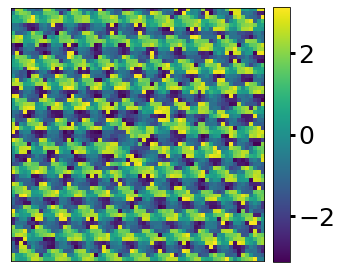

In [94]:
plt.figure(figsize=(5,5))
ax=plt.gca()
im1=ax.imshow(angle, cmap = 'viridis')


cbar = plt.colorbar(im1,ax=ax, fraction = 0.061, aspect = 15, pad = 0.03)
cbar.ax.tick_params(labelsize = 25, width = 3, length = 5)
plt.setp(ax,xticks=[],yticks=[])

[]

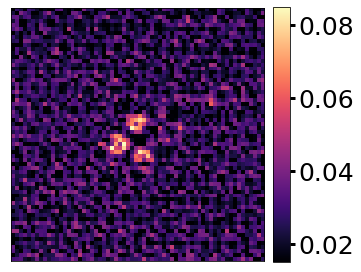

In [ ]:
plt.figure(figsize=(5,5))
ax=plt.gca()
# im1=ax.imshow(com_x, cmap = 'magma')
# im1=ax.imshow(com_y, cmap = 'magma')
# im1=ax.imshow(angle, cmap = 'magma')
im1=ax.imshow(com_mag_Orig, cmap = 'magma', vmin = 0.015, vmax = 0.085)

cbar = plt.colorbar(im1,ax=ax, fraction = 0.061, aspect = 15, pad = 0.03)
cbar.ax.tick_params(labelsize = 25, width = 3, length = 5)
plt.setp(ax,xticks=[],yticks=[])

In [118]:
full_img = np.copy(img)
indices = np.copy(coords)
features = np.copy(img_patches)
targets = np.copy(DPs)
scale = np.copy(imscale)

targets.shape, features.shape

((2809, 32, 32), (2809, 12, 12))

Preprocess:

In [119]:
norm_ = lambda x: (x - x.min()) / (x.max() - x.min())
features, targets = norm_(features), norm_(targets)

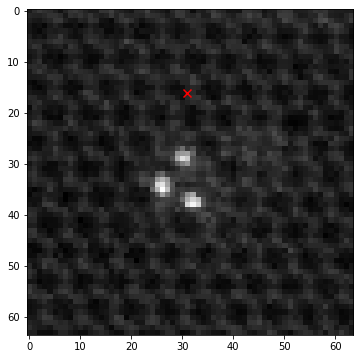

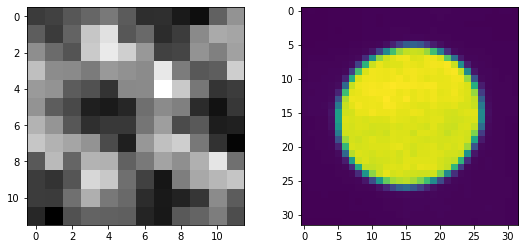

In [120]:
k = 555

plt.figure(figsize=(6, 6))
plt.imshow(normalize(full_img), vmax = 1, cmap='gray')
plt.scatter(indices[k,1], indices[k,0], marker='x', s=64, c= 'r')
_, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))
ax1.imshow(features[k], cmap='gray')
ax2.imshow(targets[k])  # here we disregard the actual x-axis values

* We need a REFERENCE CoM to determine the relative SHIFTS! 
* Here, we use the AVERAGE of all of CBEDs.
* For **real experiment**, we collect a vacuum CoM reference (we will have an array of 50x50x2, for example, which has CoM_x and CoM_y at every position in image space)

In [121]:
# initialize some global values likely needed:

nypix, nxpix = targets[0].shape
avgCOM = ndimage.center_of_mass(np.mean(targets,axis=0))

### CoM x

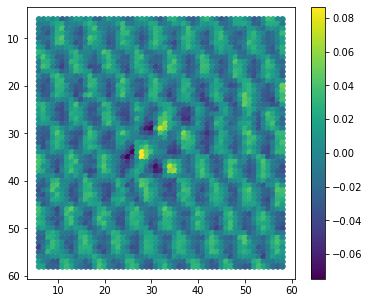

In [ ]:
physics_all, features_all, indices_all = scalarize4D("CoM x")

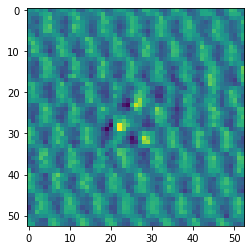

In [ ]:
groundtruth_comx = physics_all.reshape(f1-w1+1, f2-w2+1)
plt.imshow(groundtruth_comx)

Prepare data for training
* Select either `scalar` or `vector` DKL
* Note that vector DKL generally will require significantly more computational resources (i.e., better have the GPU enabled)

In [ ]:
dkl_mode = 'scalar'
# dkl_mode = 'vector' 

n, d1, d2 = features_all.shape
X = features_all.reshape(n, d1*d2)
if dkl_mode == 'scalar':
  y = physics_all
elif dkl_mode == 'vector':
  y = targets.reshape(len(targets),int(targets.shape[1]*targets.shape[2]))
X.shape, y.shape

((2809, 144), (2809,))

Train:

In [ ]:
data_dim = X.shape[-1]
dklgp_full_comx = None
dklgp_full_comx = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp_full_comx.fit(X, y.T, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1, random_state=42)

Epoch 1/100 ... Training loss: 0.7379
Epoch 10/100 ... Training loss: 0.7057
Epoch 20/100 ... Training loss: 0.6685
Epoch 30/100 ... Training loss: 0.63
Epoch 40/100 ... Training loss: 0.5906
Epoch 50/100 ... Training loss: 0.5502
Epoch 60/100 ... Training loss: 0.5086
Epoch 70/100 ... Training loss: 0.466
Epoch 80/100 ... Training loss: 0.4225
Epoch 90/100 ... Training loss: 0.378
Epoch 100/100 ... Training loss: 0.3325


Predict

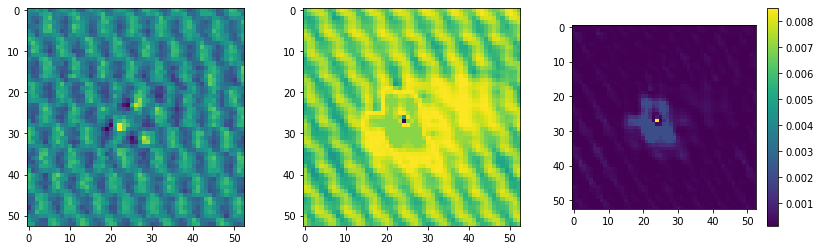

In [ ]:
mean_full_comx, var_full_comx = dklgp_full_comx.predict(X, batch_size = 512)
mean_full_comx, var_full_comx = mean_full_comx.T, var_full_comx.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_comx = mean_full_comx.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_comx = var_full_comx.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction_comx)
im3 = ax3.imshow(dkl_uncertainty_comx)
plt.colorbar(im3, ax=ax3)

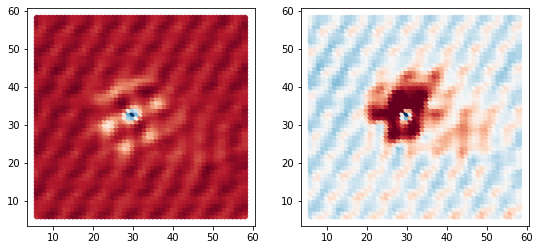

In [ ]:
embeded_full_comx = dklgp_full_comx.embed(X)
embeded_full_comx = embeded_full_comx / embeded_full_comx.max()

_, (ax1,ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded_full_comx[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded_full_comx[:, 1], cmap='RdBu')

* 10% data random sampling

In [ ]:
fraction = 0.1

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 240/2401 data points


In [ ]:
dklgp10 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp10.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 0.7605
Epoch 10/200 ... Training loss: 0.7186
Epoch 20/200 ... Training loss: 0.6807
Epoch 30/200 ... Training loss: 0.6419
Epoch 40/200 ... Training loss: 0.6025
Epoch 50/200 ... Training loss: 0.5614
Epoch 60/200 ... Training loss: 0.5189
Epoch 70/200 ... Training loss: 0.4756
Epoch 80/200 ... Training loss: 0.4314
Epoch 90/200 ... Training loss: 0.3864
Epoch 100/200 ... Training loss: 0.3407
Epoch 110/200 ... Training loss: 0.2956
Epoch 120/200 ... Training loss: 0.2472
Epoch 130/200 ... Training loss: 0.1992
Epoch 140/200 ... Training loss: 0.1505
Epoch 150/200 ... Training loss: 0.1013
Epoch 160/200 ... Training loss: 0.0515
Epoch 170/200 ... Training loss: 0.0012
Epoch 180/200 ... Training loss: -0.0495
Epoch 190/200 ... Training loss: -0.1005
Epoch 200/200 ... Training loss: -0.1519


Plot DKL-GPR prediction for a selected slice:

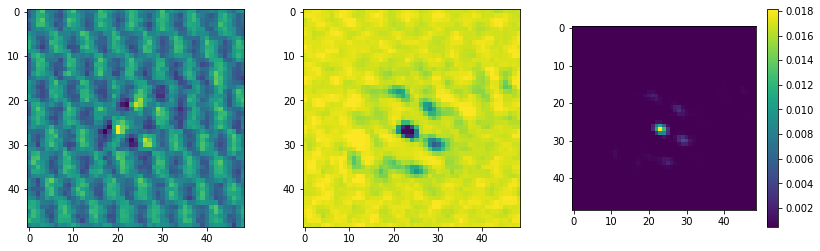

In [ ]:
mean10, var10 = dklgp10.predict(X, batch_size = 512)
mean10, var10 = mean10.T, var10.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction10 = mean10.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty10 = var10.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction10)
im3 = ax3.imshow(dkl_uncertainty10)
plt.colorbar(im3, ax=ax3)

### CoM y

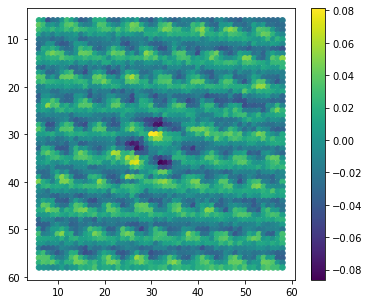

In [ ]:
physics_all, features_all, indices_all = scalarize4D("CoM y")

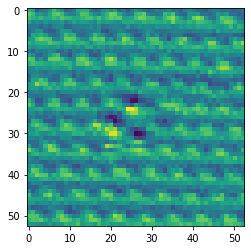

In [ ]:
groundtruth_comy = physics_all.reshape(f1-w1+1, f2-w2+1)
plt.imshow(groundtruth_comy)

Prepare data for training
* Select either `scalar` or `vector` DKL
* Note that vector DKL generally will require significantly more computational resources (i.e., better have the GPU enabled)

In [ ]:
dkl_mode = 'scalar'
# dkl_mode = 'vector' # 

n, d1, d2 = features_all.shape
X = features_all.reshape(n, d1*d2)
if dkl_mode == 'scalar':
  y = physics_all
elif dkl_mode == 'vector':
  y = targets.reshape(len(targets),int(targets.shape[1]*targets.shape[2]))
X.shape, y.shape

((2809, 144), (2809,))

Train:

In [ ]:
data_dim = X.shape[-1]
dklgp_full_comy = None
dklgp_full_comy = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp_full_comy.fit(X, y.T, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1, random_state = 42)

Epoch 1/100 ... Training loss: 0.738
Epoch 10/100 ... Training loss: 0.7059
Epoch 20/100 ... Training loss: 0.6685
Epoch 30/100 ... Training loss: 0.6302
Epoch 40/100 ... Training loss: 0.5908
Epoch 50/100 ... Training loss: 0.5503
Epoch 60/100 ... Training loss: 0.5088
Epoch 70/100 ... Training loss: 0.4662
Epoch 80/100 ... Training loss: 0.4226
Epoch 90/100 ... Training loss: 0.378
Epoch 100/100 ... Training loss: 0.3326


Predict

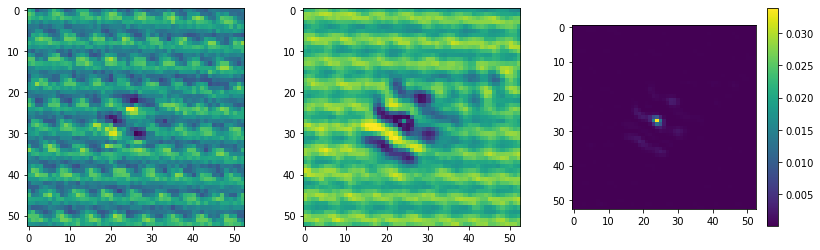

In [ ]:
mean_full_comy, var_full_comy = dklgp_full_comy.predict(X, batch_size = 512)
mean_full_comy, var_full_comy = mean_full_comy.T, var_full_comy.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_comy = mean_full_comy.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_comy = var_full_comy.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction_comy)
im3 = ax3.imshow(dkl_uncertainty_comy)
plt.colorbar(im3, ax=ax3)

In [ ]:
embeded_full_comy = dklgp_full_comy.embed(X)
embeded_full_comy = embeded_full_comy / embeded_full_comy.max()

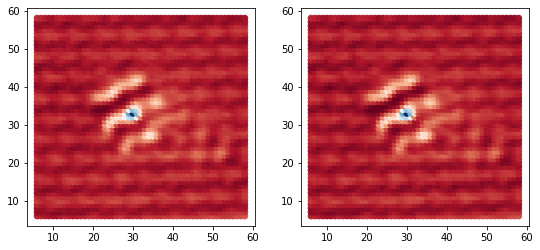

In [ ]:
_, (ax1,ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded_full_comy[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded_full_comy[:, 1], cmap='RdBu')

* 10% data random sampling

In [ ]:
fraction = 0.1

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 240/2401 data points


In [ ]:
dklgp10 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp10.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 0.7605
Epoch 10/200 ... Training loss: 0.7189
Epoch 20/200 ... Training loss: 0.6816
Epoch 30/200 ... Training loss: 0.6426
Epoch 40/200 ... Training loss: 0.6021
Epoch 50/200 ... Training loss: 0.5609
Epoch 60/200 ... Training loss: 0.5189
Epoch 70/200 ... Training loss: 0.4755
Epoch 80/200 ... Training loss: 0.4314
Epoch 90/200 ... Training loss: 0.3865
Epoch 100/200 ... Training loss: 0.3407
Epoch 110/200 ... Training loss: 0.2942
Epoch 120/200 ... Training loss: 0.2471
Epoch 130/200 ... Training loss: 0.199
Epoch 140/200 ... Training loss: 0.1505
Epoch 150/200 ... Training loss: 0.1013
Epoch 160/200 ... Training loss: 0.0515
Epoch 170/200 ... Training loss: 0.0012
Epoch 180/200 ... Training loss: -0.0491
Epoch 190/200 ... Training loss: -0.1001
Epoch 200/200 ... Training loss: -0.1517


Plot ground truth, DKL-GPR prediction and uncertainty:

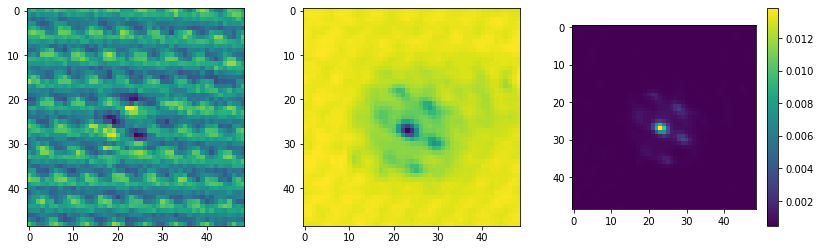

In [ ]:
mean10, var10 = dklgp10.predict(X, batch_size = 512)
mean10, var10 = mean10.T, var10.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction10 = mean10.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty10 = var10.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction10)
im3 = ax3.imshow(dkl_uncertainty10)
plt.colorbar(im3, ax=ax3)

### CoM angle (max radians)

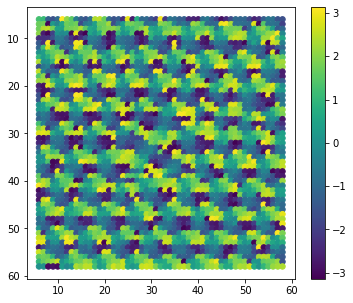

In [ ]:
physics_all, features_all, indices_all = scalarize4D("CoM angle")

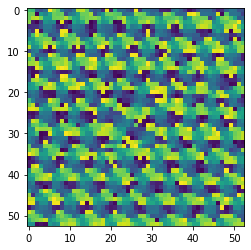

In [ ]:
groundtruth_comangle = physics_all.reshape(f1-w1+1, f2-w2+1)
plt.imshow(groundtruth_comangle)

Prepare data for training
* Select either `scalar` or `vector` DKL
* Note that vector DKL generally will require significantly more computational resources (i.e., better have the GPU enabled)

In [ ]:
dkl_mode = 'scalar'
# dkl_mode = 'vector' # 

n, d1, d2 = features_all.shape
X = features_all.reshape(n, d1*d2)
if dkl_mode == 'scalar':
  y = physics_all
elif dkl_mode == 'vector':
  y = targets.reshape(len(targets),int(targets.shape[1]*targets.shape[2]))
X.shape, y.shape

((2809, 144), (2809,))

Train:

In [ ]:
data_dim = X.shape[-1]
dklgp_full_angle = None
dklgp_full_angle = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp_full_angle.fit(X, y.T, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1, random_state = 42)

Epoch 1/100 ... Training loss: 3.0125
Epoch 10/100 ... Training loss: 1.815
Epoch 20/100 ... Training loss: 1.7206
Epoch 30/100 ... Training loss: 1.6529
Epoch 40/100 ... Training loss: 1.5858
Epoch 50/100 ... Training loss: 1.5157
Epoch 60/100 ... Training loss: 1.4708
Epoch 70/100 ... Training loss: 1.4384
Epoch 80/100 ... Training loss: 1.4036
Epoch 90/100 ... Training loss: 1.3854
Epoch 100/100 ... Training loss: 1.3093


Predict

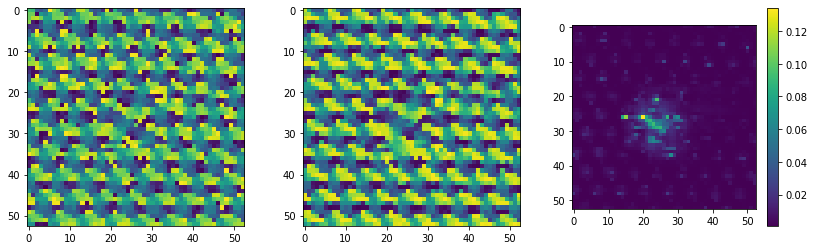

In [ ]:
mean_full_angle, var_full_angle = dklgp_full_angle.predict(X, batch_size = 512)
mean_full_angle, var_full_angle = mean_full_angle.T, var_full_angle.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_angle = mean_full_angle.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_angle = var_full_angle.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction_angle)
im3 = ax3.imshow(dkl_uncertainty_angle)
plt.colorbar(im3, ax=ax3)

Plot DKL-GPR average prediction & uncertainty, virtual ABF and virtual ADF reconstructions and ground truths

In [ ]:
embeded_full_angle = dklgp_full_angle.embed(X)
embeded_full_angle = embeded_full_angle / embeded_full_angle.max()

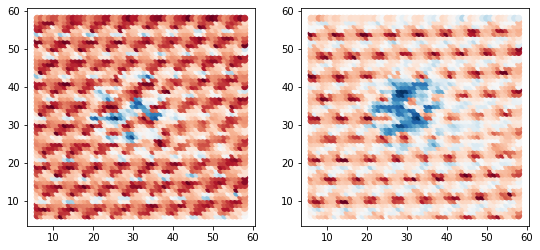

In [ ]:
_, (ax1,ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded_full_angle[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded_full_angle[:, 1], cmap='RdBu')

* 10% data random sampling

In [ ]:
fraction = 0.1

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 240/2401 data points


In [ ]:
dklgp10 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp10.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 2.9618
Epoch 10/200 ... Training loss: 1.6396
Epoch 20/200 ... Training loss: 1.3589
Epoch 30/200 ... Training loss: 1.1522
Epoch 40/200 ... Training loss: 1.0193
Epoch 50/200 ... Training loss: 0.9339
Epoch 60/200 ... Training loss: 0.881
Epoch 70/200 ... Training loss: 1.0411
Epoch 80/200 ... Training loss: 0.8914
Epoch 90/200 ... Training loss: 0.8056
Epoch 100/200 ... Training loss: 0.7351
Epoch 110/200 ... Training loss: 0.6888
Epoch 120/200 ... Training loss: 0.6634
Epoch 130/200 ... Training loss: 0.5934
Epoch 140/200 ... Training loss: 0.5378
Epoch 150/200 ... Training loss: 0.4861
Epoch 160/200 ... Training loss: 0.5768
Epoch 170/200 ... Training loss: 0.5019
Epoch 180/200 ... Training loss: 0.3963
Epoch 190/200 ... Training loss: 0.3238
Epoch 200/200 ... Training loss: 0.2589


Plot DKL-GPR prediction for a selected slice:

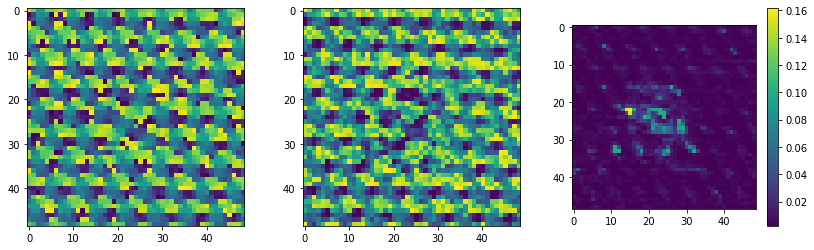

In [ ]:
mean10, var10 = dklgp10.predict(X, batch_size = 512)
mean10, var10 = mean10.T, var10.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction10 = mean10.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty10 = var10.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction10)
im3 = ax3.imshow(dkl_uncertainty10)
plt.colorbar(im3, ax=ax3)

### CoM magnitude

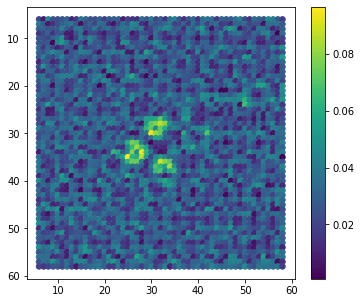

In [122]:
physics_all, features_all, indices_all = scalarize4D("CoM magnitude")

Prepare data for training
* Select either `scalar` or `vector` DKL
* Note that vector DKL generally will require significantly more computational resources (i.e., better have the GPU enabled)

In [123]:
dkl_mode = 'scalar'
# dkl_mode = 'vector' # 

n, d1, d2 = features_all.shape
X = features_all.reshape(n, d1*d2)
if dkl_mode == 'scalar':
  y = physics_all
elif dkl_mode == 'vector':
  y = targets.reshape(len(targets),int(targets.shape[1]*targets.shape[2]))
X.shape, y.shape

((2809, 144), (2809,))

Train:

In [124]:
data_dim = X.shape[-1]

dklgp_full = None
dklgp_full = aoi.models.dklGPR(data_dim, embedim=2, precision="double", random_state = 42)
dklgp_full.fit(X, y.T, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/100 ... Training loss: 0.7378
Epoch 10/100 ... Training loss: 0.7056
Epoch 20/100 ... Training loss: 0.6682
Epoch 30/100 ... Training loss: 0.6299
Epoch 40/100 ... Training loss: 0.5904
Epoch 50/100 ... Training loss: 0.5499
Epoch 60/100 ... Training loss: 0.5084
Epoch 70/100 ... Training loss: 0.4657
Epoch 80/100 ... Training loss: 0.4221
Epoch 90/100 ... Training loss: 0.3776
Epoch 100/100 ... Training loss: 0.3321


Predict

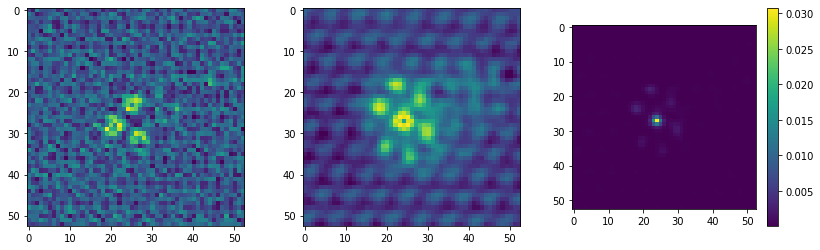

In [125]:
#  winsize = 12, 100 training cycles

mean_full, var_full = dklgp_full.predict(X, batch_size = 512)
mean_full, var_full = mean_full.T, var_full.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction = mean_full.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty = var_full.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction)
im3 = ax3.imshow(dkl_uncertainty)
plt.colorbar(im3, ax=ax3)

Plot DKL-GPR average prediction & uncertainty, virtual ABF and virtual ADF reconstructions and ground truths

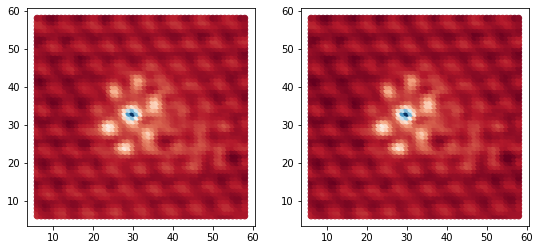

In [126]:
embeded_full = dklgp_full.embed(X)
embeded_full = embeded_full / embeded_full.max()

_, (ax1,ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded_full[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded_full[:, 1], cmap='RdBu')

* 10% data random sampling

In [127]:
fraction = 0.1

prng = RandomState(42) # 33
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 280/2809 data points


In [128]:
dklgp10 = None
dklgp10 = aoi.models.dklGPR(data_dim, embedim=2, precision="double", random_state = 42) # 42
dklgp10.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 0.7466
Epoch 10/200 ... Training loss: 0.7163
Epoch 20/200 ... Training loss: 0.6776
Epoch 30/200 ... Training loss: 0.6386
Epoch 40/200 ... Training loss: 0.5991
Epoch 50/200 ... Training loss: 0.5576
Epoch 60/200 ... Training loss: 0.5157
Epoch 70/200 ... Training loss: 0.473
Epoch 80/200 ... Training loss: 0.4292
Epoch 90/200 ... Training loss: 0.3845
Epoch 100/200 ... Training loss: 0.343
Epoch 110/200 ... Training loss: 0.2925
Epoch 120/200 ... Training loss: 0.2452
Epoch 130/200 ... Training loss: 0.1973
Epoch 140/200 ... Training loss: 0.1486
Epoch 150/200 ... Training loss: 0.0993
Epoch 160/200 ... Training loss: 0.0495
Epoch 170/200 ... Training loss: -0.0009
Epoch 180/200 ... Training loss: -0.0517
Epoch 190/200 ... Training loss: -0.1028
Epoch 200/200 ... Training loss: -0.1544


Plot DKL-GPR prediction for a selected slice:

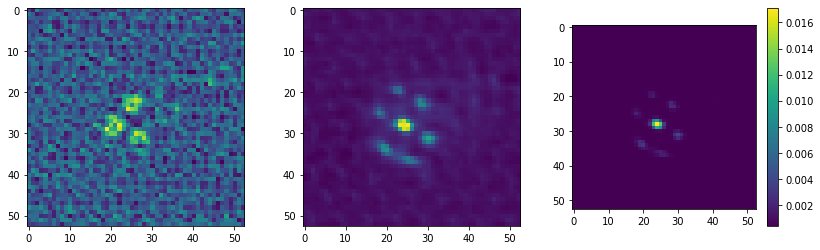

In [129]:
mean10, var10 = dklgp10.predict(X, batch_size = 512)
mean10, var10 = mean10.T, var10.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction10 = mean10.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty10 = var10.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction10)
im3 = ax3.imshow(dkl_uncertainty10)
plt.colorbar(im3, ax=ax3)

* 1% data random sampling

In [139]:
fraction = 0.01

prng = RandomState(42)  # 33
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 28/2809 data points


In [140]:
dklgp01 = None
dklgp01 = aoi.models.dklGPR(data_dim, embedim=2, precision="double", random_state = 42)
dklgp01.fit(X_train, y_train, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)   

Epoch 1/100 ... Training loss: 0.7914
Epoch 10/100 ... Training loss: 0.7761
Epoch 20/100 ... Training loss: 0.7286
Epoch 30/100 ... Training loss: 0.6862
Epoch 40/100 ... Training loss: 0.6441
Epoch 50/100 ... Training loss: 0.6011
Epoch 60/100 ... Training loss: 0.5578
Epoch 70/100 ... Training loss: 0.5131
Epoch 80/100 ... Training loss: 0.4677
Epoch 90/100 ... Training loss: 0.4214
Epoch 100/100 ... Training loss: 0.3743


Plot DKL-GPR prediction for a selected slice:

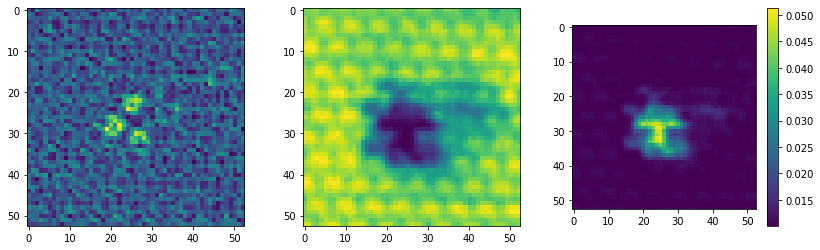

In [141]:
mean01, var01 = dklgp01.predict(X, batch_size = 512)
mean01, var01 = mean01.T, var01.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction01 = mean01.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty01 = var01.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction01)
im3 = ax3.imshow(dkl_uncertainty01)
plt.colorbar(im3, ax=ax3)

* 0.1% data random sampling

In [163]:
fraction = 0.001

prng = RandomState(40) # 33
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 2/2809 data points


In [164]:
dklgp001 = None
dklgp001 = aoi.models.dklGPR(data_dim, embedim=2, precision="double", random_state = 42)
dklgp001.fit(X_train, y_train, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)        # OG 100 training cycles

Epoch 1/100 ... Training loss: 0.9539
Epoch 10/100 ... Training loss: 0.9113
Epoch 20/100 ... Training loss: 0.8649
Epoch 30/100 ... Training loss: 0.8154
Epoch 40/100 ... Training loss: 0.7679
Epoch 50/100 ... Training loss: 0.7161
Epoch 60/100 ... Training loss: 0.6649
Epoch 70/100 ... Training loss: 0.6132
Epoch 80/100 ... Training loss: 0.5608
Epoch 90/100 ... Training loss: 0.5075
Epoch 100/100 ... Training loss: 0.4536


Plot DKL-GPR prediction for a selected slice:

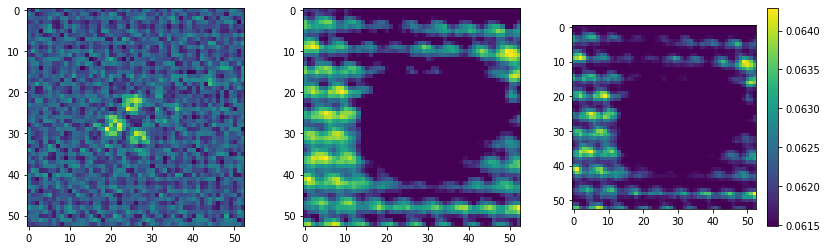

In [165]:
mean001, var001 = dklgp001.predict(X, batch_size = 512)
mean001, var001 = mean001.T, var001.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction001 = mean001.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty001 = var001.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction001)
im3 = ax3.imshow(dkl_uncertainty001)
plt.colorbar(im3, ax=ax3)

### ABF integrations

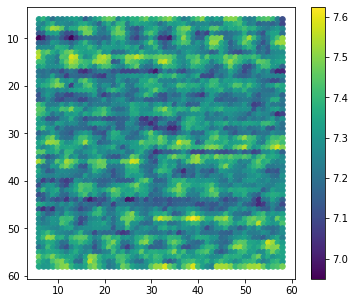

In [ ]:
physics_all, features_all, indices_all = scalarize4D('max annular', r_in = 1, r_out = 2)

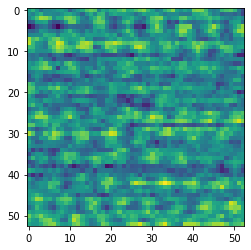

In [ ]:
groundtruth_maxabf = physics_all.reshape(f1-w1+1, f2-w2+1)
plt.imshow(groundtruth_maxabf)

Prepare data for training
* Select either `scalar` or `vector` DKL
* Note that vector DKL generally will require significantly more computational resources (i.e., better have the GPU enabled)

In [ ]:
dkl_mode = 'scalar'
# dkl_mode = 'vector' # 

n, d1, d2 = features_all.shape
X = features_all.reshape(n, d1*d2)
if dkl_mode == 'scalar':
  y = physics_all
elif dkl_mode == 'vector':
  y = targets.reshape(len(targets),int(targets.shape[1]*targets.shape[2]))
X.shape, y.shape

((2809, 144), (2809,))

Train:

In [ ]:
data_dim = X.shape[-1]
dklgp_full_ABF = None
dklgp_full_ABF = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp_full_ABF.fit(X, y.T, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1, random_state = 42)

Epoch 1/100 ... Training loss: 0.7654
Epoch 10/100 ... Training loss: 0.7392
Epoch 20/100 ... Training loss: 0.699
Epoch 30/100 ... Training loss: 0.6572
Epoch 40/100 ... Training loss: 0.6149
Epoch 50/100 ... Training loss: 0.5749
Epoch 60/100 ... Training loss: 0.5313
Epoch 70/100 ... Training loss: 0.4884
Epoch 80/100 ... Training loss: 0.4439
Epoch 90/100 ... Training loss: 0.3991
Epoch 100/100 ... Training loss: 0.3537


Predict

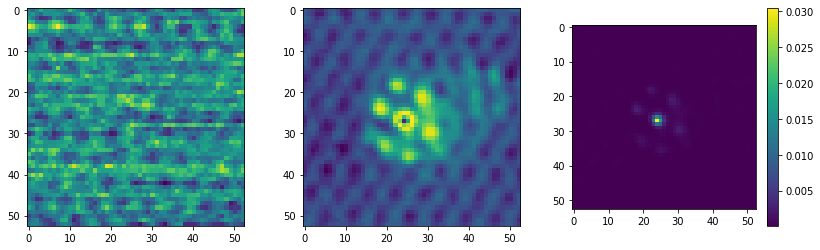

In [ ]:
## min ABF
mean_full_ABF, var_full_ABF = dklgp_full_ABF.predict(X, batch_size = 512)
mean_full_ABF, var_full_ABF = mean_full_ABF.T, var_full_ABF.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_ABF = mean_full_ABF.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_ABF = var_full_ABF.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction_ABF)
im3 = ax3.imshow(dkl_uncertainty_ABF)
plt.colorbar(im3, ax=ax3)

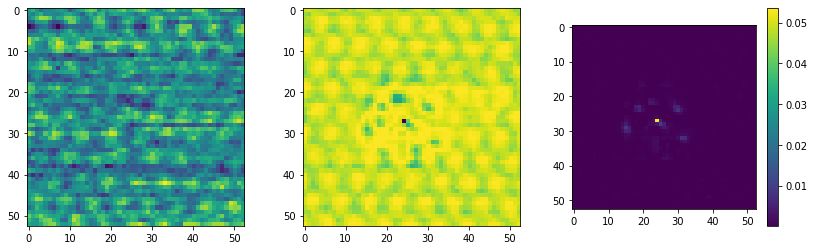

In [ ]:
## max ABF <-- works nicely

mean_full_ABF, var_full_ABF = dklgp_full_ABF.predict(X, batch_size = 512)
mean_full_ABF, var_full_ABF = mean_full_ABF.T, var_full_ABF.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_ABF = mean_full_ABF.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_ABF = var_full_ABF.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction_ABF)
im3 = ax3.imshow(dkl_uncertainty_ABF)
plt.colorbar(im3, ax=ax3)

Plot DKL-GPR average prediction & uncertainty, virtual ABF and virtual ADF reconstructions and ground truths

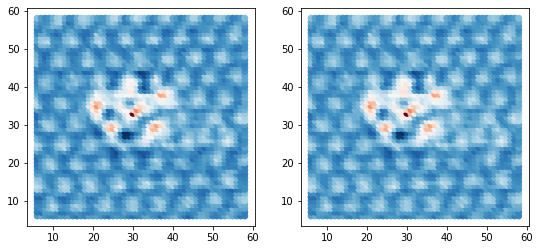

In [ ]:
embeded_full_ABF = dklgp_full_ABF.embed(X)
embeded_full_ABF = embeded_full_ABF / embeded_full_ABF.max()

_, (ax1,ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded_full_ABF[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded_full_ABF[:, 1], cmap='RdBu')

#### figure: DKL reconstruction

With the full data prediction

In [166]:
unc_min = np.min([dkl_uncertainty,dkl_uncertainty10,dkl_uncertainty01,dkl_uncertainty001])
unc_max = np.max([dkl_uncertainty,dkl_uncertainty10,dkl_uncertainty01,dkl_uncertainty001])

unc_min, unc_max

(0.00011087977311183272, 0.06428672083110723)

[]

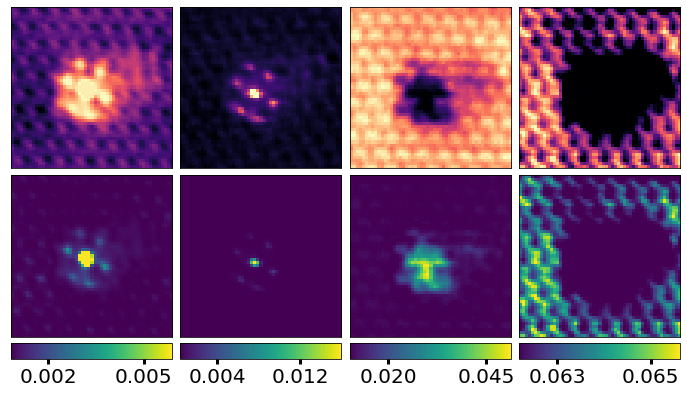

In [ ]:
colormap = 'magma'

plt.figure(figsize=(12,6.5))
gs = gridspec.GridSpec(3,4, height_ratios=[1,1,0.1], wspace = 0.05, hspace = 0.05)

ax00,ax01,ax02,ax03 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1]), plt.subplot(gs[0,2]), plt.subplot(gs[0,3])
ax10,ax11,ax12,ax13 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2]), plt.subplot(gs[1,3])
ax20,ax21,ax22,ax23 = plt.subplot(gs[2,0]), plt.subplot(gs[2,1]), plt.subplot(gs[2,2]), plt.subplot(gs[2,3])

im00 = ax00.imshow(normalize(dkl_prediction), cmap = colormap)
im11 = ax01.imshow(normalize(dkl_prediction10), cmap = colormap, vmax = 0.75)
ax02.imshow(normalize(dkl_prediction01), cmap = colormap)
ax03.imshow(normalize(dkl_prediction001), cmap = colormap)

im10 = ax10.imshow(dkl_uncertainty)
im11 = ax11.imshow(dkl_uncertainty10)
im12 = ax12.imshow(dkl_uncertainty01)
im13 = ax13.imshow(dkl_uncertainty001)

cbar20 = plt.colorbar(im10,ax=ax20, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal', format = '%.3f')
cbar21 = plt.colorbar(im11,ax=ax21, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal', format = '%.3f')
cbar22 = plt.colorbar(im12,ax=ax22, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal', format = '%.3f')
cbar23 = plt.colorbar(im13,ax=ax23, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal', format = '%.3f')

cbar20.ax.tick_params(labelsize = 20, width = 3, length = 5)
cbar21.ax.tick_params(labelsize = 20, width = 3, length = 5)
cbar22.ax.tick_params(labelsize = 20, width = 3, length = 5)
cbar23.ax.tick_params(labelsize = 20, width = 3, length = 5)

cbar20.ax.get_xaxis().set_ticks([0.0015, 0.005])
cbar21.ax.get_xaxis().set_ticks([0.004, 0.012])
cbar22.ax.get_xaxis().set_ticks([0.02, 0.045])
cbar23.ax.get_xaxis().set_ticks([0.063, 0.065])

# cbar20.ax.get_xaxis().set_ticks([0.0015, 0.025])
# cbar21.ax.get_xaxis().set_ticks([0.004, 0.012])
# cbar22.ax.get_xaxis().set_ticks([0.02, 0.045])
# cbar23.ax.get_xaxis().set_ticks([0.062, 0.064])

ax20.axis('off'), ax21.axis('off'), ax22.axis('off'), ax23.axis('off')
axes = [ax00,ax01,ax02,ax03,ax10,ax11,ax12,ax13,ax20,ax21,ax22,ax23]
plt.setp(axes,xticks=[],yticks=[])

#### figure: cost scalarizers
* Comparison of predictions/uncertainty between `com_x`, `com_y`, `com_angle`, and `max_ABF`

[]

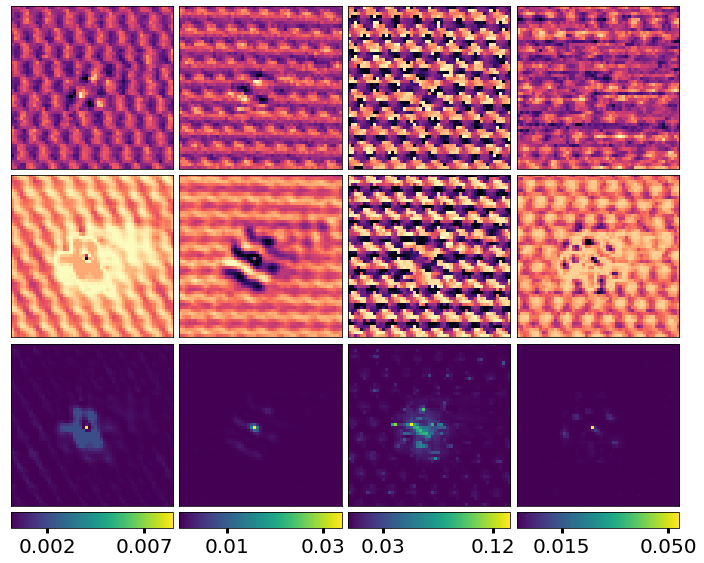

In [ ]:
colormap = 'magma'

plt.figure(figsize=(12,9.6))
gs = gridspec.GridSpec(4,4, height_ratios=[1,1,1,0.1], wspace = 0.03, hspace = 0.05)

ax00,ax01,ax02,ax03 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1]), plt.subplot(gs[0,2]), plt.subplot(gs[0,3])
ax10,ax11,ax12,ax13 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2]), plt.subplot(gs[1,3])
ax20,ax21,ax22,ax23 = plt.subplot(gs[2,0]), plt.subplot(gs[2,1]), plt.subplot(gs[2,2]), plt.subplot(gs[2,3])
ax30,ax31,ax32,ax33 = plt.subplot(gs[3,0]), plt.subplot(gs[3,1]), plt.subplot(gs[3,2]), plt.subplot(gs[3,3])

ax00.imshow(groundtruth_comx, cmap = colormap)
ax01.imshow(groundtruth_comy, cmap = colormap)
ax02.imshow(groundtruth_comangle, cmap = colormap)
ax03.imshow(groundtruth_maxabf, cmap = colormap)

im10 = ax10.imshow(dkl_prediction_comx, cmap = colormap)
im11 = ax11.imshow(dkl_prediction_comy, cmap = colormap)
im12 = ax12.imshow(dkl_prediction_angle, cmap = colormap)
im13 = ax13.imshow(dkl_prediction_ABF, cmap = colormap, vmax = 7.4, vmin = 7)

im20 = ax20.imshow(dkl_uncertainty_comx)
im21 = ax21.imshow(dkl_uncertainty_comy)
im22 = ax22.imshow(dkl_uncertainty_angle)
im23 = ax23.imshow(dkl_uncertainty_ABF)

cbar30 = plt.colorbar(im20,ax=ax30, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal')
cbar31 = plt.colorbar(im21,ax=ax31, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal')
cbar32 = plt.colorbar(im22,ax=ax32, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal')
cbar33 = plt.colorbar(im23,ax=ax33, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal')

cbar30.ax.tick_params(labelsize = 20, width = 3, length = 5)
cbar31.ax.tick_params(labelsize = 20, width = 3, length = 5)
cbar32.ax.tick_params(labelsize = 20, width = 3, length = 5)
cbar33.ax.tick_params(labelsize = 20, width = 3, length = 5)

cbar30.ax.get_xaxis().set_ticks([0.002, 0.007])
cbar31.ax.get_xaxis().set_ticks([0.01, 0.03])
cbar32.ax.get_xaxis().set_ticks([0.03, 0.12])
cbar33.ax.get_xaxis().set_ticks([0.015, 0.05])


ax30.axis('off'), ax31.axis('off'), ax32.axis('off'), ax33.axis('off')
axes = [ax00,ax01,ax02,ax03,ax10,ax11,ax12,ax13,ax20,ax21,ax22,ax23]
plt.setp(axes,xticks=[],yticks=[])

# Active learning (Trimer)
* Using CoM magnitude

* This is where physics is embedded into the model!
* We need to define a function that will scalarize our vector-valued acquisition function. Here, we compute the (magnitude of the) center of mass shift (this has already been done, i.e., our 2D diffraction patterns are now a single quantity - CoM magnitude)

We start with a small number (2) of randomly sampled measurements and use DKL-GPR predictions to guide the sample exploration via pre-defined acquisition functions:

* Active learning

We start with a small number (2) of randomly sampled measurements and use DKL-GPR predictions to guide the sample exploration via pre-defined acquisition functions:

In [177]:
# Here X_train and y_train are our measured image patches (HAADF) and spectra/peaks (EELS),
# whereas X_test and y_test are the "unknown" ones. The indices_train are grid coordinates of the measured points,
# whereas the indices_test are the grid coordinates of the remaining available points on the grid

(X_train, X_test, y_train, y_test,
 indices_train, indices_test) = train_test_split(
     X, y, indices, test_size=0.999, shuffle=True, random_state=20)

# The targets for the DKL-GPR must have vector_size x n_samples dimensions where vector_size is equal to spectral length
y_train = y_train.T
y_test = y_test.T

print(X_train.shape) # n_samples x n_features
print(y_train.shape) # vector_size x n_samples 

(2, 144)
(2,)


1/50
Epoch 1/20 ... Training loss: 0.9538
Epoch 10/20 ... Training loss: 0.9113
Epoch 20/20 ... Training loss: 0.8637


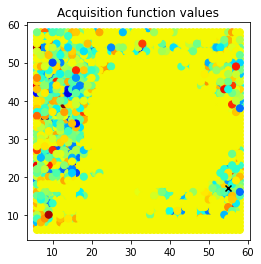

2/50
Epoch 1/20 ... Training loss: 0.9242
Epoch 10/20 ... Training loss: 0.8861
Epoch 20/20 ... Training loss: 0.8387


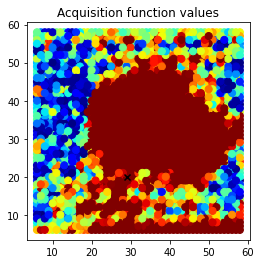

3/50
Epoch 1/20 ... Training loss: 0.9027
Epoch 10/20 ... Training loss: 0.8636
Epoch 20/20 ... Training loss: 0.8196


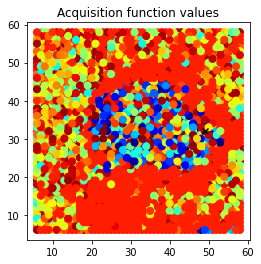

4/50
Epoch 1/20 ... Training loss: 0.8865
Epoch 10/20 ... Training loss: 0.8487
Epoch 20/20 ... Training loss: 0.805


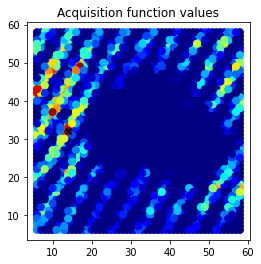

5/50
Epoch 1/20 ... Training loss: 0.8735
Epoch 10/20 ... Training loss: 0.8455
Epoch 20/20 ... Training loss: 0.7945


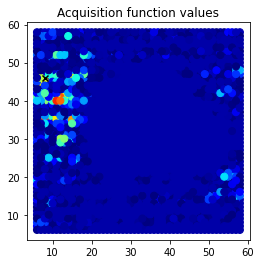

6/50
Epoch 1/20 ... Training loss: 0.8637
Epoch 10/20 ... Training loss: 0.828
Epoch 20/20 ... Training loss: 0.7848


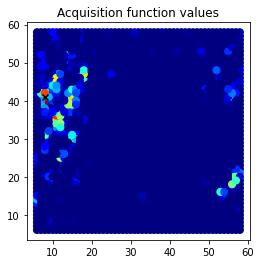

7/50
Epoch 1/20 ... Training loss: 0.8548
Epoch 10/20 ... Training loss: 0.8212
Epoch 20/20 ... Training loss: 0.7778


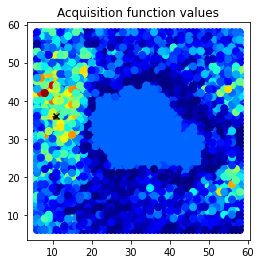

8/50
Epoch 1/20 ... Training loss: 0.8473
Epoch 10/20 ... Training loss: 0.8138
Epoch 20/20 ... Training loss: 0.7695


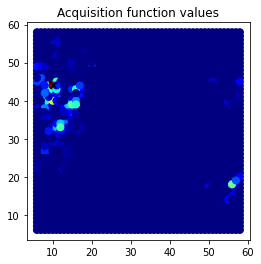

9/50
Epoch 1/20 ... Training loss: 0.8409
Epoch 10/20 ... Training loss: 0.8062
Epoch 20/20 ... Training loss: 0.7655


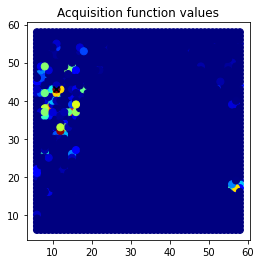

10/50
Epoch 1/20 ... Training loss: 0.8353
Epoch 10/20 ... Training loss: 0.8022
Epoch 20/20 ... Training loss: 0.7601


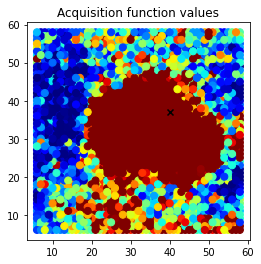

11/50
Epoch 1/20 ... Training loss: 0.8303
Epoch 10/20 ... Training loss: 0.8006
Epoch 20/20 ... Training loss: 0.7544


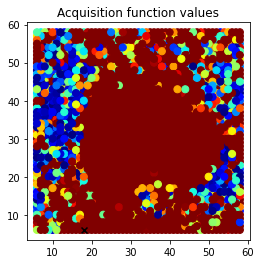

12/50
Epoch 1/20 ... Training loss: 0.8258
Epoch 10/20 ... Training loss: 0.797
Epoch 20/20 ... Training loss: 0.7569


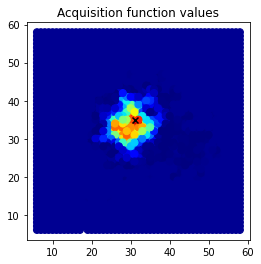

13/50
Epoch 1/20 ... Training loss: 0.8228
Epoch 10/20 ... Training loss: 0.8026
Epoch 20/20 ... Training loss: 0.7605


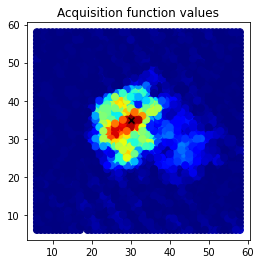

14/50
Epoch 1/20 ... Training loss: 0.8198
Epoch 10/20 ... Training loss: 0.8024
Epoch 20/20 ... Training loss: 0.7596


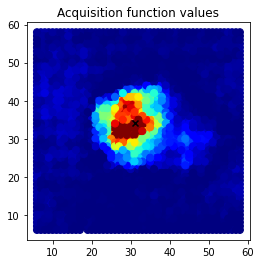

15/50
Epoch 1/20 ... Training loss: 0.8166
Epoch 10/20 ... Training loss: 0.8053
Epoch 20/20 ... Training loss: 0.76


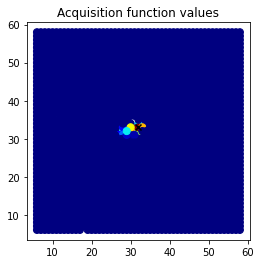

16/50
Epoch 1/20 ... Training loss: 0.8136
Epoch 10/20 ... Training loss: 0.8068
Epoch 20/20 ... Training loss: 0.7582


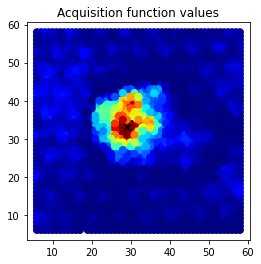

17/50
Epoch 1/20 ... Training loss: 0.8108
Epoch 10/20 ... Training loss: 0.8015
Epoch 20/20 ... Training loss: 0.7616


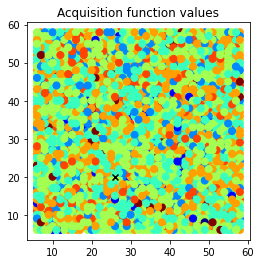

18/50
Epoch 1/20 ... Training loss: 0.8083
Epoch 10/20 ... Training loss: 0.7989
Epoch 20/20 ... Training loss: 0.7597


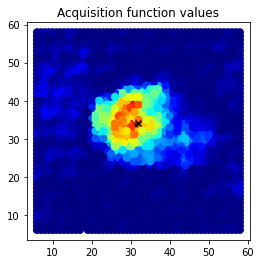

19/50
Epoch 1/20 ... Training loss: 0.8063
Epoch 10/20 ... Training loss: 0.7937
Epoch 20/20 ... Training loss: 0.7576


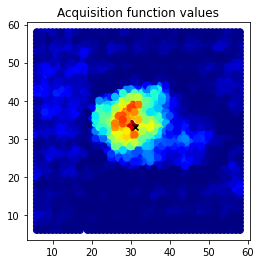

20/50
Epoch 1/20 ... Training loss: 0.8041
Epoch 10/20 ... Training loss: 0.7915
Epoch 20/20 ... Training loss: 0.7522


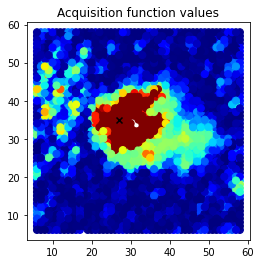

21/50
Epoch 1/20 ... Training loss: 0.8032
Epoch 10/20 ... Training loss: 0.7954
Epoch 20/20 ... Training loss: 0.7473


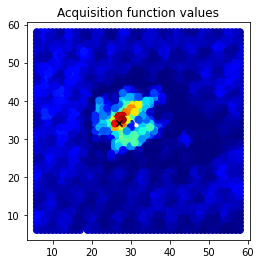

22/50
Epoch 1/20 ... Training loss: 0.8019
Epoch 10/20 ... Training loss: 0.787
Epoch 20/20 ... Training loss: 0.7524


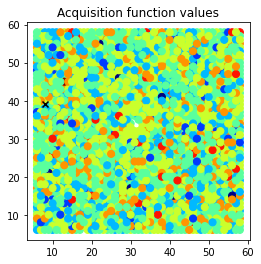

23/50
Epoch 1/20 ... Training loss: 0.8
Epoch 10/20 ... Training loss: 0.7845
Epoch 20/20 ... Training loss: 0.7478


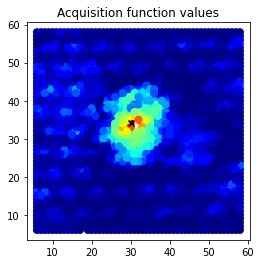

24/50
Epoch 1/20 ... Training loss: 0.7983
Epoch 10/20 ... Training loss: 0.783
Epoch 20/20 ... Training loss: 0.7476


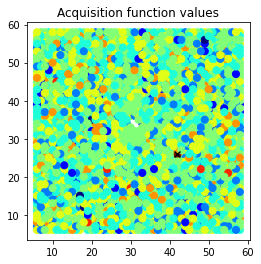

25/50
Epoch 1/20 ... Training loss: 0.7966
Epoch 10/20 ... Training loss: 0.7806
Epoch 20/20 ... Training loss: 0.7341


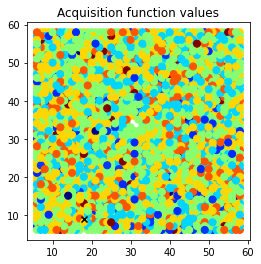

26/50
Epoch 1/20 ... Training loss: 0.7951
Epoch 10/20 ... Training loss: 0.7836
Epoch 20/20 ... Training loss: 0.7427


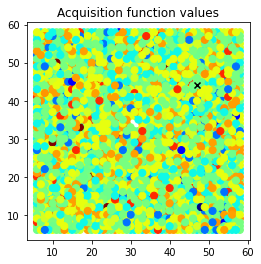

27/50
Epoch 1/20 ... Training loss: 0.7936
Epoch 10/20 ... Training loss: 0.783
Epoch 20/20 ... Training loss: 0.7427


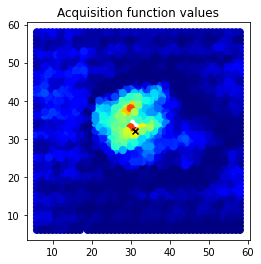

28/50
Epoch 1/20 ... Training loss: 0.7923
Epoch 10/20 ... Training loss: 0.7768
Epoch 20/20 ... Training loss: 0.7408


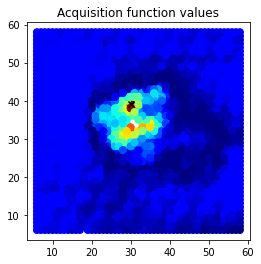

29/50
Epoch 1/20 ... Training loss: 0.7913
Epoch 10/20 ... Training loss: 0.7846
Epoch 20/20 ... Training loss: 0.7419


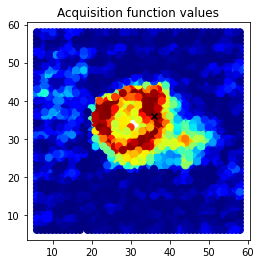

30/50
Epoch 1/20 ... Training loss: 0.7901
Epoch 10/20 ... Training loss: 0.7744
Epoch 20/20 ... Training loss: 0.7372


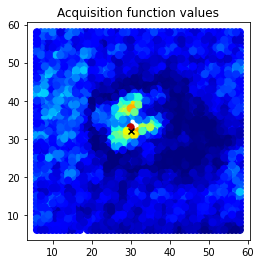

31/50
Epoch 1/20 ... Training loss: 0.7891
Epoch 10/20 ... Training loss: 0.775
Epoch 20/20 ... Training loss: 0.7364


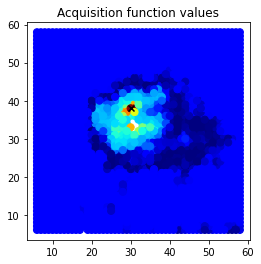

32/50
Epoch 1/20 ... Training loss: 0.7883
Epoch 10/20 ... Training loss: 0.7733
Epoch 20/20 ... Training loss: 0.7353


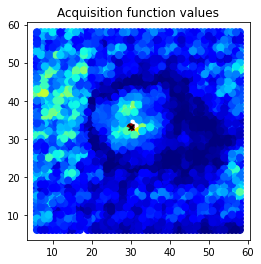

33/50
Epoch 1/20 ... Training loss: 0.7873
Epoch 10/20 ... Training loss: 0.7766
Epoch 20/20 ... Training loss: 0.7326


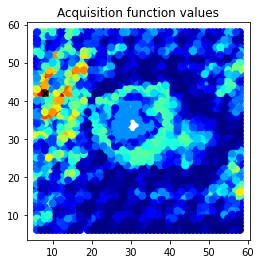

34/50
Epoch 1/20 ... Training loss: 0.7862
Epoch 10/20 ... Training loss: 0.7693
Epoch 20/20 ... Training loss: 0.7285


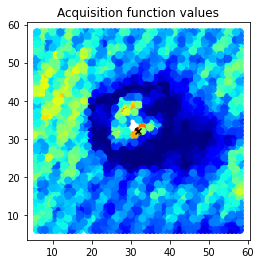

35/50
Epoch 1/20 ... Training loss: 0.7853
Epoch 10/20 ... Training loss: 0.774
Epoch 20/20 ... Training loss: 0.7317


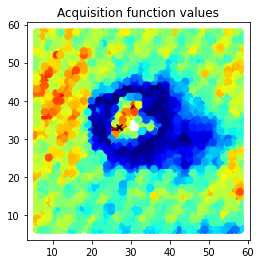

36/50
Epoch 1/20 ... Training loss: 0.7846
Epoch 10/20 ... Training loss: 0.7705
Epoch 20/20 ... Training loss: 0.7289


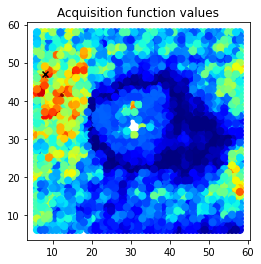

37/50
Epoch 1/20 ... Training loss: 0.7836
Epoch 10/20 ... Training loss: 0.7703
Epoch 20/20 ... Training loss: 0.7322


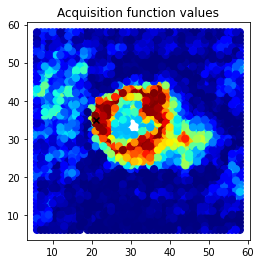

38/50
Epoch 1/20 ... Training loss: 0.7828
Epoch 10/20 ... Training loss: 0.7659
Epoch 20/20 ... Training loss: 0.725


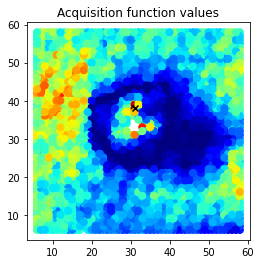

39/50
Epoch 1/20 ... Training loss: 0.782
Epoch 10/20 ... Training loss: 0.77
Epoch 20/20 ... Training loss: 0.7312


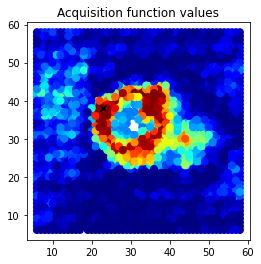

40/50
Epoch 1/20 ... Training loss: 0.7813
Epoch 10/20 ... Training loss: 0.7687
Epoch 20/20 ... Training loss: 0.7255


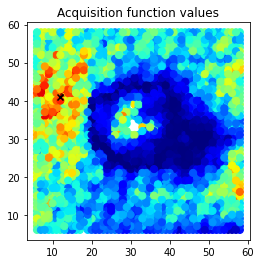

41/50
Epoch 1/20 ... Training loss: 0.7805
Epoch 10/20 ... Training loss: 0.7645
Epoch 20/20 ... Training loss: 0.7248


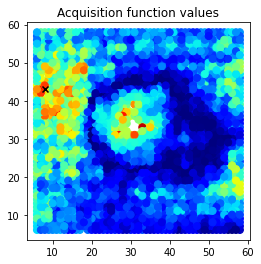

42/50
Epoch 1/20 ... Training loss: 0.7797
Epoch 10/20 ... Training loss: 0.7652
Epoch 20/20 ... Training loss: 0.7236


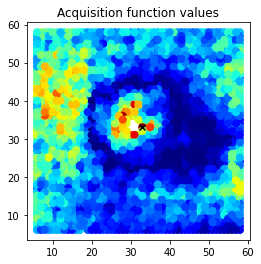

43/50
Epoch 1/20 ... Training loss: 0.7791
Epoch 10/20 ... Training loss: 0.766
Epoch 20/20 ... Training loss: 0.724


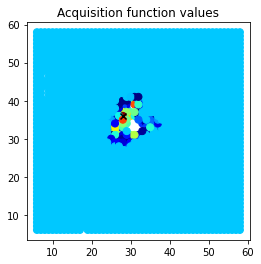

44/50
Epoch 1/20 ... Training loss: 0.7785
Epoch 10/20 ... Training loss: 0.7612
Epoch 20/20 ... Training loss: 0.7235


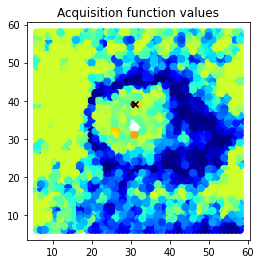

45/50
Epoch 1/20 ... Training loss: 0.7779
Epoch 10/20 ... Training loss: 0.7599
Epoch 20/20 ... Training loss: 0.7235


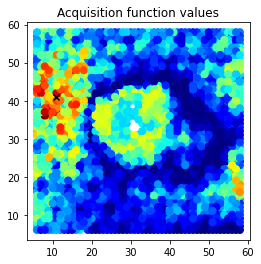

46/50
Epoch 1/20 ... Training loss: 0.7772
Epoch 10/20 ... Training loss: 0.7589
Epoch 20/20 ... Training loss: 0.7222


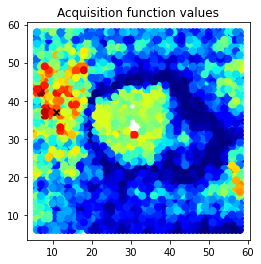

47/50
Epoch 1/20 ... Training loss: 0.7766
Epoch 10/20 ... Training loss: 0.7583
Epoch 20/20 ... Training loss: 0.7206


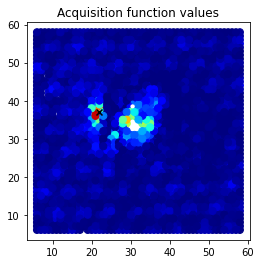

48/50
Epoch 1/20 ... Training loss: 0.7761
Epoch 10/20 ... Training loss: 0.7573
Epoch 20/20 ... Training loss: 0.7207


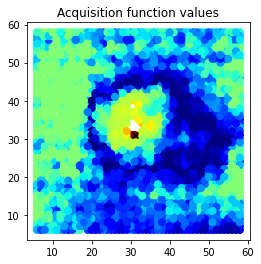

49/50
Epoch 1/20 ... Training loss: 0.7756
Epoch 10/20 ... Training loss: 0.757
Epoch 20/20 ... Training loss: 0.72


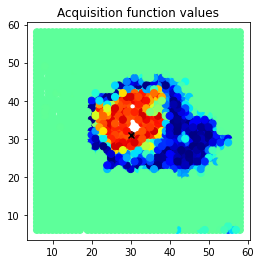

50/50
Epoch 1/20 ... Training loss: 0.7752
Epoch 10/20 ... Training loss: 0.7614
Epoch 20/20 ... Training loss: 0.721


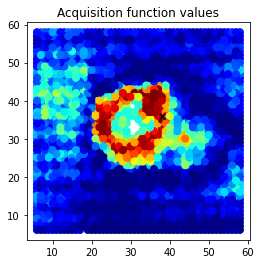

In [178]:
exploration_steps = 50  # 

xi = 0.01                # balances exploration and exploitation for EI

################################################################################
import time  # NEW LINE
time_all = []  # NEW LINE

AF_results = []
data_dim = X_train.shape[-1]
for e in range(exploration_steps):
    print("{}/{}".format(e+1, exploration_steps))
    start_time = time.time()  # NEW LINE
    training_iter = 20 if e < 100 else 40  # we do not want to "overfit" our model at the beginning

    # update GP posterior
    dklgp_new = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
    dklgp_new.fit(X_train, y_train, training_cycles=training_iter,lr = 1e-2,CUDA_LAUNCH_BLOCKING=1)

    # Compute the acquisition function
    best_f = torch.tensor(dklgp_new.predict(X_train)[0].max())
    obj = EI(dklgp_new, X_test, best_f, xi)

    # SAVE current acquisition function
    AF = save_result(indices_test, obj)
    AF_results.append(AF)
  
    obj = obj.T # transpose to n_samples x vector_size  for consistency

    # Scalarize the acquisition function
    # obj = scalarize_acq(obj, scalar = 'CoM x')  # Not necessary for scalar DKL (BUT YES necessary for microscope)

    # Select the next point to "measure"
    next_point_idx = obj.argmax()
    next_point = indices_test[next_point_idx]

    # Do "measurement"
    measured_point = y_test[next_point_idx]

    # Plot current result
    plot_result(indices_test, obj, e)

    # SAVE current MODEL WEIGHTS
    state_dict = dklgp_new.gp_model.state_dict()
    torch.save(state_dict, "Model_ActiveDKL {}.pt".format(e))

    # Append to the arrays of measured points
    X_train = np.append(X_train, X_test[next_point_idx][None], 0)
    X_test = np.delete(X_test, next_point_idx, 0)
    # y_train = np.append(y_train, measured_point[:,None], 1)
    y_train = np.append(y_train, measured_point)
    # y_test = np.delete(y_test, next_point_idx, 1)
    y_test = np.delete(y_test, next_point_idx)
    indices_train = np.append(indices_train, next_point[None], 0)
    indices_test = np.delete(indices_test, next_point_idx, 0)
    time_all.append(time.time() - start_time)  # NEW LINE

Plot the visited points:

Overlay the explored point with a ground truth (again, we only will have a ground truth for *pre*-acquired data):

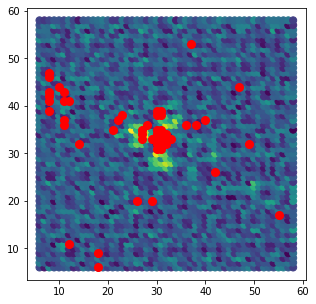

In [179]:
plt.figure(figsize=(5, 5))
plt.scatter(indices[:, 1], indices[:, 0], s=50, c=y)
plt.scatter(indices_train[:, 1], indices_train[:, 0], s=64, c='r')

In [ ]:
try:
    os.rename("Model_ActiveDKL 0.pt", "Model_ActiveDKL 00.pt")
    os.rename("Model_ActiveDKL 1.pt", "Model_ActiveDKL 01.pt")
    os.rename("Model_ActiveDKL 2.pt", "Model_ActiveDKL 02.pt")
    os.rename("Model_ActiveDKL 3.pt", "Model_ActiveDKL 03.pt")
    os.rename("Model_ActiveDKL 4.pt", "Model_ActiveDKL 04.pt")
    os.rename("Model_ActiveDKL 5.pt", "Model_ActiveDKL 05.pt")
    os.rename("Model_ActiveDKL 6.pt", "Model_ActiveDKL 06.pt")
    os.rename("Model_ActiveDKL 7.pt", "Model_ActiveDKL 07.pt")
    os.rename("Model_ActiveDKL 8.pt", "Model_ActiveDKL 08.pt")
    os.rename("Model_ActiveDKL 9.pt", "Model_ActiveDKL 09.pt")
except FileNotFoundError:
  pass

model_files = sorted(glob.glob("Model_*.pt"))

* AF movies / reconstructions

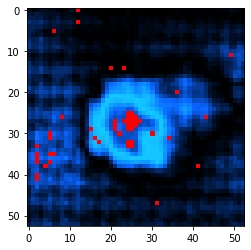

In [181]:
structural_img = np.copy(full_img)
AF_all, AF_all_color_combo, AF_combined = Make_AF_movies_preacquired(acquisition_functions = AF_results,
                                                                     RGB = Blue,
                                                                     brightness = 2,
                                                                     measured_points_in_AF = [1,0,0],
                                                                     measured_points_in_HAADF = [1,0,0])

plt.imshow(AF_all_color_combo[-1])

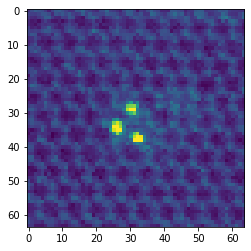

In [182]:
cutoff_int = 0.75
testim = np.copy(normalize(full_img))
testim[np.where(testim>cutoff_int)] = cutoff_int
plt.imshow(testim)

In [183]:
size_increase = 4
imgformov = testim

HAADF_mov = create_point_search_mov_preacquired(imgformov, AF_combined, size = structural_img.shape, point_radius = 1, point_color = [1,0,0], offset = 0)
AF_resized = resize(AF_all_color_combo, HAADF_mov.shape)
Movie_combined = np.concatenate((AF_resized, HAADF_mov), axis = 2)

s1,s2,s3,s4 =  Movie_combined.shape
Movie_combined_upscaled = resize(Movie_combined, (s1,s2*size_increase,s3*size_increase,s4))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:354: FutureWarning: `draw.circle` is deprecated in favor of `draw.disk`.`draw.circle` will be removed in version 0.19


* View the A.F. at the last step:

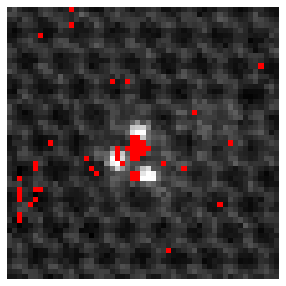

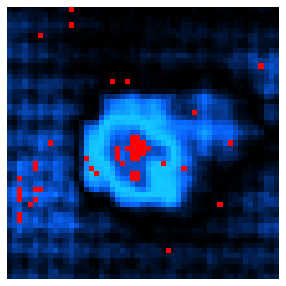

In [184]:
step = -1

plt.figure(figsize=(9,5))
ax=plt.gca()
ax.imshow(HAADF_mov[step])
# ax.scatter(53,65,marker = 'x', color='y', s=100)
ax.axis('off')

plt.figure(figsize=(9,5))
ax=plt.gca()
ax.imshow(AF_resized[step])
ax.axis('off');

* Create a movie

In [185]:
Mov_name = "AcquisitionFunction_mov8.mp4"

imageio.mimwrite(Mov_name, Movie_combined_upscaled, fps = 4)
Video(Mov_name, embed = True)

* Load and evaluate model performance at specific fractions of measured data points

In [186]:
weights_files = []
weights_files = sorted(glob.glob('*.pt'))
len(weights_files)

50

* Use model at this step.... (note, later cells use a function to accomplish the following two cells)

In [187]:
step = -1  # model step from which to load weights

#####################################
### do not change below parameters ###
#####################################

weights = weights_files[step]
device = 'cpu'            # constant  (cpu or cuda)
dtype = torch.float64     # constant

dklgp_trained =  aoi.models.dklGPR(data_dim, embedim=2, precision="double", device = device)
dklgp_trained.compile_trainer(X, y.T) # extra step. 

# Load trained weights
state_dict = torch.load(weights)
dklgp_trained.gp_model.load_state_dict(state_dict)

<All keys matched successfully>

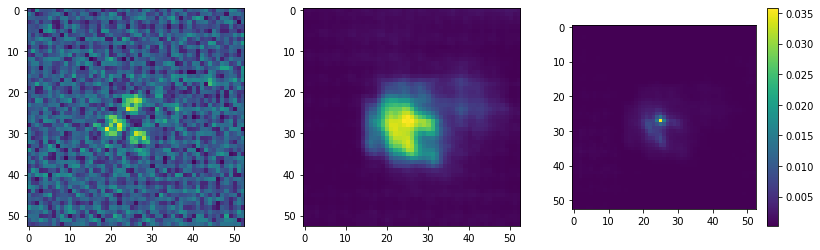

In [188]:
mean_active, var_active = dklgp_trained.predict(X, batch_size = 512)  # 10 min @ batchsize 512.... gross! That's for ONE step prediction!
mean_active, var_active = mean_active.T, var_active.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_active = mean_active.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_active = var_active.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction_active)
im3 = ax3.imshow(dkl_uncertainty_active)
plt.colorbar(im3, ax=ax3)

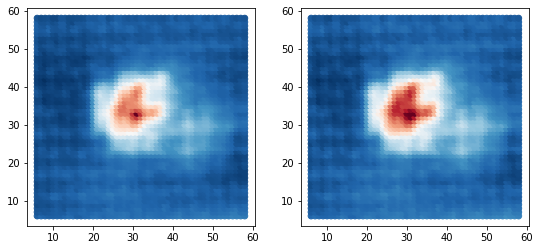

In [189]:
embeded = dklgp_trained.embed(X)
embeded = embeded / embeded.max()

_, (ax1, ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded[:, 1], cmap='RdBu')

In [190]:
Pred_stack_mag, Unc_stack_mag = get_all_DKL_predictions_preacquired_4D(model_files, testim, num_cycles = 40, embed = 2, precision = "double")

/usr/local/lib/python3.7/dist-packages/gpytorch/distributions/multivariate_normal.py:263: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-10.
  NumericalWarning,
/usr/local/lib/python3.7/dist-packages/gpytorch/distributions/multivariate_normal.py:263: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-10.
  NumericalWarning,
/usr/local/lib/python3.7/dist-packages/gpytorch/distributions/multivariate_normal.py:263: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-10.
  NumericalWarning,
/usr/local/lib/python3.7/dist-packages/gpytorch/distributions/multivariate_normal.py:263: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-10.
  NumericalWarni

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:431: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:354: FutureWarning: `draw.circle` is deprecated in favor of `draw.disk`.`draw.circle` will be removed in version 0.19


[]

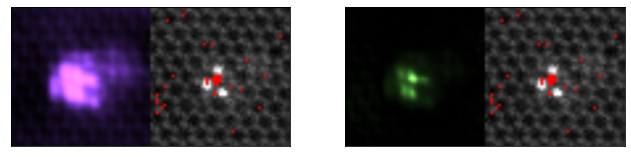

In [194]:
_,_,AF_HAADF, Pred_mov, Unc_mov = Make_pred_movies_preacquired(Pred_stack_mag, Unc_stack_mag, testim,
                                            Pred_color = [60/100,30/100,100/100], 
                                            Unc_color = [40/100,80/100,30/100], 
                                            Brightness = 2, 
                                            measured_points_in_HAADF = [1,0,0], 
                                            size_increase = 4,
                                            point_rad = 1)

kk = 35

plt.figure(figsize=(11,5))
gs = gridspec.GridSpec(1,2)
ax1, ax2  = plt.subplot(gs[0,0]), plt.subplot(gs[0,1])

# ax1.imshow(AF_HAADF[kk])
ax1.imshow(Pred_mov[kk])
ax2.imshow(Unc_mov[kk])

plt.setp([ax1,ax2],xticks=[],yticks=[])

In [195]:
imageio.mimwrite('Mov_Graphene_pred_DPC04.mp4', Pred_mov, fps = 4)
Video('Mov_Graphene_pred_DPC04.mp4', embed = True)

In [196]:
imageio.mimwrite('Mov_Graphene_unc_DPC04.mp4', Unc_mov, fps = 4)
Video('Mov_Graphene_unc_DPC04.mp4', embed = True)

# TBG

In [7]:
Data4D = np.load("TBG-defects_4D.npy", allow_pickle=True)
img = np.load("TBG-defects_image.npy")
imscale = json.load(open("TBG-defects_image.json", "r"))['spatial_calibrations'][0]['scale']

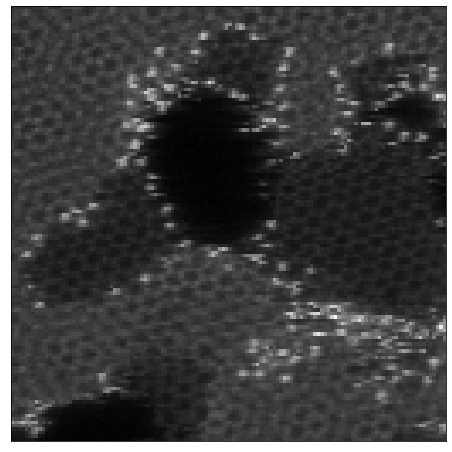

In [8]:
plt.figure(figsize=(8,8))
ax = plt.gca()
ax.imshow(img, cmap = 'gray')
plt.setp(ax,xticks=[],yticks=[])

f1,f2 = img.shape[0], img.shape[1]

In [9]:
Data4D_norm = normalize(Data4D)

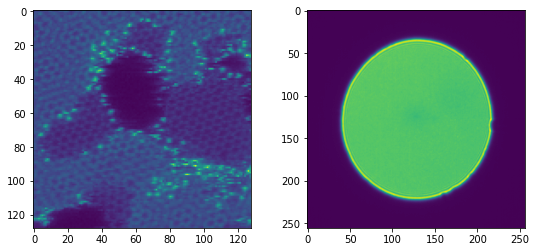

In [10]:
avg_cbed = np.mean(Data4D_norm,axis=(0,1))
fig,ax = plt.subplots(1,2,figsize=(9,4))
ax[0].imshow(normalize(img), vmax = 1)
ax[1].imshow(avg_cbed)

In [11]:
print(Data4D_norm.shape)
# Data4D = None

(128, 128, 256, 256)


* Using center of mass shifts here as the search criteria!

The following are "<font color = 'crimson'>**ground truths**</font>" since we have already the entire 4D data set

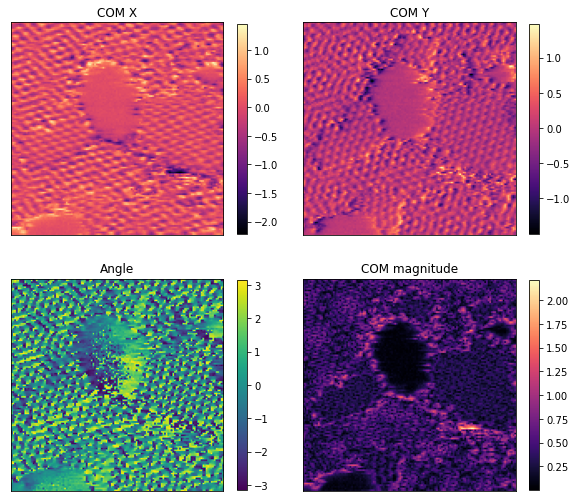

In [12]:
nyscan, nxscan, nopiy, nopix = Data4D_norm.shape

#deflection in pixels
du = 1.0
dv = 1.0
com_y, com_x, angle, com_mag_Orig = COM_full(nyscan, nxscan, nopiy,nopix,du,dv,Data4D)

gs = gridspec.GridSpec(2,2, wspace = 0.1, hspace = 0.1)
fig = plt.figure(figsize = (10,9))
ax00,ax01 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1])
ax10,ax11 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1])

ax00.set_title("COM X"),ax01.set_title("COM Y")
ax10.set_title("Angle"),ax11.set_title("COM magnitude")

im00 = ax00.imshow(com_x, cmap='magma')
im01 = ax01.imshow(com_y, cmap='magma')
im10 = ax10.imshow(angle, cmap = 'viridis')
im11 = ax11.imshow(com_mag_Orig, cmap = 'magma')

plt.colorbar(im00, ax=ax00, shrink = 0.9)
plt.colorbar(im01, ax=ax01, shrink = 0.9)
plt.colorbar(im10, ax=ax10, shrink = 0.9)
plt.colorbar(im11, ax=ax11, shrink = 0.9)
plt.setp([ax00,ax01,ax10,ax11],xticks=[],yticks=[]);

* Generate image patches for model training

/usr/local/lib/python3.7/dist-packages/atomai/utils/img.py:450: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:201.)
  spectra = torch.tensor(spectra).unsqueeze(1)


((13689, 12, 12), (13689, 256, 256))

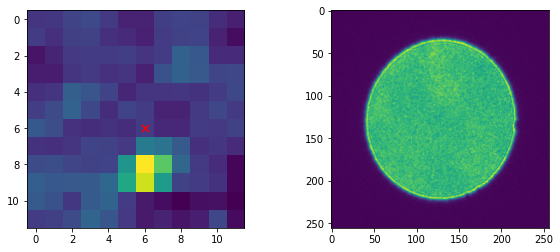

In [13]:
window_size       = 12 # select window size for geometric feature length scales
w1,w2 = window_size, window_size

coordinates = aoi.utils.get_coord_grid(img, step = 1, return_dict=False)

img_patches, DPs, coords = aoi.utils.extract_patches_and_spectra(Data4D_norm, img, coordinates=coordinates, window_size=window_size, avg_pool = 1)

testpx = 50

fig,ax=plt.subplots(1,2,figsize=(10,4))
ax[0].imshow(img_patches[testpx])
ax[1].imshow(DPs[testpx])
ax[0].scatter(window_size/2, window_size/2, marker = 'x', c='r', s=50)

img_patches.shape, DPs.shape

(0.0, 1.0, 0.0, 1.0)

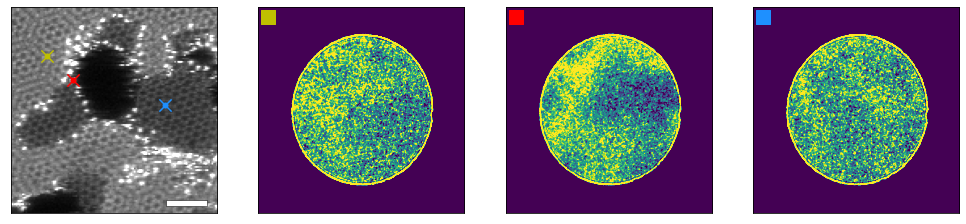

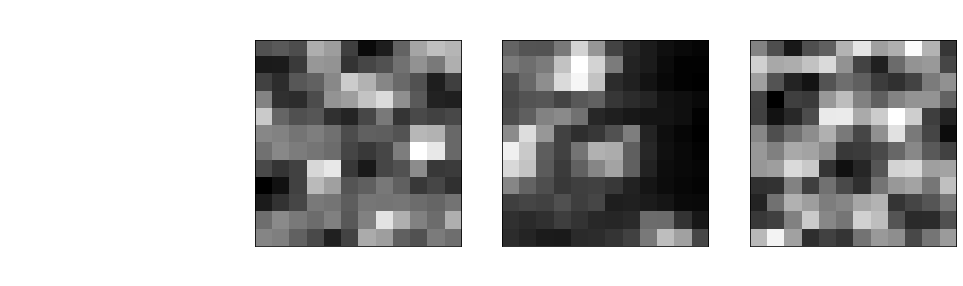

In [14]:
y1,x1 = 30, 22
y2,x2 = 45, 38
y3,x3 = 60, 95 

scalebar = 2

fig, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize=(17,5))

im1=ax1.imshow(normalize(img), cmap = 'gray', vmax=0.5)
im2=ax2.imshow(normalize(Data4D_norm[y1,x1]), vmin = 0.6, vmax = 0.73, cmap = 'viridis')
im2=ax3.imshow(normalize(Data4D_norm[y2,x2]), vmin = 0.55, vmax = 0.7, cmap = 'viridis')
im2=ax4.imshow(normalize(Data4D_norm[y3,x3]), vmin = 0.6, vmax = 0.73, cmap = 'viridis')

ax1.scatter(x1,y1,c='y',marker = 'x', s=150)
ax1.scatter(x2,y2,c='r',marker = 'x', s=150)
ax1.scatter(x3,y3,c='dodgerblue',marker = 'x', s=150)
ax1.scatter(x1,y1,c='y',marker = '.', s=100)
ax1.scatter(x2,y2,c='r',marker = '.', s=100)
ax1.scatter(x3,y3,c='dodgerblue',marker = '.', s=100)

plt.setp([ax1,ax2,ax3,ax4],xticks=[],yticks=[])

ax2.scatter(12,12,c='y',marker='s',s=200)
ax3.scatter(12,12,c='r',marker='s',s=200)
ax4.scatter(12,12,c='dodgerblue',marker='s',s=200)


length = scalebar/imscale
height = length / 7
xx,yy = img.shape
xfrac,yfrac = 0.75, 0.93

ax1.add_patch(patches.Rectangle((xfrac*xx, yfrac*yy), length, height, color = 'w', ec='k', lw=0.5))

sub1 = img[int(y1-(window_size/2)):int(y1+(window_size/2)), int(x1-(window_size/2)):int(x1+(window_size/2))]
sub2 = img[int(y2-(window_size/2)):int(y2+(window_size/2)), int(x2-(window_size/2)):int(x2+(window_size/2))]
sub3 = img[int(y3-(window_size/2)):int(y3+(window_size/2)), int(x3-(window_size/2)):int(x3+(window_size/2))]

fig, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize=(17,5))

ax2.imshow(normalize(sub1), vmax = 1, cmap = 'gray')
ax3.imshow(normalize(sub2), vmax = 1, cmap = 'gray')
ax4.imshow(normalize(sub3), vmax = 1, cmap = 'gray')

plt.setp([ax1,ax2,ax3,ax4],xticks=[],yticks=[])
ax1.axis('off')

In [15]:
com_xy_min = np.min([com_x, com_y])
com_xy_max = np.max([com_x, com_y])

com_xy_min, com_xy_max

(-2.206563478754404, 1.4780495097456594)

[]

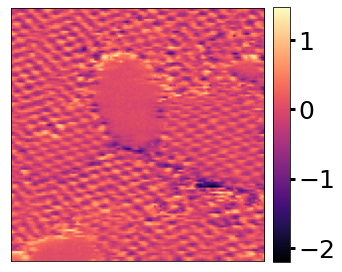

In [16]:
plt.figure(figsize=(5,5))
ax=plt.gca()
im1=ax.imshow(com_x, cmap = 'magma', vmin = com_xy_min, vmax = com_xy_max)
# im1=ax.imshow(com_y, cmap = 'magma_r', vmin = com_xy_min, vmax = com_xy_max)


cbar = plt.colorbar(im1,ax=ax, fraction = 0.061, aspect = 15, pad = 0.03)
cbar.ax.tick_params(labelsize = 25, width = 3, length = 5)
plt.setp(ax,xticks=[],yticks=[])

[]

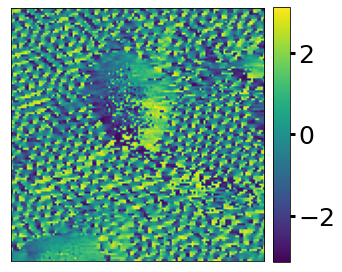

In [17]:
plt.figure(figsize=(5,5))
ax=plt.gca()
im1=ax.imshow(angle, cmap = 'viridis')


cbar = plt.colorbar(im1,ax=ax, fraction = 0.061, aspect = 15, pad = 0.03)
cbar.ax.tick_params(labelsize = 25, width = 3, length = 5)
plt.setp(ax,xticks=[],yticks=[])

[]

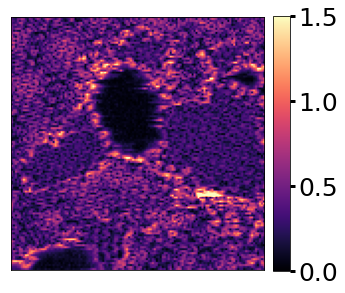

In [ ]:
plt.figure(figsize=(5,5))
ax=plt.gca()
# im1=ax.imshow(com_x, cmap = 'magma')
# im1=ax.imshow(com_y, cmap = 'magma')
# im1=ax.imshow(angle, cmap = 'magma')
im1=ax.imshow(com_mag_Orig, cmap = 'magma', vmax = 1.5, vmin = 0)

cbar = plt.colorbar(im1,ax=ax, fraction = 0.061, aspect = 15, pad = 0.03)
cbar.ax.tick_params(labelsize = 25, width = 3, length = 5)
plt.setp(ax,xticks=[],yticks=[])

In [18]:
full_img = np.copy(img)
indices = np.copy(coords)
features = np.copy(img_patches)
targets = np.copy(DPs)
scale = np.copy(imscale)

targets.shape, features.shape

((13689, 256, 256), (13689, 12, 12))

Preprocess:

In [19]:
norm_ = lambda x: (x - x.min()) / (x.max() - x.min())
features, targets = norm_(features), norm_(targets)

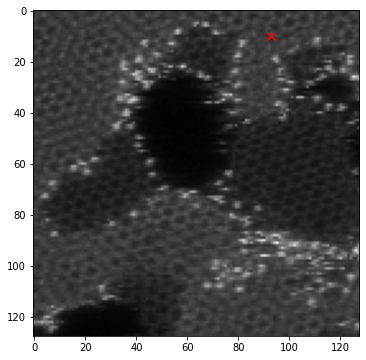

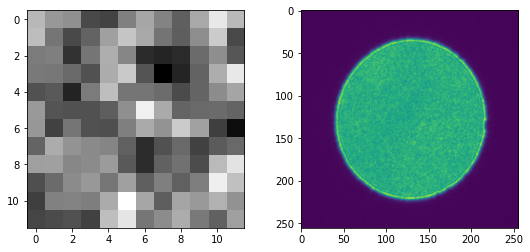

In [20]:
k = 555

plt.figure(figsize=(6, 6))
plt.imshow(normalize(full_img), vmax = 1, cmap='gray')
plt.scatter(indices[k,1], indices[k,0], marker='x', s=64, c= 'r')
_, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))
ax1.imshow(features[k], cmap='gray')
ax2.imshow(targets[k])  # here we disregard the actual x-axis values

* We need a REFERENCE CoM to determine the relative SHIFTS! 
* Here, we use the AVERAGE of all of CBEDs.
* For **real experiment**, we collect a vacuum CoM reference

In [21]:
# initialize some global values likely needed:

nypix, nxpix = targets[0].shape
avgCOM = ndimage.center_of_mass(np.mean(targets,axis=0))

### CoM x

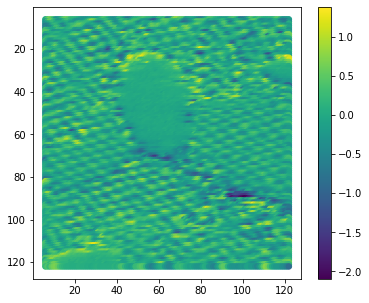

In [ ]:
physics_all, features_all, indices_all = scalarize4D("CoM x")

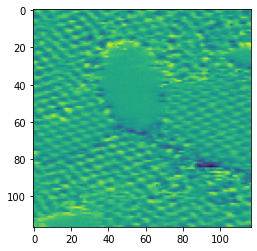

In [ ]:
groundtruth_comx = physics_all.reshape(f1-w1+1, f2-w2+1)
plt.imshow(groundtruth_comx)

Prepare data for training
* Select either `scalar` or `vector` DKL
* Note that vector DKL generally will require significantly more computational resources (i.e., better have the GPU enabled)

In [ ]:
dkl_mode = 'scalar'
# dkl_mode = 'vector' # 

n, d1, d2 = features_all.shape
X = features_all.reshape(n, d1*d2)
if dkl_mode == 'scalar':
  y = physics_all
elif dkl_mode == 'vector':
  y = targets.reshape(len(targets),int(targets.shape[1]*targets.shape[2]))
X.shape, y.shape

((13689, 144), (13689,))

Train:

In [ ]:
data_dim = X.shape[-1]
dklgp_full_comx = None
dklgp_full_comx = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp_full_comx.fit(X, y.T, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1, random_state=42)

Epoch 1/100 ... Training loss: 0.8167
Epoch 10/100 ... Training loss: 0.7552
Epoch 20/100 ... Training loss: 0.7193
Epoch 30/100 ... Training loss: 0.6828
Epoch 40/100 ... Training loss: 0.6449
Epoch 50/100 ... Training loss: 0.6074
Epoch 60/100 ... Training loss: 0.5683
Epoch 70/100 ... Training loss: 0.527
Epoch 80/100 ... Training loss: 0.4895
Epoch 90/100 ... Training loss: 0.4442
Epoch 100/100 ... Training loss: 0.4047


Predict

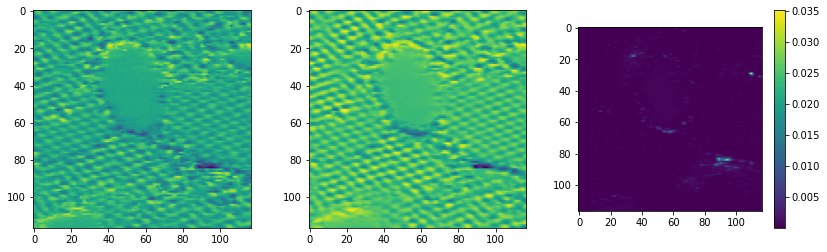

In [ ]:
mean_full_comx, var_full_comx = dklgp_full_comx.predict(X, batch_size = 512)
mean_full_comx, var_full_comx = mean_full_comx.T, var_full_comx.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_comx = mean_full_comx.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_comx = var_full_comx.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction_comx)
im3 = ax3.imshow(dkl_uncertainty_comx)
plt.colorbar(im3, ax=ax3)

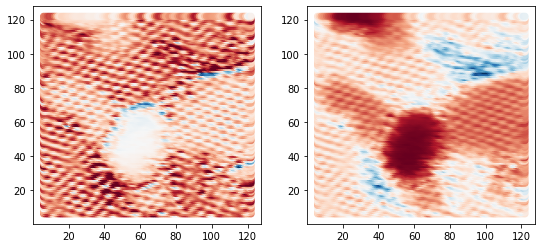

In [ ]:
embeded_full_comx = dklgp_full_comx.embed(X)
embeded_full_comx = embeded_full_comx / embeded_full_comx.max()

_, (ax1,ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded_full_comx[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded_full_comx[:, 1], cmap='RdBu')

* 10% data random sampling

In [ ]:
fraction = 0.1

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 1368/13689 data points


In [ ]:
dklgp10 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp10.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 0.8166
Epoch 10/200 ... Training loss: 0.7588
Epoch 20/200 ... Training loss: 0.7236
Epoch 30/200 ... Training loss: 0.6819
Epoch 40/200 ... Training loss: 0.6449
Epoch 50/200 ... Training loss: 0.612
Epoch 60/200 ... Training loss: 0.5763
Epoch 70/200 ... Training loss: 0.5381
Epoch 80/200 ... Training loss: 0.4986
Epoch 90/200 ... Training loss: 0.461
Epoch 100/200 ... Training loss: 0.4284
Epoch 110/200 ... Training loss: 0.3918
Epoch 120/200 ... Training loss: 0.3519
Epoch 130/200 ... Training loss: 0.3147
Epoch 140/200 ... Training loss: 0.2816
Epoch 150/200 ... Training loss: 0.2442
Epoch 160/200 ... Training loss: 0.2051
Epoch 170/200 ... Training loss: 0.1686
Epoch 180/200 ... Training loss: 0.1322
Epoch 190/200 ... Training loss: 0.1122
Epoch 200/200 ... Training loss: 0.0844


Plot DKL-GPR prediction for a selected slice:

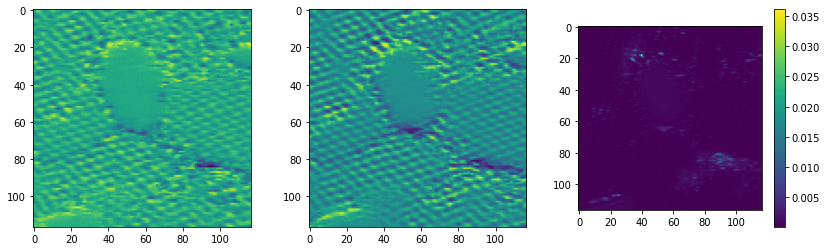

In [ ]:
mean10, var10 = dklgp10.predict(X, batch_size = 512)
mean10, var10 = mean10.T, var10.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction10 = mean10.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty10 = var10.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction10)
im3 = ax3.imshow(dkl_uncertainty10)
plt.colorbar(im3, ax=ax3)

### CoM y

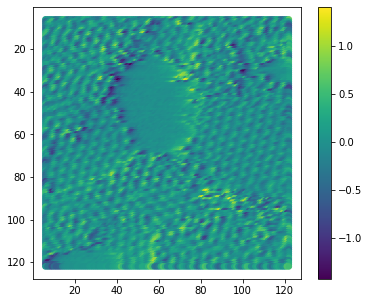

In [ ]:
physics_all, features_all, indices_all = scalarize4D("CoM y")

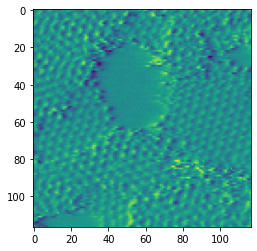

In [ ]:
groundtruth_comy = physics_all.reshape(f1-w1+1, f2-w2+1)
plt.imshow(groundtruth_comy)

Prepare data for training
* Select either `scalar` or `vector` DKL
* Note that vector DKL generally will require significantly more computational resources (i.e., better have the GPU enabled)

In [ ]:
dkl_mode = 'scalar'
# dkl_mode = 'vector' # 

n, d1, d2 = features_all.shape
X = features_all.reshape(n, d1*d2)
if dkl_mode == 'scalar':
  y = physics_all
elif dkl_mode == 'vector':
  y = targets.reshape(len(targets),int(targets.shape[1]*targets.shape[2]))
X.shape, y.shape

((13689, 144), (13689,))

Train:

In [ ]:
data_dim = X.shape[-1]
dklgp_full_comy = None
dklgp_full_comy = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp_full_comy.fit(X, y.T, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1, random_state = 42)

Epoch 1/100 ... Training loss: 0.7948
Epoch 10/100 ... Training loss: 0.7268
Epoch 20/100 ... Training loss: 0.6862
Epoch 30/100 ... Training loss: 0.6475
Epoch 40/100 ... Training loss: 0.6104
Epoch 50/100 ... Training loss: 0.5689
Epoch 60/100 ... Training loss: 0.5273
Epoch 70/100 ... Training loss: 0.4852
Epoch 80/100 ... Training loss: 0.4438
Epoch 90/100 ... Training loss: 0.3993
Epoch 100/100 ... Training loss: 0.3549


Predict

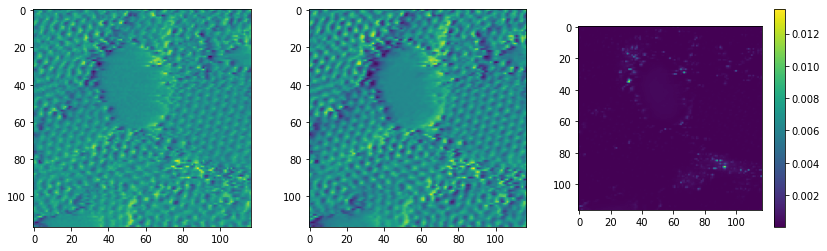

In [ ]:
mean_full_comy, var_full_comy = dklgp_full_comy.predict(X, batch_size = 512)
mean_full_comy, var_full_comy = mean_full_comy.T, var_full_comy.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_comy = mean_full_comy.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_comy = var_full_comy.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction_comy)
im3 = ax3.imshow(dkl_uncertainty_comy)
plt.colorbar(im3, ax=ax3)

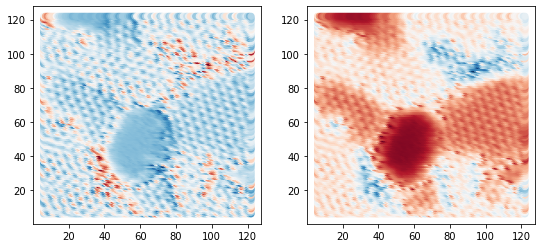

In [ ]:
embeded_full_comy = dklgp_full_comy.embed(X)
embeded_full_comy = embeded_full_comy / embeded_full_comy.max()

_, (ax1,ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded_full_comy[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded_full_comy[:, 1], cmap='RdBu')

* 10% data random sampling

In [ ]:
fraction = 0.1

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 1368/13689 data points


In [ ]:
dklgp10 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp10.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 0.7943
Epoch 10/200 ... Training loss: 0.7387
Epoch 20/200 ... Training loss: 0.6965
Epoch 30/200 ... Training loss: 0.6605
Epoch 40/200 ... Training loss: 0.6209
Epoch 50/200 ... Training loss: 0.5791
Epoch 60/200 ... Training loss: 0.5434
Epoch 70/200 ... Training loss: 0.4979
Epoch 80/200 ... Training loss: 0.4568
Epoch 90/200 ... Training loss: 0.4183
Epoch 100/200 ... Training loss: 0.375
Epoch 110/200 ... Training loss: 0.3323
Epoch 120/200 ... Training loss: 0.2941
Epoch 130/200 ... Training loss: 0.2505
Epoch 140/200 ... Training loss: 0.2056
Epoch 150/200 ... Training loss: 0.1614
Epoch 160/200 ... Training loss: 0.1192
Epoch 170/200 ... Training loss: 0.0783
Epoch 180/200 ... Training loss: 0.0364
Epoch 190/200 ... Training loss: 0.0043
Epoch 200/200 ... Training loss: -0.0383


Plot ground truth, DKL-GPR prediction and uncertainty:

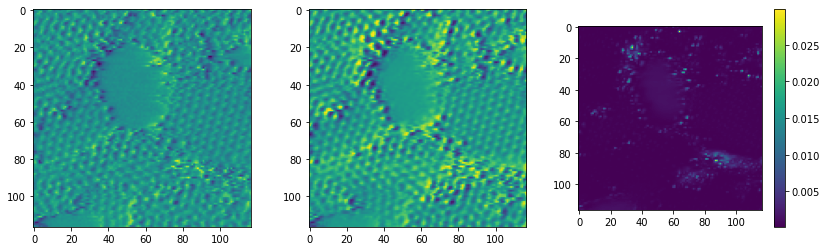

In [ ]:
mean10, var10 = dklgp10.predict(X, batch_size = 512)
mean10, var10 = mean10.T, var10.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction10 = mean10.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty10 = var10.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction10)
im3 = ax3.imshow(dkl_uncertainty10)
plt.colorbar(im3, ax=ax3)

### CoM angle (max radians)

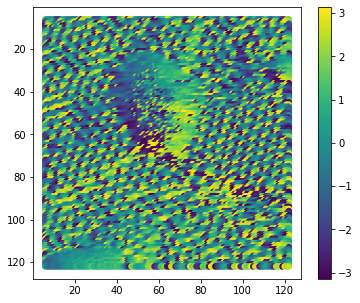

In [ ]:
physics_all, features_all, indices_all = scalarize4D("CoM angle")

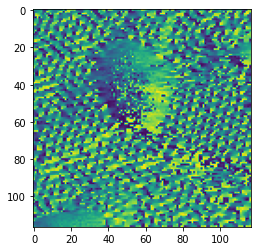

In [ ]:
groundtruth_comangle = physics_all.reshape(f1-w1+1, f2-w2+1)
plt.imshow(groundtruth_comangle)

Prepare data for training
* Select either `scalar` or `vector` DKL
* Note that vector DKL generally will require significantly more computational resources (i.e., better have the GPU enabled)

In [ ]:
dkl_mode = 'scalar'
# dkl_mode = 'vector' # 

n, d1, d2 = features_all.shape
X = features_all.reshape(n, d1*d2)
if dkl_mode == 'scalar':
  y = physics_all
elif dkl_mode == 'vector':
  y = targets.reshape(len(targets),int(targets.shape[1]*targets.shape[2]))
X.shape, y.shape

((13689, 144), (13689,))

Train:

In [ ]:
data_dim = X.shape[-1]
dklgp_full_angle = None
dklgp_full_angle = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp_full_angle.fit(X, y.T, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1, random_state = 42)

Epoch 1/100 ... Training loss: 3.1265
Epoch 10/100 ... Training loss: 2.3699
Epoch 20/100 ... Training loss: 2.1695
Epoch 30/100 ... Training loss: 2.0612
Epoch 40/100 ... Training loss: 2.115
Epoch 50/100 ... Training loss: 2.0182
Epoch 60/100 ... Training loss: 1.9997
Epoch 70/100 ... Training loss: 1.9113
Epoch 80/100 ... Training loss: 1.8434
Epoch 90/100 ... Training loss: 1.7904
Epoch 100/100 ... Training loss: 1.7884


Predict

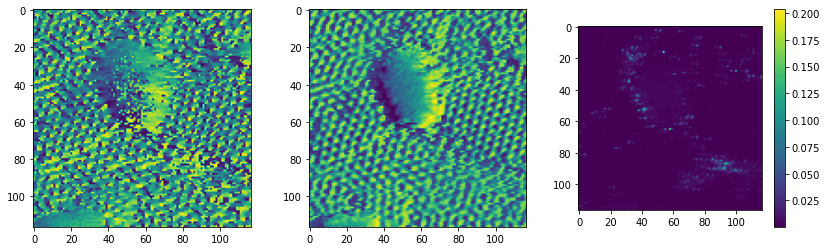

In [ ]:
mean_full_angle, var_full_angle = dklgp_full_angle.predict(X, batch_size = 512)
mean_full_angle, var_full_angle = mean_full_angle.T, var_full_angle.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_angle = mean_full_angle.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_angle = var_full_angle.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction_angle)
im3 = ax3.imshow(dkl_uncertainty_angle)
plt.colorbar(im3, ax=ax3)

Plot DKL-GPR average prediction & uncertainty, virtual ABF and virtual ADF reconstructions and ground truths

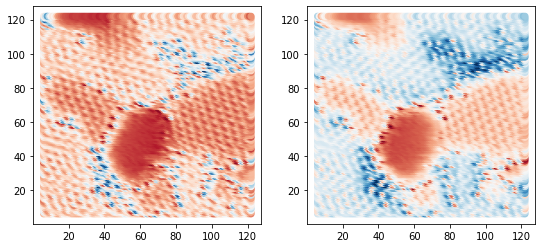

In [ ]:
embeded_full_angle = dklgp_full_angle.embed(X)
embeded_full_angle = embeded_full_angle / embeded_full_angle.max()

_, (ax1,ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded_full_angle[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded_full_angle[:, 1], cmap='RdBu')

* 10% data random sampling

In [ ]:
fraction = 0.1

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 1368/13689 data points


In [ ]:
dklgp10 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp10.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 3.1036
Epoch 10/200 ... Training loss: 2.6166
Epoch 20/200 ... Training loss: 2.2668
Epoch 30/200 ... Training loss: 2.0573
Epoch 40/200 ... Training loss: 1.9078
Epoch 50/200 ... Training loss: 1.7774
Epoch 60/200 ... Training loss: 1.6788
Epoch 70/200 ... Training loss: 1.682
Epoch 80/200 ... Training loss: 1.5879
Epoch 90/200 ... Training loss: 1.5101
Epoch 100/200 ... Training loss: 1.4499
Epoch 110/200 ... Training loss: 1.9484
Epoch 120/200 ... Training loss: 1.9094
Epoch 130/200 ... Training loss: 1.704
Epoch 140/200 ... Training loss: 1.6179
Epoch 150/200 ... Training loss: 1.5206
Epoch 160/200 ... Training loss: 1.5024
Epoch 170/200 ... Training loss: 1.4762
Epoch 180/200 ... Training loss: 1.4609
Epoch 190/200 ... Training loss: 1.5128
Epoch 200/200 ... Training loss: 1.471


Plot DKL-GPR prediction for a selected slice:

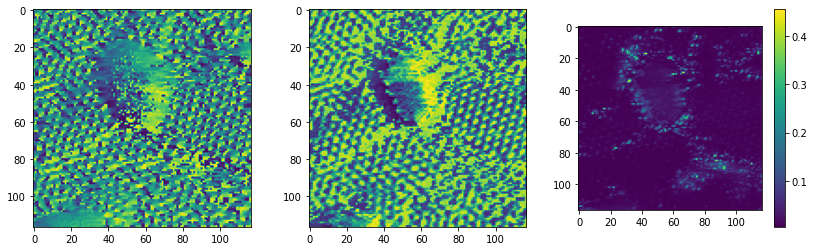

In [ ]:
mean10, var10 = dklgp10.predict(X, batch_size = 512)
mean10, var10 = mean10.T, var10.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction10 = mean10.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty10 = var10.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction10)
im3 = ax3.imshow(dkl_uncertainty10)
plt.colorbar(im3, ax=ax3)

### CoM magnitude

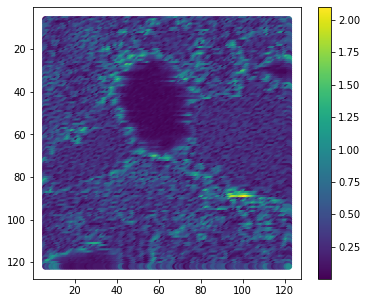

In [22]:
physics_all, features_all, indices_all = scalarize4D("CoM magnitude")

Prepare data for training
* Select either `scalar` or `vector` DKL
* Note that vector DKL generally will require significantly more computational resources (i.e., better have the GPU enabled)

In [23]:
dkl_mode = 'scalar'
# dkl_mode = 'vector' # 

n, d1, d2 = features_all.shape
X = features_all.reshape(n, d1*d2)
if dkl_mode == 'scalar':
  y = physics_all
elif dkl_mode == 'vector':
  y = targets.reshape(len(targets),int(targets.shape[1]*targets.shape[2]))
X.shape, y.shape

((13689, 144), (13689,))

Train:

In [ ]:
data_dim = X.shape[-1]

dklgp_full = None
dklgp_full = aoi.models.dklGPR(data_dim, embedim=2, precision="double", random_state = 42)
dklgp_full.fit(X, y.T, training_cycles=100, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/100 ... Training loss: 0.7767
Epoch 10/100 ... Training loss: 0.7342
Epoch 20/100 ... Training loss: 0.6969
Epoch 30/100 ... Training loss: 0.6595
Epoch 40/100 ... Training loss: 0.6215
Epoch 50/100 ... Training loss: 0.5825
Epoch 60/100 ... Training loss: 0.5447
Epoch 70/100 ... Training loss: 0.5024
Epoch 80/100 ... Training loss: 0.4601
Epoch 90/100 ... Training loss: 0.4187
Epoch 100/100 ... Training loss: 0.3764


Predict

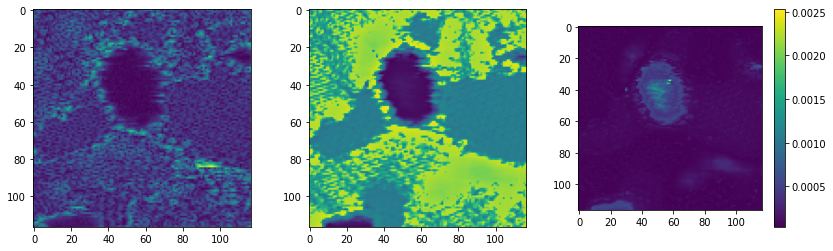

In [ ]:
#  winsize = 12, 100 training cycles

mean_full, var_full = dklgp_full.predict(X, batch_size = 512)
mean_full, var_full = mean_full.T, var_full.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction = mean_full.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty = var_full.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction)
im3 = ax3.imshow(dkl_uncertainty)
plt.colorbar(im3, ax=ax3)

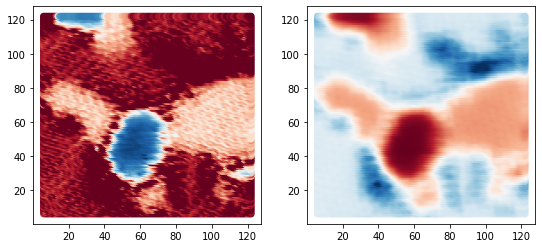

In [ ]:
embeded_full = dklgp_full.embed(X)
embeded_full = embeded_full / embeded_full.max()

_, (ax1,ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded_full[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded_full[:, 1], cmap='RdBu')

* 10% data random sampling

In [ ]:
fraction = 0.1

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 1368/13689 data points


In [ ]:
dklgp10 = None
dklgp10 = aoi.models.dklGPR(data_dim, embedim=2, precision="double", random_state = 42)
dklgp10.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 0.7778
Epoch 10/200 ... Training loss: 0.7459
Epoch 20/200 ... Training loss: 0.7057
Epoch 30/200 ... Training loss: 0.6688
Epoch 40/200 ... Training loss: 0.6326
Epoch 50/200 ... Training loss: 0.5929
Epoch 60/200 ... Training loss: 0.5549
Epoch 70/200 ... Training loss: 0.5123
Epoch 80/200 ... Training loss: 0.4713
Epoch 90/200 ... Training loss: 0.4306
Epoch 100/200 ... Training loss: 0.3893
Epoch 110/200 ... Training loss: 0.3456
Epoch 120/200 ... Training loss: 0.3009
Epoch 130/200 ... Training loss: 0.2662
Epoch 140/200 ... Training loss: 0.2222
Epoch 150/200 ... Training loss: 0.1781
Epoch 160/200 ... Training loss: 0.1404
Epoch 170/200 ... Training loss: 0.099
Epoch 180/200 ... Training loss: 0.0579
Epoch 190/200 ... Training loss: 0.0159
Epoch 200/200 ... Training loss: -0.0252


Plot DKL-GPR prediction for a selected slice:

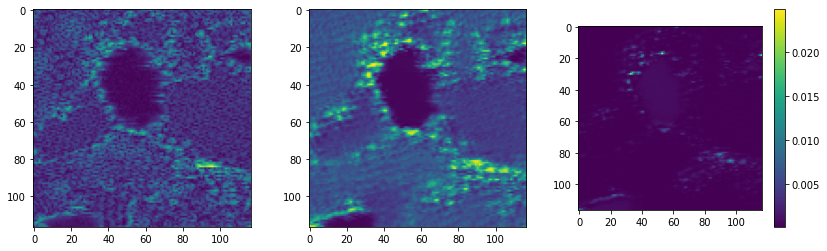

In [ ]:
mean10, var10 = dklgp10.predict(X, batch_size = 512)
mean10, var10 = mean10.T, var10.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction10 = mean10.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty10 = var10.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction10)
im3 = ax3.imshow(dkl_uncertainty10)
plt.colorbar(im3, ax=ax3)

* 1% data random sampling

In [ ]:
fraction = 0.01

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 136/13689 data points


In [ ]:
dklgp01 = None
dklgp01 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp01.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 0.7885
Epoch 10/200 ... Training loss: 0.7594
Epoch 20/200 ... Training loss: 0.7226
Epoch 30/200 ... Training loss: 0.6828
Epoch 40/200 ... Training loss: 0.6432
Epoch 50/200 ... Training loss: 0.6008
Epoch 60/200 ... Training loss: 0.5577
Epoch 70/200 ... Training loss: 0.512
Epoch 80/200 ... Training loss: 0.4649
Epoch 90/200 ... Training loss: 0.4177
Epoch 100/200 ... Training loss: 0.3683
Epoch 110/200 ... Training loss: 0.3201
Epoch 120/200 ... Training loss: 0.2715
Epoch 130/200 ... Training loss: 0.2264
Epoch 140/200 ... Training loss: 0.1752
Epoch 150/200 ... Training loss: 0.1247
Epoch 160/200 ... Training loss: 0.0748
Epoch 170/200 ... Training loss: 0.0247
Epoch 180/200 ... Training loss: -0.0265
Epoch 190/200 ... Training loss: -0.0726
Epoch 200/200 ... Training loss: -0.1265


Plot DKL-GPR prediction for a selected slice:

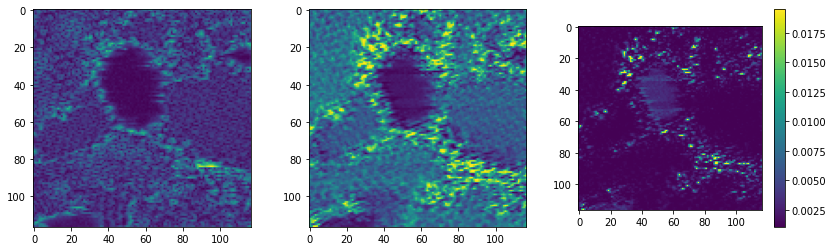

In [ ]:
mean01, var01 = dklgp01.predict(X, batch_size = 512)
mean01, var01 = mean01.T, var01.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction01 = mean01.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty01 = var01.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction01)
im3 = ax3.imshow(dkl_uncertainty01)
plt.colorbar(im3, ax=ax3)

* 0.1% data random sampling

In [ ]:
fraction = 0.001

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 13/13689 data points


In [ ]:
dklgp001 = None
dklgp001 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp001.fit(X_train, y_train, training_cycles=200, lr=1e-2, CUDA_LAUNCH_BLOCKING=1)

Epoch 1/200 ... Training loss: 0.8713
Epoch 10/200 ... Training loss: 0.8453
Epoch 20/200 ... Training loss: 0.8055
Epoch 30/200 ... Training loss: 0.7572
Epoch 40/200 ... Training loss: 0.714
Epoch 50/200 ... Training loss: 0.6701
Epoch 60/200 ... Training loss: 0.6256
Epoch 70/200 ... Training loss: 0.5806
Epoch 80/200 ... Training loss: 0.5372
Epoch 90/200 ... Training loss: 0.4938
Epoch 100/200 ... Training loss: 0.45
Epoch 110/200 ... Training loss: 0.4057
Epoch 120/200 ... Training loss: 0.3612
Epoch 130/200 ... Training loss: 0.3175
Epoch 140/200 ... Training loss: 0.2727
Epoch 150/200 ... Training loss: 0.2279
Epoch 160/200 ... Training loss: 0.1836
Epoch 170/200 ... Training loss: 0.1392
Epoch 180/200 ... Training loss: 0.0957
Epoch 190/200 ... Training loss: 0.0573
Epoch 200/200 ... Training loss: 0.0166


Plot DKL-GPR prediction for a selected slice:

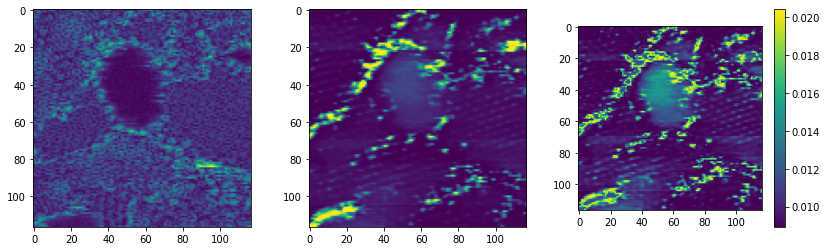

In [ ]:
mean001, var001 = dklgp001.predict(X, batch_size = 512)
mean001, var001 = mean001.T, var001.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction001 = mean001.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty001 = var001.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(physics_all.reshape(f1-w1+1, f2-w2+1))
im2 = ax2.imshow(dkl_prediction001)
im3 = ax3.imshow(dkl_uncertainty001)
plt.colorbar(im3, ax=ax3)

#### figure: DKL reconstruction

In [ ]:
unc_min = np.min([dkl_uncertainty,dkl_uncertainty10,dkl_uncertainty01,dkl_uncertainty001])
unc_max = np.max([dkl_uncertainty,dkl_uncertainty10,dkl_uncertainty01,dkl_uncertainty001])

unc_min, unc_max

(3.835637043314577e-05, 0.024885023521822147)

[]

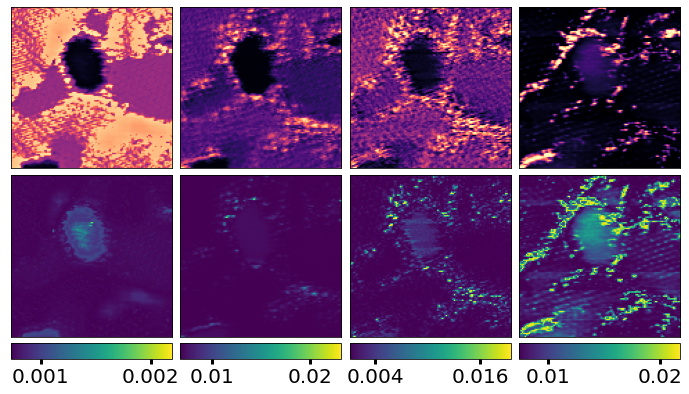

In [ ]:
colormap = 'magma'

plt.figure(figsize=(12,6.5))
gs = gridspec.GridSpec(3,4, height_ratios=[1,1,0.1], wspace = 0.05, hspace = 0.05)

ax00,ax01,ax02,ax03 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1]), plt.subplot(gs[0,2]), plt.subplot(gs[0,3])
ax10,ax11,ax12,ax13 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2]), plt.subplot(gs[1,3])
ax20,ax21,ax22,ax23 = plt.subplot(gs[2,0]), plt.subplot(gs[2,1]), plt.subplot(gs[2,2]), plt.subplot(gs[2,3])

im00 = ax00.imshow(normalize(dkl_prediction), cmap = colormap, vmax = 1)
im11 = ax01.imshow(dkl_prediction10, cmap = colormap)
ax02.imshow(dkl_prediction01, cmap = colormap)
ax03.imshow(dkl_prediction001, cmap = colormap)

im10 = ax10.imshow(dkl_uncertainty)
im11 = ax11.imshow(dkl_uncertainty10)
im12 = ax12.imshow(dkl_uncertainty01)
im13 = ax13.imshow(dkl_uncertainty001)

cbar20 = plt.colorbar(im10,ax=ax20, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal', format = '%.3f')
cbar21 = plt.colorbar(im11,ax=ax21, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal', format = '%.2f')
cbar22 = plt.colorbar(im12,ax=ax22, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal', format = '%.3f')
cbar23 = plt.colorbar(im13,ax=ax23, fraction = 1, aspect = 10, pad = 0.02, orientation = 'horizontal', format = '%.2f')

cbar20.ax.tick_params(labelsize = 20, width = 3, length = 5)
cbar21.ax.tick_params(labelsize = 20, width = 3, length = 5)
cbar22.ax.tick_params(labelsize = 20, width = 3, length = 5)
cbar23.ax.tick_params(labelsize = 20, width = 3, length = 5)

cbar20.ax.get_xaxis().set_ticks([0.0005, 0.0022])
cbar21.ax.get_xaxis().set_ticks([0.005, 0.02])
cbar22.ax.get_xaxis().set_ticks([0.004, 0.016])
cbar23.ax.get_xaxis().set_ticks([0.011, 0.019])

ax20.axis('off'), ax21.axis('off'), ax22.axis('off'), ax23.axis('off')
axes = [ax00,ax01,ax02,ax03,ax04,ax10,ax11,ax12,ax13,ax14]
plt.setp(axes,xticks=[],yticks=[])

# Active learning (TBG)
* Using CoM magnitude

In [24]:
# Here X_train and y_train are our measured image patches (HAADF) and spectra/peaks (EELS),
# whereas X_test and y_test are the "unknown" ones. The indices_train are grid coordinates of the measured points,
# whereas the indices_test are the grid coordinates of the remaining available points on the grid

# Adjust test_size value until number of "initial" random points is desired, for example, 2.

(X_train, X_test, y_train, y_test,
 indices_train, indices_test) = train_test_split(
     X, y, indices, test_size=0.9998, shuffle=True, random_state=20)

# The targets for the DKL-GPR must have vector_size x n_samples dimensions where vector_size is equal to spectral length
y_train = y_train.T
y_test = y_test.T

print(X_train.shape) # n_samples x n_features
print(y_train.shape) # vector_size x n_samples 

(2, 144)
(2,)


1/50
Epoch 1/20 ... Training loss: 1.0427
Epoch 10/20 ... Training loss: 1.0255
Epoch 20/20 ... Training loss: 0.9522


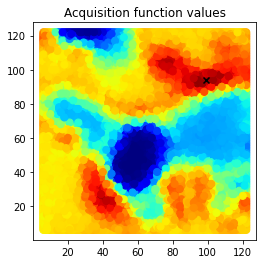

2/50
Epoch 1/20 ... Training loss: 0.9843
Epoch 10/20 ... Training loss: 0.9688
Epoch 20/20 ... Training loss: 0.9072


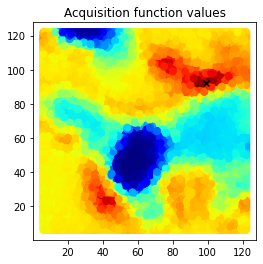

3/50
Epoch 1/20 ... Training loss: 0.9505
Epoch 10/20 ... Training loss: 0.9415
Epoch 20/20 ... Training loss: 0.886


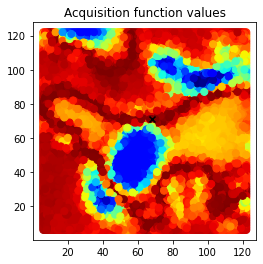

4/50
Epoch 1/20 ... Training loss: 0.9295
Epoch 10/20 ... Training loss: 0.9293
Epoch 20/20 ... Training loss: 0.8613


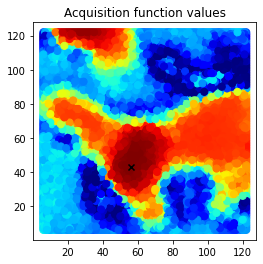

5/50
Epoch 1/20 ... Training loss: 0.9187
Epoch 10/20 ... Training loss: 0.9212
Epoch 20/20 ... Training loss: 0.8696


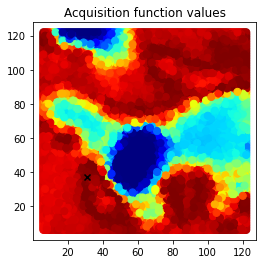

6/50
Epoch 1/20 ... Training loss: 0.9024
Epoch 10/20 ... Training loss: 0.9115
Epoch 20/20 ... Training loss: 0.856


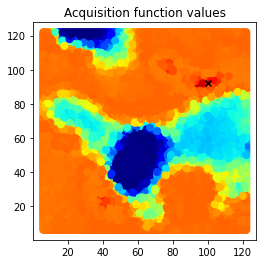

7/50
Epoch 1/20 ... Training loss: 0.9182
Epoch 10/20 ... Training loss: 0.9243
Epoch 20/20 ... Training loss: 0.8695


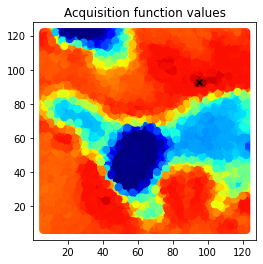

8/50
Epoch 1/20 ... Training loss: 0.9052
Epoch 10/20 ... Training loss: 0.8936
Epoch 20/20 ... Training loss: 0.8466


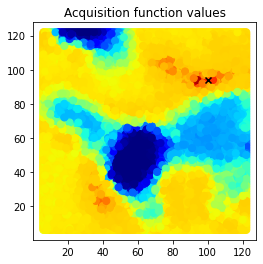

9/50
Epoch 1/20 ... Training loss: 0.8959
Epoch 10/20 ... Training loss: 0.8858
Epoch 20/20 ... Training loss: 0.8389


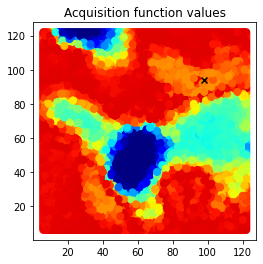

10/50
Epoch 1/20 ... Training loss: 0.8864
Epoch 10/20 ... Training loss: 0.8785
Epoch 20/20 ... Training loss: 0.8288


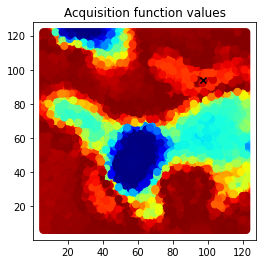

11/50
Epoch 1/20 ... Training loss: 0.8781
Epoch 10/20 ... Training loss: 0.8729
Epoch 20/20 ... Training loss: 0.8199


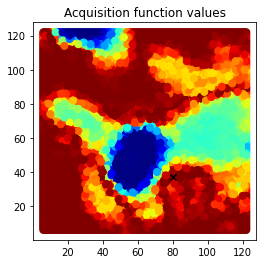

12/50
Epoch 1/20 ... Training loss: 0.8722
Epoch 10/20 ... Training loss: 0.8583
Epoch 20/20 ... Training loss: 0.818


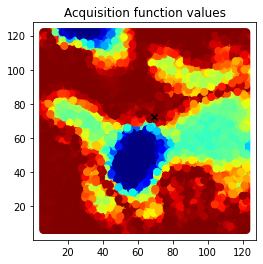

13/50
Epoch 1/20 ... Training loss: 0.8652
Epoch 10/20 ... Training loss: 0.8613
Epoch 20/20 ... Training loss: 0.8077


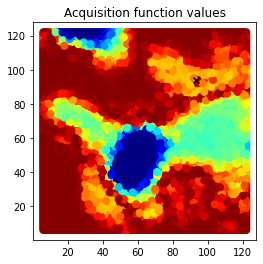

14/50
Epoch 1/20 ... Training loss: 0.8604
Epoch 10/20 ... Training loss: 0.856
Epoch 20/20 ... Training loss: 0.8058


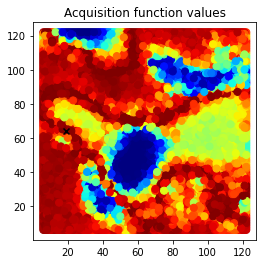

15/50
Epoch 1/20 ... Training loss: 0.8597
Epoch 10/20 ... Training loss: 0.8564
Epoch 20/20 ... Training loss: 0.809


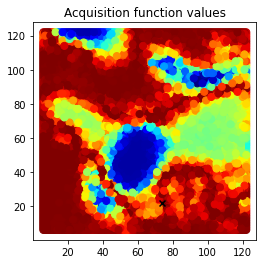

16/50
Epoch 1/20 ... Training loss: 0.8547
Epoch 10/20 ... Training loss: 0.852
Epoch 20/20 ... Training loss: 0.8055


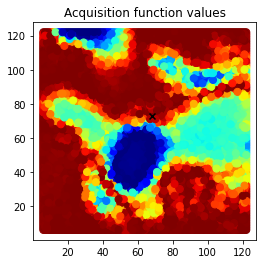

17/50
Epoch 1/20 ... Training loss: 0.8547
Epoch 10/20 ... Training loss: 0.844
Epoch 20/20 ... Training loss: 0.7972


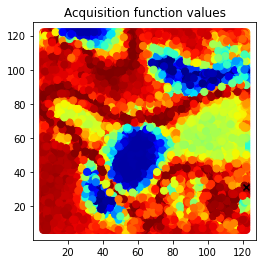

18/50
Epoch 1/20 ... Training loss: 0.8523
Epoch 10/20 ... Training loss: 0.8431
Epoch 20/20 ... Training loss: 0.8023


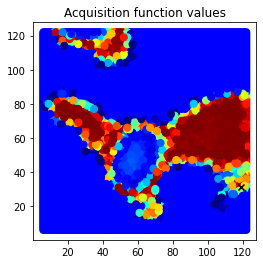

19/50
Epoch 1/20 ... Training loss: 0.8515
Epoch 10/20 ... Training loss: 0.8383
Epoch 20/20 ... Training loss: 0.7991


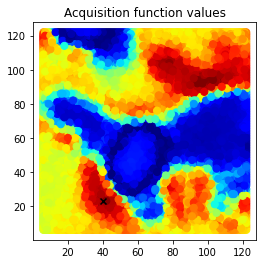

20/50
Epoch 1/20 ... Training loss: 0.8504
Epoch 10/20 ... Training loss: 0.8472
Epoch 20/20 ... Training loss: 0.8022


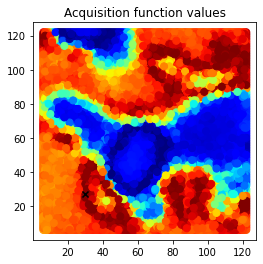

21/50
Epoch 1/20 ... Training loss: 0.8467
Epoch 10/20 ... Training loss: 0.8449
Epoch 20/20 ... Training loss: 0.7952


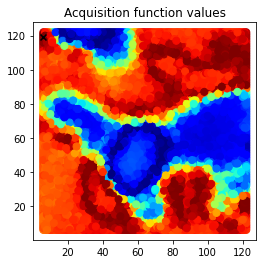

22/50
Epoch 1/20 ... Training loss: 0.8435
Epoch 10/20 ... Training loss: 0.8401
Epoch 20/20 ... Training loss: 0.7951


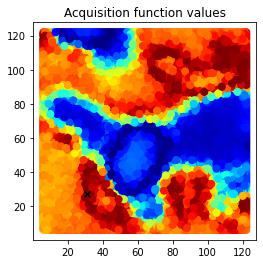

23/50
Epoch 1/20 ... Training loss: 0.8418
Epoch 10/20 ... Training loss: 0.833
Epoch 20/20 ... Training loss: 0.7963


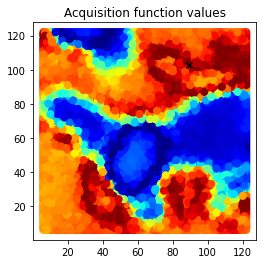

24/50
Epoch 1/20 ... Training loss: 0.8384
Epoch 10/20 ... Training loss: 0.8278
Epoch 20/20 ... Training loss: 0.7868


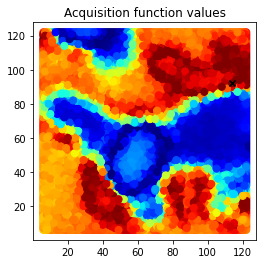

25/50
Epoch 1/20 ... Training loss: 0.8417
Epoch 10/20 ... Training loss: 0.8339
Epoch 20/20 ... Training loss: 0.7894


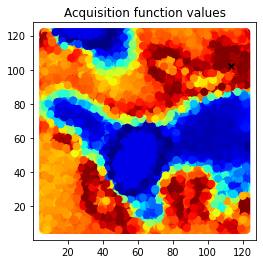

26/50
Epoch 1/20 ... Training loss: 0.8475
Epoch 10/20 ... Training loss: 0.8298
Epoch 20/20 ... Training loss: 0.7887


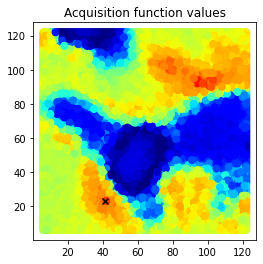

27/50
Epoch 1/20 ... Training loss: 0.8446
Epoch 10/20 ... Training loss: 0.8267
Epoch 20/20 ... Training loss: 0.8041


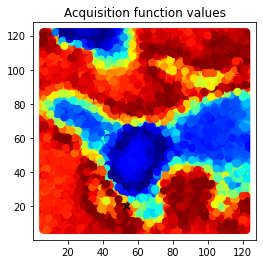

28/50
Epoch 1/20 ... Training loss: 0.8425
Epoch 10/20 ... Training loss: 0.8255
Epoch 20/20 ... Training loss: 0.7881


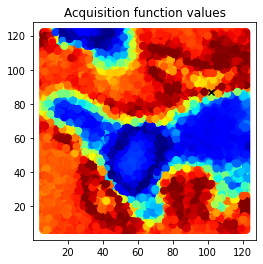

29/50
Epoch 1/20 ... Training loss: 0.8411
Epoch 10/20 ... Training loss: 0.8242
Epoch 20/20 ... Training loss: 0.7858


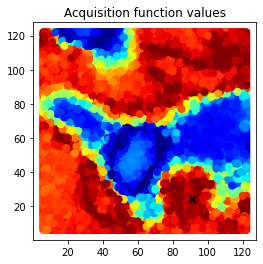

30/50
Epoch 1/20 ... Training loss: 0.8398
Epoch 10/20 ... Training loss: 0.8233
Epoch 20/20 ... Training loss: 0.7858


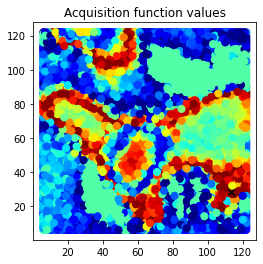

31/50
Epoch 1/20 ... Training loss: 0.8376
Epoch 10/20 ... Training loss: 0.8219
Epoch 20/20 ... Training loss: 0.782


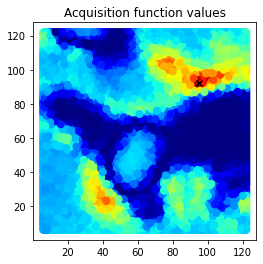

32/50
Epoch 1/20 ... Training loss: 0.8498
Epoch 10/20 ... Training loss: 0.8361
Epoch 20/20 ... Training loss: 0.7968


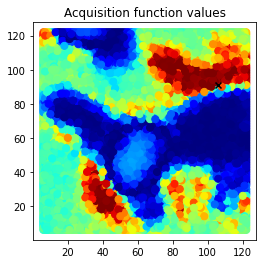

33/50
Epoch 1/20 ... Training loss: 0.848
Epoch 10/20 ... Training loss: 0.8341
Epoch 20/20 ... Training loss: 0.7937


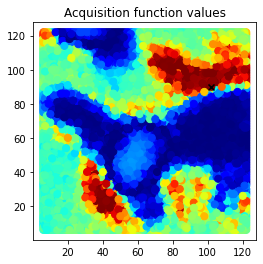

34/50
Epoch 1/20 ... Training loss: 0.8984
Epoch 10/20 ... Training loss: 0.8856
Epoch 20/20 ... Training loss: 0.8477


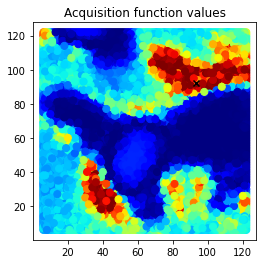

35/50
Epoch 1/20 ... Training loss: 0.8946
Epoch 10/20 ... Training loss: 0.8839
Epoch 20/20 ... Training loss: 0.8462


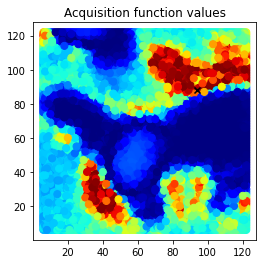

36/50
Epoch 1/20 ... Training loss: 0.8934
Epoch 10/20 ... Training loss: 0.8738
Epoch 20/20 ... Training loss: 0.84


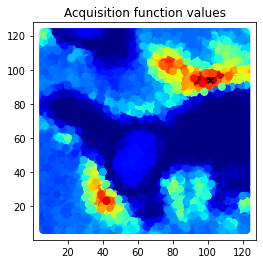

37/50
Epoch 1/20 ... Training loss: 0.8901
Epoch 10/20 ... Training loss: 0.8734
Epoch 20/20 ... Training loss: 0.8362


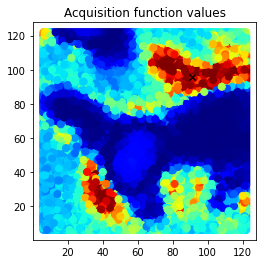

38/50
Epoch 1/20 ... Training loss: 0.8934
Epoch 10/20 ... Training loss: 0.8733
Epoch 20/20 ... Training loss: 0.8254


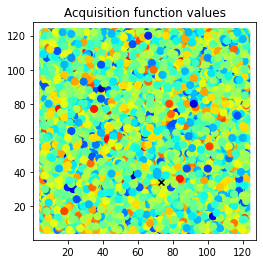

39/50
Epoch 1/20 ... Training loss: 0.8899
Epoch 10/20 ... Training loss: 0.8705
Epoch 20/20 ... Training loss: 0.8334


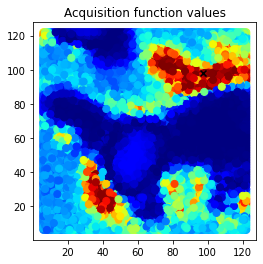

40/50
Epoch 1/20 ... Training loss: 0.887
Epoch 10/20 ... Training loss: 0.8673
Epoch 20/20 ... Training loss: 0.8312


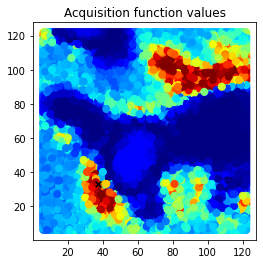

41/50
Epoch 1/20 ... Training loss: 0.8848
Epoch 10/20 ... Training loss: 0.8628
Epoch 20/20 ... Training loss: 0.8262


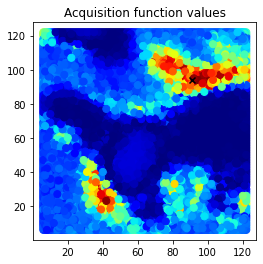

42/50
Epoch 1/20 ... Training loss: 0.8826
Epoch 10/20 ... Training loss: 0.8609
Epoch 20/20 ... Training loss: 0.8318


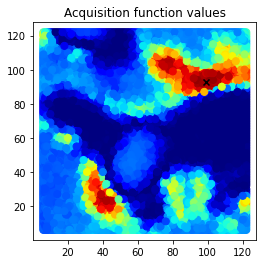

43/50
Epoch 1/20 ... Training loss: 0.8797
Epoch 10/20 ... Training loss: 0.8576
Epoch 20/20 ... Training loss: 0.8261


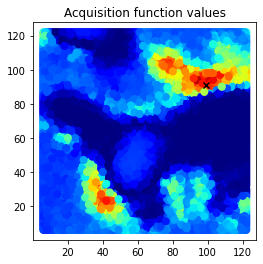

44/50
Epoch 1/20 ... Training loss: 0.8768
Epoch 10/20 ... Training loss: 0.8567
Epoch 20/20 ... Training loss: 0.8212


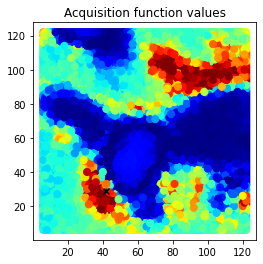

45/50
Epoch 1/20 ... Training loss: 0.8753
Epoch 10/20 ... Training loss: 0.8536
Epoch 20/20 ... Training loss: 0.8192


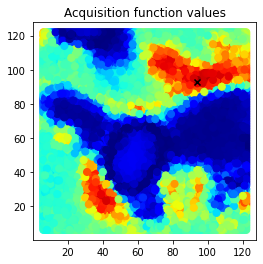

46/50
Epoch 1/20 ... Training loss: 0.8741
Epoch 10/20 ... Training loss: 0.8517
Epoch 20/20 ... Training loss: 0.8208


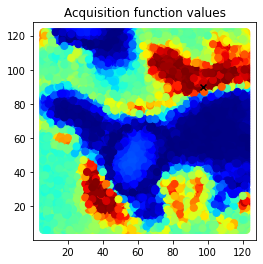

47/50
Epoch 1/20 ... Training loss: 0.8965
Epoch 10/20 ... Training loss: 0.8655
Epoch 20/20 ... Training loss: 0.8013


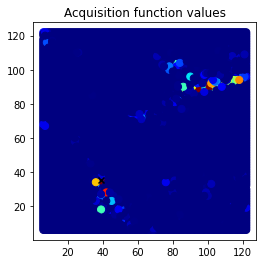

48/50
Epoch 1/20 ... Training loss: 0.8939
Epoch 10/20 ... Training loss: 0.8611
Epoch 20/20 ... Training loss: 0.7988


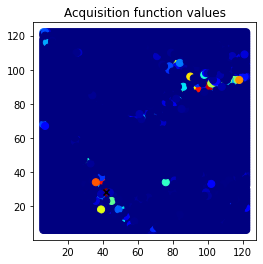

49/50
Epoch 1/20 ... Training loss: 0.8926
Epoch 10/20 ... Training loss: 0.847
Epoch 20/20 ... Training loss: 0.802


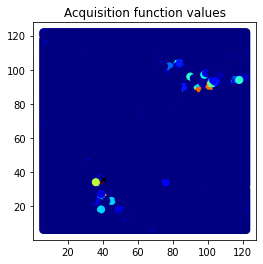

50/50
Epoch 1/20 ... Training loss: 0.8956
Epoch 10/20 ... Training loss: 0.8707
Epoch 20/20 ... Training loss: 0.7962


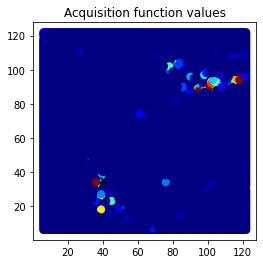

In [25]:
exploration_steps = 50  # 

xi = 0.01                # balances exploration and exploitation for EI

################################################################################
import time  # NEW LINE
time_all = []  # NEW LINE

AF_results = []
data_dim = X_train.shape[-1]
for e in range(exploration_steps):
    print("{}/{}".format(e+1, exploration_steps))
    start_time = time.time()  # NEW LINE
    training_iter = 20 if e < 100 else 40  # we do not want to "overfit" our model at the beginning

    # update GP posterior
    dklgp_new = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
    dklgp_new.fit(X_train, y_train, training_cycles=training_iter,lr = 1e-2,CUDA_LAUNCH_BLOCKING=1)

    # Compute the acquisition function
    best_f = torch.tensor(dklgp_new.predict(X_train)[0].max())
    obj = EI(dklgp_new, X_test, best_f, xi)

    # SAVE current acquisition function
    AF = save_result(indices_test, obj)
    AF_results.append(AF)
  
    obj = obj.T # transpose to n_samples x vector_size  for consistency

    # Scalarize the acquisition function
    # obj = scalarize_acq(obj, scalar = 'CoM x')  # Not necessary for scalar DKL (BUT YES necessary for microscope)

    # Select the next point to "measure"
    next_point_idx = obj.argmax()
    next_point = indices_test[next_point_idx]

    # Do "measurement"
    measured_point = y_test[next_point_idx]

    # Plot current result
    plot_result(indices_test, obj, e)

    # SAVE current MODEL WEIGHTS
    state_dict = dklgp_new.gp_model.state_dict()
    torch.save(state_dict, "Model_ActiveDKL {}.pt".format(e))

    # Append to the arrays of measured points
    X_train = np.append(X_train, X_test[next_point_idx][None], 0)
    X_test = np.delete(X_test, next_point_idx, 0)
    # y_train = np.append(y_train, measured_point[:,None], 1)
    y_train = np.append(y_train, measured_point)
    # y_test = np.delete(y_test, next_point_idx, 1)
    y_test = np.delete(y_test, next_point_idx)
    indices_train = np.append(indices_train, next_point[None], 0)
    indices_test = np.delete(indices_test, next_point_idx, 0)
    time_all.append(time.time() - start_time)  # NEW LINE

In [47]:
print("Average training time on CPU: {0:.2f} seconds".format(np.mean(time_all)))

Average training time on CPU: 2.53 seconds


Overlay the explored point with a ground truth (again, we only will have a ground truth for *pre*-acquired data):

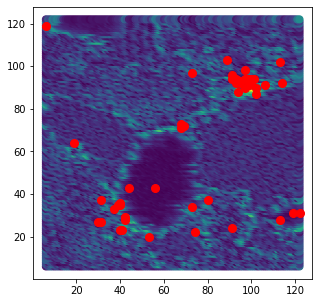

In [26]:
plt.figure(figsize=(5, 5))
plt.scatter(indices[:, 1], indices[:, 0], s=50, c=y)
plt.scatter(indices_train[:, 1], indices_train[:, 0], s=64, c='r')

In [28]:
try:
    os.rename("Model_ActiveDKL 0.pt", "Model_ActiveDKL 00.pt")
    os.rename("Model_ActiveDKL 1.pt", "Model_ActiveDKL 01.pt")
    os.rename("Model_ActiveDKL 2.pt", "Model_ActiveDKL 02.pt")
    os.rename("Model_ActiveDKL 3.pt", "Model_ActiveDKL 03.pt")
    os.rename("Model_ActiveDKL 4.pt", "Model_ActiveDKL 04.pt")
    os.rename("Model_ActiveDKL 5.pt", "Model_ActiveDKL 05.pt")
    os.rename("Model_ActiveDKL 6.pt", "Model_ActiveDKL 06.pt")
    os.rename("Model_ActiveDKL 7.pt", "Model_ActiveDKL 07.pt")
    os.rename("Model_ActiveDKL 8.pt", "Model_ActiveDKL 08.pt")
    os.rename("Model_ActiveDKL 9.pt", "Model_ActiveDKL 09.pt")
except FileNotFoundError:
  pass

model_files = sorted(glob.glob("Model_*.pt"))

* AF movies / reconstructions

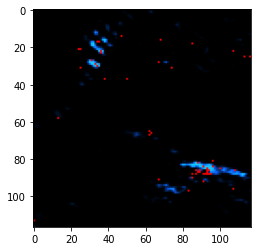

In [29]:
structural_img = np.copy(full_img)
AF_all, AF_all_color_combo, AF_combined = Make_AF_movies_preacquired(acquisition_functions = AF_results,
                                                                     RGB = Blue,
                                                                     brightness = 2,
                                                                     measured_points_in_AF = [1,0,0],
                                                                     measured_points_in_HAADF = [1,0,0])

plt.imshow(AF_all_color_combo[-1])

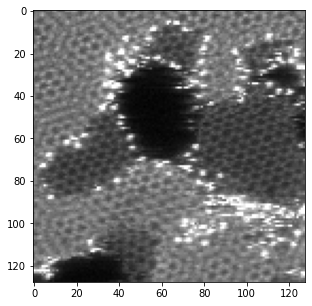

In [30]:
cutoff_int = 0.5
full_img = np.copy(img)
testim = np.copy(normalize(full_img))
testim[np.where(testim>cutoff_int)] = cutoff_int

plt.figure(figsize=(5,5))
plt.imshow(testim, cmap = 'gray')

In [31]:
size_increase = 2
imgformov = testim

HAADF_mov = create_point_search_mov_preacquired(imgformov, AF_combined, size = structural_img.shape, point_radius = 2, point_color = [1,0,0], offset = 0)
AF_resized = resize(AF_all_color_combo, HAADF_mov.shape)
Movie_combined = np.concatenate((AF_resized, HAADF_mov), axis = 2)

s1,s2,s3,s4 =  Movie_combined.shape
Movie_combined_upscaled = resize(Movie_combined, (s1,s2*size_increase,s3*size_increase,s4))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:301: FutureWarning: `draw.circle` is deprecated in favor of `draw.disk`.`draw.circle` will be removed in version 0.19


* View the A.F. at the last step:

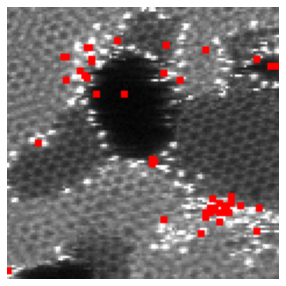

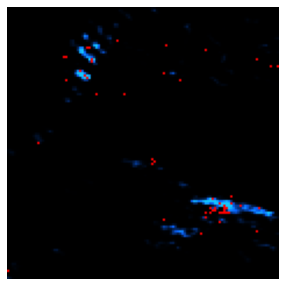

In [32]:
step = -1

plt.figure(figsize=(9,5))
ax=plt.gca()
ax.imshow(HAADF_mov[step])
# ax.scatter(53,65,marker = 'x', color='y', s=100)
ax.axis('off')

plt.figure(figsize=(9,5))
ax=plt.gca()
ax.imshow(AF_resized[step])
ax.axis('off');

* Create a movie

In [58]:
Mov_name = "TBG_01_acquisitionfunction.mp4"

imageio.mimwrite(Mov_name, Movie_combined_upscaled, fps = 4)
Video(Mov_name, embed = True)

* Load and evaluate model performance at specific fractions of measured data points

In [33]:
weights_files = []
weights_files = sorted(glob.glob('*.pt'))
len(weights_files)

50

* Use model at this step.... (note, later cells use a function to accomplish the following two cells)

In [34]:
step = -1  # model step from which to load weights

#####################################
### do not change below parameters ###
#####################################

weights = weights_files[step]
device = 'cpu'            # constant  (cpu or cuda)
dtype = torch.float64     # constant

try:
  dklgp_trained =  aoi.models.dklGPR(data_dim, embedim=2, precision="double", device = device)
except NameError:
  data_dim = 144
  dklgp_trained =  aoi.models.dklGPR(data_dim, embedim=2, precision="double", device = device)

dklgp_trained.compile_trainer(X, y.T) # extra step. 

# Load trained weights
state_dict = torch.load(weights)
dklgp_trained.gp_model.load_state_dict(state_dict)

<All keys matched successfully>

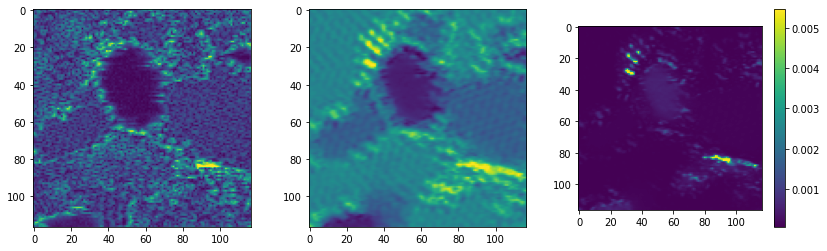

In [35]:
mean_active, var_active = dklgp_trained.predict(X, batch_size = 512)  
mean_active, var_active = mean_active.T, var_active.T

f1,f2 = img.shape[0], img.shape[1]
w1,w2 = window_size, window_size
dkl_prediction_active = mean_active.reshape(f1-w1+1, f2-w2+1)
dkl_uncertainty_active = var_active.reshape(f1-w1+1, f2-w2+1)

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(14,4))
im1 = ax1.imshow(normalize(physics_all.reshape(f1-w1+1, f2-w2+1)), vmax = 0.75)
im2 = ax2.imshow(dkl_prediction_active)
im3 = ax3.imshow(dkl_uncertainty_active)
plt.colorbar(im3, ax=ax3)

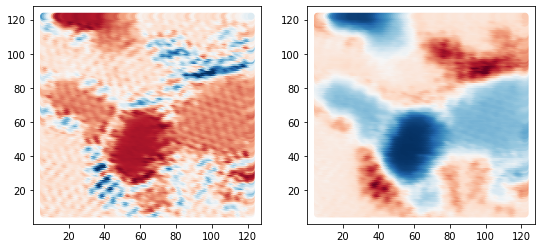

In [36]:
embeded = dklgp_trained.embed(X)
embeded = embeded / embeded.max()

_, (ax1, ax2) = plt.subplots(1,2, figsize=(9, 4))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded[:, 1], cmap='RdBu')

In [37]:
Pred_stack_mag, Unc_stack_mag = get_all_DKL_predictions_preacquired_4D(model_files, testim, num_cycles = 40, embed = 2, precision = "double")

/usr/local/lib/python3.7/dist-packages/gpytorch/distributions/multivariate_normal.py:263: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-10.
  NumericalWarning,


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:431: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:354: FutureWarning: `draw.circle` is deprecated in favor of `draw.disk`.`draw.circle` will be removed in version 0.19


[]

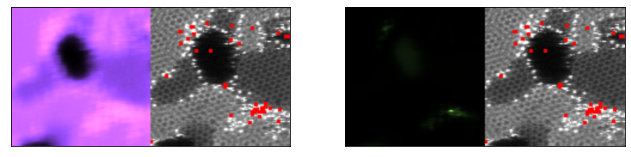

In [57]:
_,_,AF_HAADF, Pred_mov, Unc_mov = Make_pred_movies_preacquired(Pred_stack_mag, Unc_stack_mag, testim,
                                            Pred_color = [60/100,30/100,100/100], 
                                            Unc_color = [40/100,80/100,30/100], 
                                            Brightness = 2, 
                                            measured_points_in_HAADF = [1,0,0], 
                                            size_increase = 2,
                                            point_rad = 2)

kk = -5

plt.figure(figsize=(11,5))
gs = gridspec.GridSpec(1,2)
ax1, ax2  = plt.subplot(gs[0,0]), plt.subplot(gs[0,1])

# ax1.imshow(AF_HAADF[kk])
ax1.imshow(Pred_mov[kk])
ax2.imshow(Unc_mov[kk])

plt.setp([ax1,ax2],xticks=[],yticks=[])

In [50]:
imageio.mimwrite('Mov_Graphene_pred_DPC_TBG.mp4', Pred_mov, fps = 4)
Video('Mov_Graphene_pred_DPC_TBG.mp4', embed = True)

In [52]:
imageio.mimwrite('Mov_Graphene_unc_DPCTBG.mp4', Unc_mov, fps = 4)
Video('Mov_Graphene_unc_DPCTBG.mp4', embed = True)

# Movies (active learning with TBG)
* Acquisition function, prediction, and uncertainty movies for TBG data set

In [60]:
Mov_name = "TBG_01_acquisitionfunction.mp4"

imageio.mimwrite(Mov_name, Movie_combined_upscaled, fps = 4)
Video(Mov_name, embed = True)

In [ ]:
imageio.mimwrite('Mov_Graphene_pred_DPC_TBG.mp4', Pred_mov, fps = 4)
Video('Mov_Graphene_pred_DPC_TBG.mp4', embed = True)

In [ ]:
imageio.mimwrite('Mov_Graphene_unc_DPCTBG.mp4', Unc_mov, fps = 4)
Video('Mov_Graphene_unc_DPCTBG.mp4', embed = True)